# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

/Users/petinatan/anaconda3/envs/tensorflow/lib/python3.5/importlib/_bootstrap.py:222: RuntimeWarning: compiletime version 3.6 of module 'tensorflow.python.framework.fast_tensor_util' does not match runtime version 3.5
  return f(*args, **kwds)


In [2]:
!mkdir data

mkdir: data: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:13, 13.7MB/s]                              
SVHN Testing Set: 64.3MB [00:05, 12.0MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

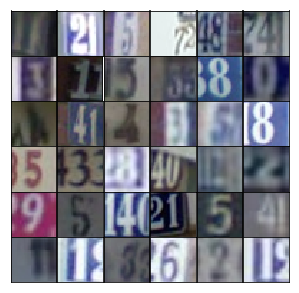

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [32]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4 * 4 * 512)
        
        #reshape to the start of convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        
        #4 * 4 * 512 now
        #layer2
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same' )
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        
        #8 * 8 * 256 now
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same' )
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        
        #16 * 16 * 128 now
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [33]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x, x)
        #16 * 16 * 64
        
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        #8 * 8 * 128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        #4 * 4 * 256
        
        flatten = tf.reshape(relu3, (-1, 4 * 4 * 256)) 
        logits = tf.layers.dense(flatten, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [34]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [35]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [36]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [37]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [38]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [47]:
real_size = (32,32,3)
z_size = 100
#learning_rate = 0.001
learning_rate = 0.0002
batch_size = 128 #mini-batch size
epochs = 25
alpha = 0.2 #slope
beta1 = 0.5 #momentum term

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.0189... Generator Loss: 1.2028
Epoch 1/25... Discriminator Loss: 0.6444... Generator Loss: 1.1795
Epoch 1/25... Discriminator Loss: 0.2043... Generator Loss: 2.3177
Epoch 1/25... Discriminator Loss: 0.1464... Generator Loss: 2.7422
Epoch 1/25... Discriminator Loss: 0.1707... Generator Loss: 2.8457
Epoch 1/25... Discriminator Loss: 0.1349... Generator Loss: 2.5900
Epoch 1/25... Discriminator Loss: 0.1966... Generator Loss: 2.3145
Epoch 1/25... Discriminator Loss: 0.1355... Generator Loss: 2.9568
Epoch 1/25... Discriminator Loss: 0.1472... Generator Loss: 2.9253
Epoch 1/25... Discriminator Loss: 0.1319... Generator Loss: 3.1054


/Users/petinatan/anaconda3/envs/tensorflow/lib/python3.5/site-packages/matplotlib/axes/_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


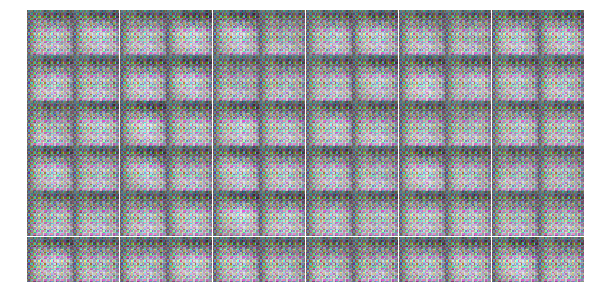

Epoch 1/25... Discriminator Loss: 0.1549... Generator Loss: 2.8799
Epoch 1/25... Discriminator Loss: 0.4974... Generator Loss: 2.0756
Epoch 1/25... Discriminator Loss: 0.9198... Generator Loss: 2.5091
Epoch 1/25... Discriminator Loss: 0.5803... Generator Loss: 1.3007
Epoch 1/25... Discriminator Loss: 0.6688... Generator Loss: 1.2815
Epoch 1/25... Discriminator Loss: 0.4925... Generator Loss: 1.8067
Epoch 1/25... Discriminator Loss: 0.4683... Generator Loss: 2.1138
Epoch 1/25... Discriminator Loss: 0.9484... Generator Loss: 0.8756
Epoch 1/25... Discriminator Loss: 0.4927... Generator Loss: 2.5056
Epoch 1/25... Discriminator Loss: 0.3564... Generator Loss: 2.9735


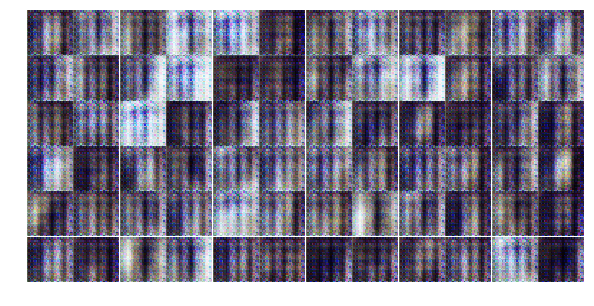

Epoch 1/25... Discriminator Loss: 0.9275... Generator Loss: 1.0493
Epoch 1/25... Discriminator Loss: 0.3026... Generator Loss: 3.0770
Epoch 1/25... Discriminator Loss: 0.6822... Generator Loss: 1.0195
Epoch 1/25... Discriminator Loss: 0.2262... Generator Loss: 2.1722
Epoch 1/25... Discriminator Loss: 0.6180... Generator Loss: 3.9880
Epoch 1/25... Discriminator Loss: 1.5781... Generator Loss: 0.5735
Epoch 1/25... Discriminator Loss: 0.8484... Generator Loss: 1.0588
Epoch 1/25... Discriminator Loss: 0.6712... Generator Loss: 1.3027
Epoch 1/25... Discriminator Loss: 0.6173... Generator Loss: 2.0748
Epoch 1/25... Discriminator Loss: 0.5589... Generator Loss: 1.3428


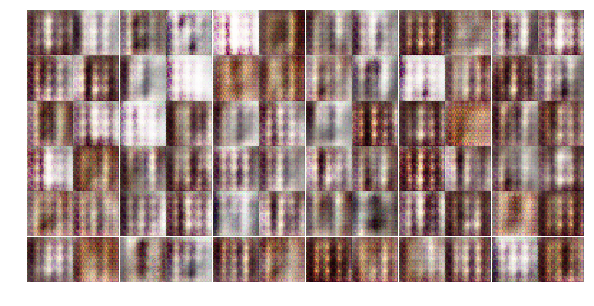

Epoch 1/25... Discriminator Loss: 0.6904... Generator Loss: 3.4084
Epoch 1/25... Discriminator Loss: 1.3704... Generator Loss: 0.5034
Epoch 1/25... Discriminator Loss: 0.6508... Generator Loss: 1.4677
Epoch 1/25... Discriminator Loss: 0.4225... Generator Loss: 2.4823
Epoch 1/25... Discriminator Loss: 0.9114... Generator Loss: 0.9564
Epoch 1/25... Discriminator Loss: 0.8238... Generator Loss: 0.8309
Epoch 1/25... Discriminator Loss: 0.7163... Generator Loss: 1.5301
Epoch 1/25... Discriminator Loss: 0.6711... Generator Loss: 1.8115
Epoch 1/25... Discriminator Loss: 0.4709... Generator Loss: 2.0741
Epoch 1/25... Discriminator Loss: 0.4783... Generator Loss: 1.5835


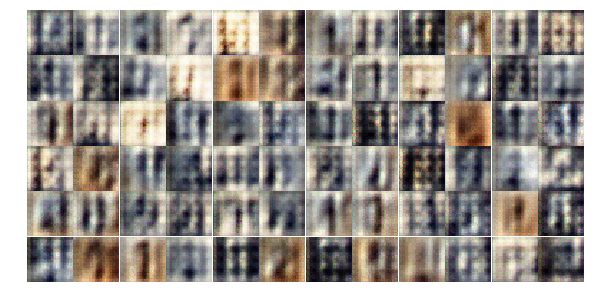

Epoch 1/25... Discriminator Loss: 0.4116... Generator Loss: 2.3871
Epoch 1/25... Discriminator Loss: 0.6547... Generator Loss: 1.2674
Epoch 1/25... Discriminator Loss: 0.8934... Generator Loss: 2.6373
Epoch 1/25... Discriminator Loss: 0.6407... Generator Loss: 2.0350
Epoch 1/25... Discriminator Loss: 0.7244... Generator Loss: 1.4868
Epoch 1/25... Discriminator Loss: 0.4088... Generator Loss: 2.0182
Epoch 1/25... Discriminator Loss: 0.9405... Generator Loss: 1.1949
Epoch 1/25... Discriminator Loss: 1.1530... Generator Loss: 1.3079
Epoch 1/25... Discriminator Loss: 0.6936... Generator Loss: 1.2530
Epoch 1/25... Discriminator Loss: 1.1698... Generator Loss: 0.8408


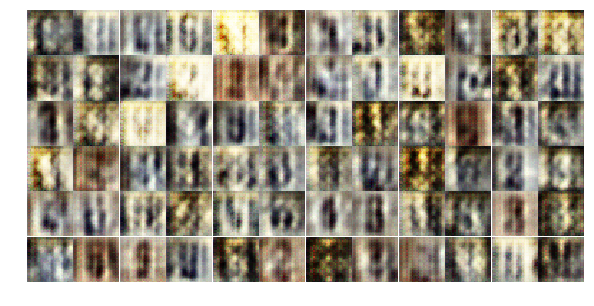

Epoch 1/25... Discriminator Loss: 1.5703... Generator Loss: 0.3623
Epoch 1/25... Discriminator Loss: 1.1485... Generator Loss: 0.9254
Epoch 1/25... Discriminator Loss: 0.7294... Generator Loss: 1.2156
Epoch 1/25... Discriminator Loss: 1.4964... Generator Loss: 0.5269
Epoch 1/25... Discriminator Loss: 1.2787... Generator Loss: 0.7953
Epoch 1/25... Discriminator Loss: 1.3633... Generator Loss: 0.7924
Epoch 1/25... Discriminator Loss: 0.9940... Generator Loss: 1.0157
Epoch 2/25... Discriminator Loss: 0.9256... Generator Loss: 1.3959
Epoch 2/25... Discriminator Loss: 0.6037... Generator Loss: 1.5676
Epoch 2/25... Discriminator Loss: 0.8932... Generator Loss: 1.1374


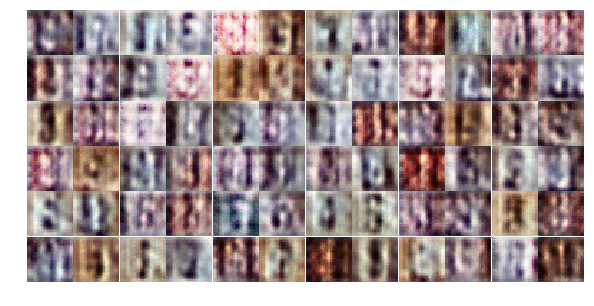

Epoch 2/25... Discriminator Loss: 0.9039... Generator Loss: 1.4438
Epoch 2/25... Discriminator Loss: 0.7429... Generator Loss: 1.2545
Epoch 2/25... Discriminator Loss: 0.6125... Generator Loss: 1.5365
Epoch 2/25... Discriminator Loss: 0.6310... Generator Loss: 1.2688
Epoch 2/25... Discriminator Loss: 0.8711... Generator Loss: 0.9673
Epoch 2/25... Discriminator Loss: 0.9174... Generator Loss: 1.2353
Epoch 2/25... Discriminator Loss: 1.0519... Generator Loss: 0.8021
Epoch 2/25... Discriminator Loss: 0.6892... Generator Loss: 1.3066
Epoch 2/25... Discriminator Loss: 0.8592... Generator Loss: 1.2237
Epoch 2/25... Discriminator Loss: 1.0875... Generator Loss: 1.1330


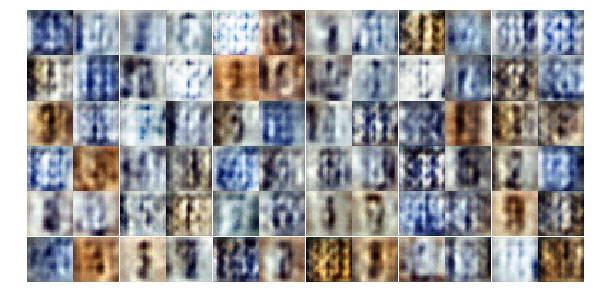

Epoch 2/25... Discriminator Loss: 1.4722... Generator Loss: 0.4103
Epoch 2/25... Discriminator Loss: 0.8107... Generator Loss: 1.3231
Epoch 2/25... Discriminator Loss: 0.7713... Generator Loss: 1.8617
Epoch 2/25... Discriminator Loss: 0.8689... Generator Loss: 1.0732
Epoch 2/25... Discriminator Loss: 1.1263... Generator Loss: 0.9462
Epoch 2/25... Discriminator Loss: 1.3453... Generator Loss: 0.7583
Epoch 2/25... Discriminator Loss: 1.0711... Generator Loss: 0.8109
Epoch 2/25... Discriminator Loss: 0.8941... Generator Loss: 0.9216
Epoch 2/25... Discriminator Loss: 1.1650... Generator Loss: 0.7655
Epoch 2/25... Discriminator Loss: 1.2155... Generator Loss: 0.8195


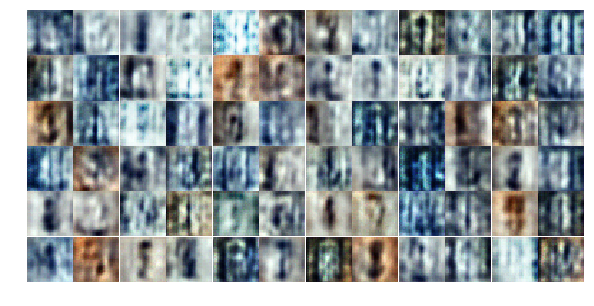

Epoch 2/25... Discriminator Loss: 1.0139... Generator Loss: 1.0582
Epoch 2/25... Discriminator Loss: 1.2387... Generator Loss: 0.8551
Epoch 2/25... Discriminator Loss: 0.7449... Generator Loss: 1.1709
Epoch 2/25... Discriminator Loss: 1.1037... Generator Loss: 1.1303
Epoch 2/25... Discriminator Loss: 1.1616... Generator Loss: 1.0251
Epoch 2/25... Discriminator Loss: 0.8670... Generator Loss: 1.2107
Epoch 2/25... Discriminator Loss: 1.2776... Generator Loss: 0.5703
Epoch 2/25... Discriminator Loss: 0.9227... Generator Loss: 0.9283
Epoch 2/25... Discriminator Loss: 1.2197... Generator Loss: 0.7203
Epoch 2/25... Discriminator Loss: 1.2912... Generator Loss: 1.1067


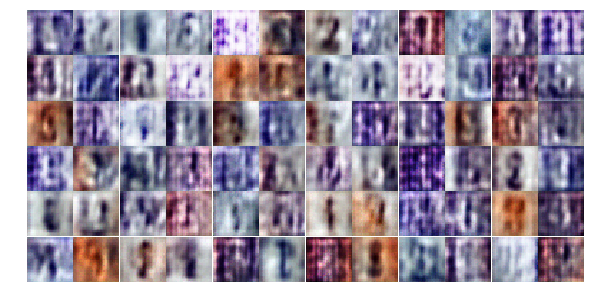

Epoch 2/25... Discriminator Loss: 1.2630... Generator Loss: 0.6449
Epoch 2/25... Discriminator Loss: 1.0858... Generator Loss: 0.7745
Epoch 2/25... Discriminator Loss: 1.1784... Generator Loss: 1.1647
Epoch 2/25... Discriminator Loss: 1.3152... Generator Loss: 0.8251
Epoch 2/25... Discriminator Loss: 0.9642... Generator Loss: 1.1011
Epoch 2/25... Discriminator Loss: 1.1473... Generator Loss: 1.0185
Epoch 2/25... Discriminator Loss: 1.1758... Generator Loss: 0.8490
Epoch 2/25... Discriminator Loss: 1.1448... Generator Loss: 1.1901
Epoch 2/25... Discriminator Loss: 0.9349... Generator Loss: 1.1177
Epoch 2/25... Discriminator Loss: 1.2873... Generator Loss: 0.7529


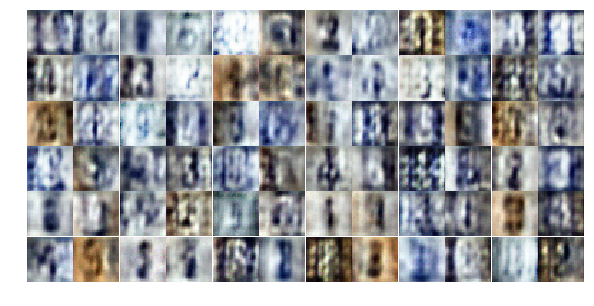

Epoch 2/25... Discriminator Loss: 0.8813... Generator Loss: 1.0525
Epoch 2/25... Discriminator Loss: 1.3129... Generator Loss: 1.0635
Epoch 2/25... Discriminator Loss: 0.9999... Generator Loss: 1.1097
Epoch 2/25... Discriminator Loss: 1.2840... Generator Loss: 0.7430
Epoch 2/25... Discriminator Loss: 1.3229... Generator Loss: 1.1852
Epoch 2/25... Discriminator Loss: 1.1108... Generator Loss: 0.7300
Epoch 2/25... Discriminator Loss: 0.8960... Generator Loss: 1.1446
Epoch 2/25... Discriminator Loss: 1.0269... Generator Loss: 0.9745
Epoch 2/25... Discriminator Loss: 0.9994... Generator Loss: 0.9825
Epoch 2/25... Discriminator Loss: 1.1357... Generator Loss: 1.1046


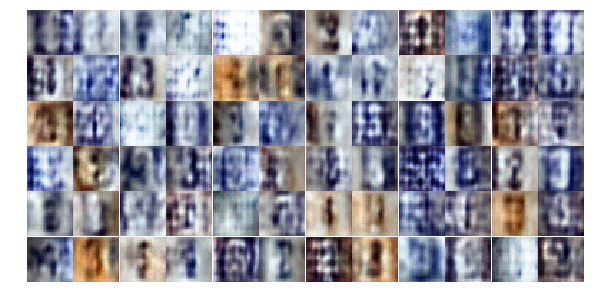

Epoch 2/25... Discriminator Loss: 1.0287... Generator Loss: 1.3992
Epoch 2/25... Discriminator Loss: 0.9987... Generator Loss: 0.8965
Epoch 2/25... Discriminator Loss: 1.0934... Generator Loss: 0.7167
Epoch 2/25... Discriminator Loss: 1.0219... Generator Loss: 1.0123
Epoch 3/25... Discriminator Loss: 0.7748... Generator Loss: 1.5825
Epoch 3/25... Discriminator Loss: 1.0693... Generator Loss: 0.7868
Epoch 3/25... Discriminator Loss: 0.8076... Generator Loss: 1.2244
Epoch 3/25... Discriminator Loss: 0.8830... Generator Loss: 0.8627
Epoch 3/25... Discriminator Loss: 0.9028... Generator Loss: 1.0838
Epoch 3/25... Discriminator Loss: 0.9305... Generator Loss: 1.6252


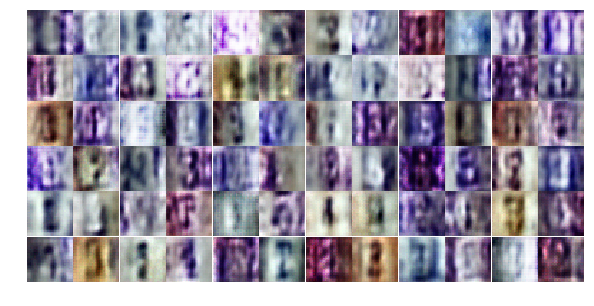

Epoch 3/25... Discriminator Loss: 0.8122... Generator Loss: 0.9137
Epoch 3/25... Discriminator Loss: 0.8372... Generator Loss: 1.0432
Epoch 3/25... Discriminator Loss: 0.7615... Generator Loss: 1.2498
Epoch 3/25... Discriminator Loss: 0.7135... Generator Loss: 1.4082
Epoch 3/25... Discriminator Loss: 0.6165... Generator Loss: 1.1596
Epoch 3/25... Discriminator Loss: 0.9639... Generator Loss: 0.8561
Epoch 3/25... Discriminator Loss: 0.8188... Generator Loss: 1.4833
Epoch 3/25... Discriminator Loss: 0.7035... Generator Loss: 1.4387
Epoch 3/25... Discriminator Loss: 0.9122... Generator Loss: 0.9999
Epoch 3/25... Discriminator Loss: 0.8905... Generator Loss: 1.0079


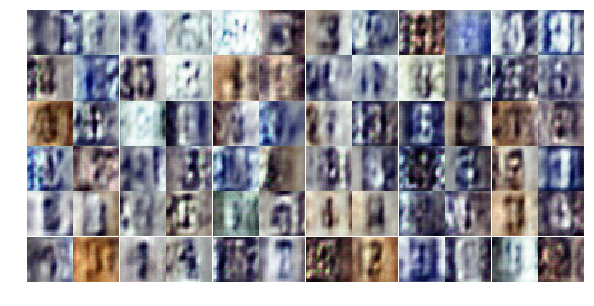

Epoch 3/25... Discriminator Loss: 0.6813... Generator Loss: 1.6176
Epoch 3/25... Discriminator Loss: 0.9283... Generator Loss: 0.7227
Epoch 3/25... Discriminator Loss: 0.6475... Generator Loss: 1.0780
Epoch 3/25... Discriminator Loss: 0.5835... Generator Loss: 1.6528
Epoch 3/25... Discriminator Loss: 0.4920... Generator Loss: 2.0390
Epoch 3/25... Discriminator Loss: 0.4527... Generator Loss: 2.5112
Epoch 3/25... Discriminator Loss: 3.0021... Generator Loss: 5.0117
Epoch 3/25... Discriminator Loss: 0.8180... Generator Loss: 1.0279
Epoch 3/25... Discriminator Loss: 0.4834... Generator Loss: 1.6941
Epoch 3/25... Discriminator Loss: 0.5803... Generator Loss: 1.3258


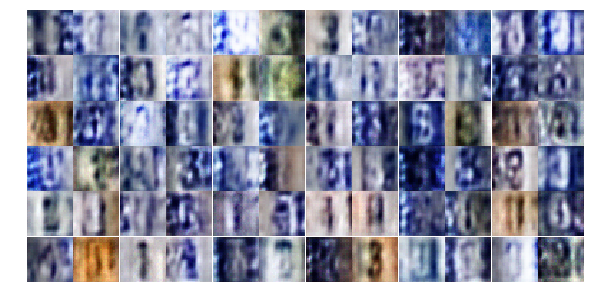

Epoch 3/25... Discriminator Loss: 1.3620... Generator Loss: 3.1762
Epoch 3/25... Discriminator Loss: 0.9629... Generator Loss: 0.8108
Epoch 3/25... Discriminator Loss: 0.7151... Generator Loss: 1.1322
Epoch 3/25... Discriminator Loss: 0.3881... Generator Loss: 1.7101
Epoch 3/25... Discriminator Loss: 0.5477... Generator Loss: 1.7371
Epoch 3/25... Discriminator Loss: 0.9355... Generator Loss: 1.1810
Epoch 3/25... Discriminator Loss: 0.6688... Generator Loss: 1.2051
Epoch 3/25... Discriminator Loss: 0.4234... Generator Loss: 2.2608
Epoch 3/25... Discriminator Loss: 0.5691... Generator Loss: 1.3434
Epoch 3/25... Discriminator Loss: 0.4237... Generator Loss: 1.4136


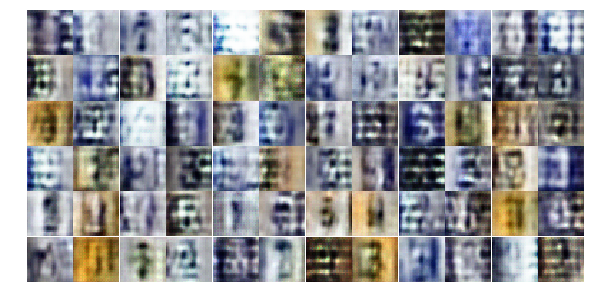

Epoch 3/25... Discriminator Loss: 0.8604... Generator Loss: 1.9250
Epoch 3/25... Discriminator Loss: 0.4582... Generator Loss: 1.7624
Epoch 3/25... Discriminator Loss: 0.5947... Generator Loss: 1.6322
Epoch 3/25... Discriminator Loss: 0.6981... Generator Loss: 1.7291
Epoch 3/25... Discriminator Loss: 0.6958... Generator Loss: 1.9517
Epoch 3/25... Discriminator Loss: 0.7025... Generator Loss: 1.0705
Epoch 3/25... Discriminator Loss: 0.5536... Generator Loss: 1.5904
Epoch 3/25... Discriminator Loss: 0.3677... Generator Loss: 2.0970
Epoch 3/25... Discriminator Loss: 0.5999... Generator Loss: 2.2178
Epoch 3/25... Discriminator Loss: 0.5912... Generator Loss: 1.6300


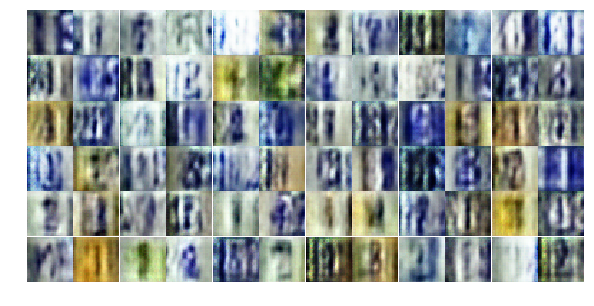

Epoch 3/25... Discriminator Loss: 0.8450... Generator Loss: 3.1422
Epoch 3/25... Discriminator Loss: 0.6090... Generator Loss: 1.3648
Epoch 3/25... Discriminator Loss: 0.7038... Generator Loss: 1.3167
Epoch 3/25... Discriminator Loss: 0.5469... Generator Loss: 1.4445
Epoch 3/25... Discriminator Loss: 1.4265... Generator Loss: 3.9406
Epoch 3/25... Discriminator Loss: 0.3974... Generator Loss: 2.4430
Epoch 3/25... Discriminator Loss: 0.7112... Generator Loss: 1.3123
Epoch 3/25... Discriminator Loss: 0.6058... Generator Loss: 1.4151
Epoch 3/25... Discriminator Loss: 0.7050... Generator Loss: 1.5176
Epoch 3/25... Discriminator Loss: 0.4729... Generator Loss: 2.0246


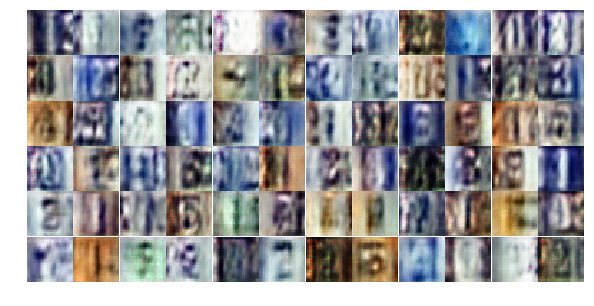

Epoch 3/25... Discriminator Loss: 0.9769... Generator Loss: 0.6948
Epoch 4/25... Discriminator Loss: 0.5892... Generator Loss: 1.5440
Epoch 4/25... Discriminator Loss: 0.6566... Generator Loss: 1.4839
Epoch 4/25... Discriminator Loss: 0.7825... Generator Loss: 0.9134
Epoch 4/25... Discriminator Loss: 0.4268... Generator Loss: 1.8549
Epoch 4/25... Discriminator Loss: 0.5547... Generator Loss: 1.5424
Epoch 4/25... Discriminator Loss: 0.5239... Generator Loss: 1.3943
Epoch 4/25... Discriminator Loss: 0.7550... Generator Loss: 1.0024
Epoch 4/25... Discriminator Loss: 0.5993... Generator Loss: 1.3211
Epoch 4/25... Discriminator Loss: 0.4392... Generator Loss: 1.6548


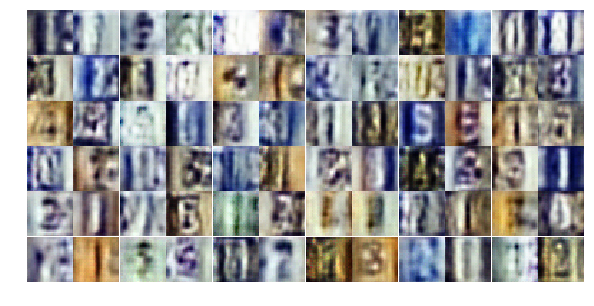

Epoch 4/25... Discriminator Loss: 0.4948... Generator Loss: 1.4589
Epoch 4/25... Discriminator Loss: 1.0183... Generator Loss: 1.5275
Epoch 4/25... Discriminator Loss: 0.8924... Generator Loss: 1.0010
Epoch 4/25... Discriminator Loss: 0.6203... Generator Loss: 1.7795
Epoch 4/25... Discriminator Loss: 0.6342... Generator Loss: 1.0919
Epoch 4/25... Discriminator Loss: 1.8363... Generator Loss: 0.2239
Epoch 4/25... Discriminator Loss: 0.8842... Generator Loss: 0.7667
Epoch 4/25... Discriminator Loss: 0.5278... Generator Loss: 1.4994
Epoch 4/25... Discriminator Loss: 0.8265... Generator Loss: 1.5580
Epoch 4/25... Discriminator Loss: 0.5538... Generator Loss: 2.2576


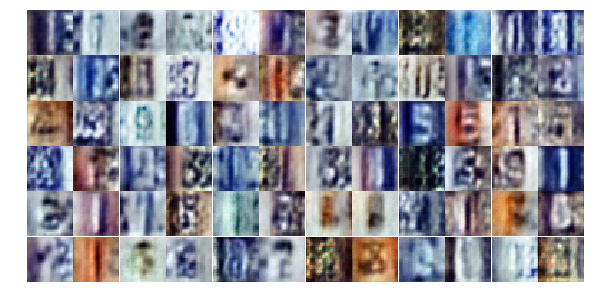

Epoch 4/25... Discriminator Loss: 0.5358... Generator Loss: 1.6079
Epoch 4/25... Discriminator Loss: 0.5127... Generator Loss: 1.6594
Epoch 4/25... Discriminator Loss: 0.5894... Generator Loss: 1.1026
Epoch 4/25... Discriminator Loss: 0.6324... Generator Loss: 1.1255
Epoch 4/25... Discriminator Loss: 0.2877... Generator Loss: 2.0604
Epoch 4/25... Discriminator Loss: 0.3362... Generator Loss: 2.1915
Epoch 4/25... Discriminator Loss: 0.3662... Generator Loss: 2.7936
Epoch 4/25... Discriminator Loss: 0.7123... Generator Loss: 2.6501
Epoch 4/25... Discriminator Loss: 0.3048... Generator Loss: 1.8986
Epoch 4/25... Discriminator Loss: 0.8975... Generator Loss: 3.0445


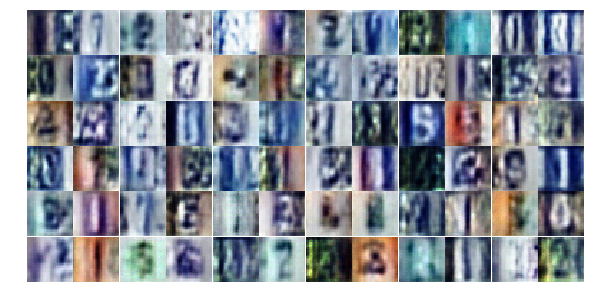

Epoch 4/25... Discriminator Loss: 0.3954... Generator Loss: 1.5928
Epoch 4/25... Discriminator Loss: 0.6948... Generator Loss: 0.9924
Epoch 4/25... Discriminator Loss: 0.4936... Generator Loss: 1.4056
Epoch 4/25... Discriminator Loss: 0.5092... Generator Loss: 2.1842
Epoch 4/25... Discriminator Loss: 0.3695... Generator Loss: 2.5730
Epoch 4/25... Discriminator Loss: 0.4169... Generator Loss: 1.5666
Epoch 4/25... Discriminator Loss: 0.6199... Generator Loss: 2.4957
Epoch 4/25... Discriminator Loss: 0.4514... Generator Loss: 1.4547
Epoch 4/25... Discriminator Loss: 0.3055... Generator Loss: 1.9690
Epoch 4/25... Discriminator Loss: 0.7210... Generator Loss: 1.1299


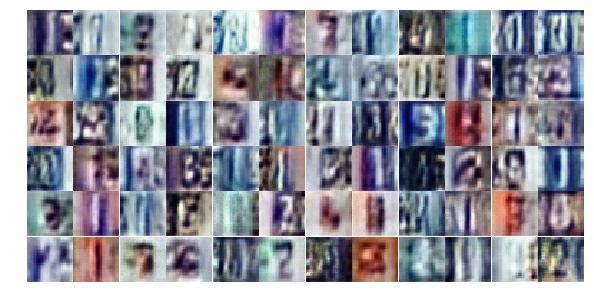

Epoch 4/25... Discriminator Loss: 0.4865... Generator Loss: 2.0053
Epoch 4/25... Discriminator Loss: 0.4031... Generator Loss: 1.5376
Epoch 4/25... Discriminator Loss: 0.8011... Generator Loss: 0.9650
Epoch 4/25... Discriminator Loss: 0.5067... Generator Loss: 1.3497
Epoch 4/25... Discriminator Loss: 0.4890... Generator Loss: 1.2751
Epoch 4/25... Discriminator Loss: 0.4572... Generator Loss: 1.4127
Epoch 4/25... Discriminator Loss: 0.6534... Generator Loss: 1.0937
Epoch 4/25... Discriminator Loss: 1.5703... Generator Loss: 3.3063
Epoch 4/25... Discriminator Loss: 0.6138... Generator Loss: 1.7138
Epoch 4/25... Discriminator Loss: 0.5339... Generator Loss: 2.0381


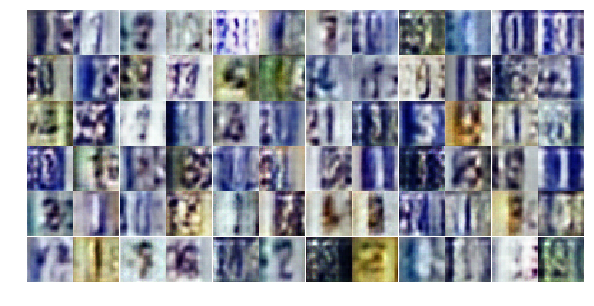

Epoch 4/25... Discriminator Loss: 0.4873... Generator Loss: 1.6156
Epoch 4/25... Discriminator Loss: 0.3500... Generator Loss: 2.9845
Epoch 4/25... Discriminator Loss: 0.3390... Generator Loss: 1.8175
Epoch 4/25... Discriminator Loss: 0.8844... Generator Loss: 2.3016
Epoch 4/25... Discriminator Loss: 0.9990... Generator Loss: 0.8490
Epoch 4/25... Discriminator Loss: 0.5596... Generator Loss: 1.2340
Epoch 4/25... Discriminator Loss: 0.3885... Generator Loss: 1.6457
Epoch 4/25... Discriminator Loss: 0.5053... Generator Loss: 1.4296
Epoch 4/25... Discriminator Loss: 0.3477... Generator Loss: 2.3962
Epoch 5/25... Discriminator Loss: 0.4172... Generator Loss: 2.1647


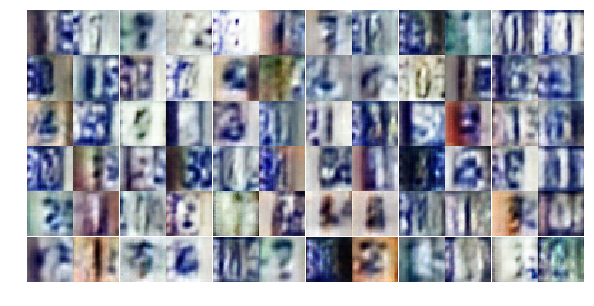

Epoch 5/25... Discriminator Loss: 0.4439... Generator Loss: 1.5917
Epoch 5/25... Discriminator Loss: 0.3863... Generator Loss: 1.6806
Epoch 5/25... Discriminator Loss: 0.6805... Generator Loss: 0.9770
Epoch 5/25... Discriminator Loss: 1.0093... Generator Loss: 0.6076
Epoch 5/25... Discriminator Loss: 0.5228... Generator Loss: 2.0360
Epoch 5/25... Discriminator Loss: 0.8859... Generator Loss: 0.7382
Epoch 5/25... Discriminator Loss: 0.8537... Generator Loss: 0.7455
Epoch 5/25... Discriminator Loss: 0.4886... Generator Loss: 1.3277
Epoch 5/25... Discriminator Loss: 1.0047... Generator Loss: 0.6205
Epoch 5/25... Discriminator Loss: 1.1323... Generator Loss: 0.5701


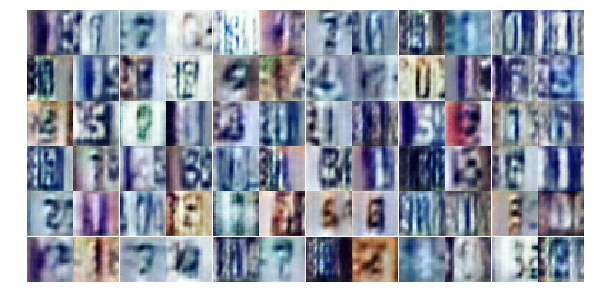

Epoch 5/25... Discriminator Loss: 0.4682... Generator Loss: 1.6579
Epoch 5/25... Discriminator Loss: 0.4384... Generator Loss: 2.1515
Epoch 5/25... Discriminator Loss: 0.8966... Generator Loss: 2.1531
Epoch 5/25... Discriminator Loss: 2.1252... Generator Loss: 0.1897
Epoch 5/25... Discriminator Loss: 0.6999... Generator Loss: 2.5918
Epoch 5/25... Discriminator Loss: 0.7722... Generator Loss: 0.9428
Epoch 5/25... Discriminator Loss: 0.4377... Generator Loss: 2.4703
Epoch 5/25... Discriminator Loss: 0.4031... Generator Loss: 1.9327
Epoch 5/25... Discriminator Loss: 0.3303... Generator Loss: 1.8608
Epoch 5/25... Discriminator Loss: 0.5794... Generator Loss: 1.2042


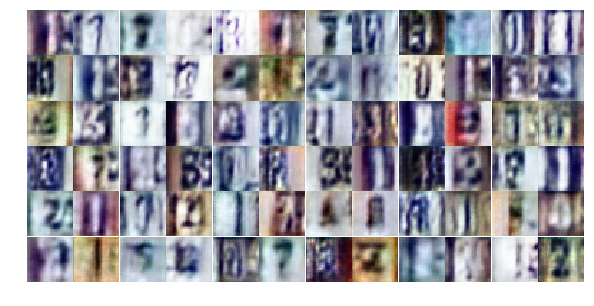

Epoch 5/25... Discriminator Loss: 0.4367... Generator Loss: 1.4206
Epoch 5/25... Discriminator Loss: 1.0014... Generator Loss: 0.6976
Epoch 5/25... Discriminator Loss: 0.5223... Generator Loss: 1.4652
Epoch 5/25... Discriminator Loss: 0.7995... Generator Loss: 0.7932
Epoch 5/25... Discriminator Loss: 1.4021... Generator Loss: 0.3723
Epoch 5/25... Discriminator Loss: 0.5823... Generator Loss: 1.2652
Epoch 5/25... Discriminator Loss: 0.8029... Generator Loss: 0.8106
Epoch 5/25... Discriminator Loss: 0.5757... Generator Loss: 1.1397
Epoch 5/25... Discriminator Loss: 1.5158... Generator Loss: 0.3642
Epoch 5/25... Discriminator Loss: 0.7552... Generator Loss: 1.9256


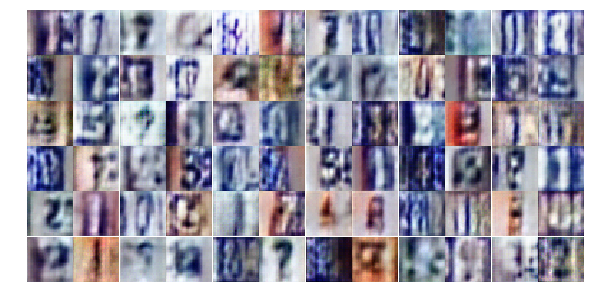

Epoch 5/25... Discriminator Loss: 0.5217... Generator Loss: 1.4997
Epoch 5/25... Discriminator Loss: 0.4887... Generator Loss: 1.6129
Epoch 5/25... Discriminator Loss: 0.4884... Generator Loss: 1.5561
Epoch 5/25... Discriminator Loss: 0.4358... Generator Loss: 1.5578
Epoch 5/25... Discriminator Loss: 0.5004... Generator Loss: 1.8060
Epoch 5/25... Discriminator Loss: 0.5064... Generator Loss: 1.3394
Epoch 5/25... Discriminator Loss: 0.6659... Generator Loss: 0.9965
Epoch 5/25... Discriminator Loss: 0.7348... Generator Loss: 0.9180
Epoch 5/25... Discriminator Loss: 0.6267... Generator Loss: 1.0470
Epoch 5/25... Discriminator Loss: 0.5070... Generator Loss: 1.7638


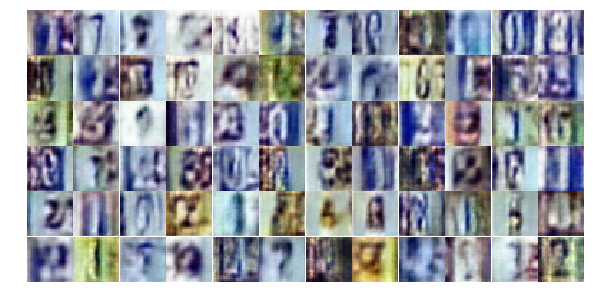

Epoch 5/25... Discriminator Loss: 0.2593... Generator Loss: 1.9939
Epoch 5/25... Discriminator Loss: 1.4458... Generator Loss: 0.3599
Epoch 5/25... Discriminator Loss: 1.5153... Generator Loss: 0.4516
Epoch 5/25... Discriminator Loss: 0.8485... Generator Loss: 0.9292
Epoch 5/25... Discriminator Loss: 0.7025... Generator Loss: 1.1009
Epoch 5/25... Discriminator Loss: 1.4757... Generator Loss: 0.3433
Epoch 5/25... Discriminator Loss: 0.7397... Generator Loss: 1.6193
Epoch 5/25... Discriminator Loss: 0.5388... Generator Loss: 1.2388
Epoch 5/25... Discriminator Loss: 0.5401... Generator Loss: 1.3084
Epoch 5/25... Discriminator Loss: 0.4880... Generator Loss: 1.3758


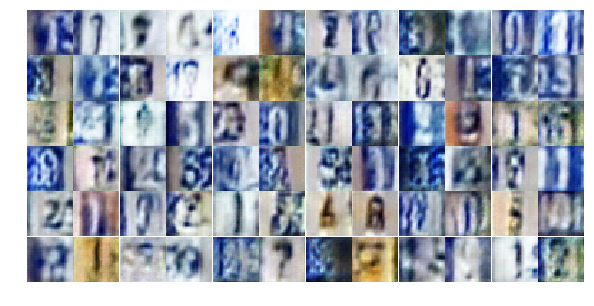

Epoch 5/25... Discriminator Loss: 0.7728... Generator Loss: 1.3466
Epoch 5/25... Discriminator Loss: 0.9900... Generator Loss: 0.6398
Epoch 5/25... Discriminator Loss: 0.5972... Generator Loss: 1.3984
Epoch 5/25... Discriminator Loss: 0.7889... Generator Loss: 0.7924
Epoch 5/25... Discriminator Loss: 0.5432... Generator Loss: 1.2208
Epoch 5/25... Discriminator Loss: 0.7930... Generator Loss: 0.8412
Epoch 6/25... Discriminator Loss: 1.0744... Generator Loss: 0.5426
Epoch 6/25... Discriminator Loss: 0.5766... Generator Loss: 1.2076
Epoch 6/25... Discriminator Loss: 0.5365... Generator Loss: 1.4541
Epoch 6/25... Discriminator Loss: 1.0207... Generator Loss: 0.6617


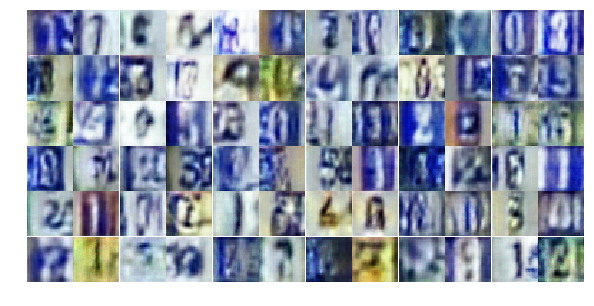

Epoch 6/25... Discriminator Loss: 0.9971... Generator Loss: 0.6804
Epoch 6/25... Discriminator Loss: 0.7906... Generator Loss: 2.4743
Epoch 6/25... Discriminator Loss: 0.6011... Generator Loss: 1.2783
Epoch 6/25... Discriminator Loss: 0.8078... Generator Loss: 0.9815
Epoch 6/25... Discriminator Loss: 0.7830... Generator Loss: 0.8811
Epoch 6/25... Discriminator Loss: 0.5968... Generator Loss: 1.0443
Epoch 6/25... Discriminator Loss: 0.5443... Generator Loss: 2.5417
Epoch 6/25... Discriminator Loss: 0.6861... Generator Loss: 1.2286
Epoch 6/25... Discriminator Loss: 0.5257... Generator Loss: 1.3216
Epoch 6/25... Discriminator Loss: 0.5753... Generator Loss: 1.3198


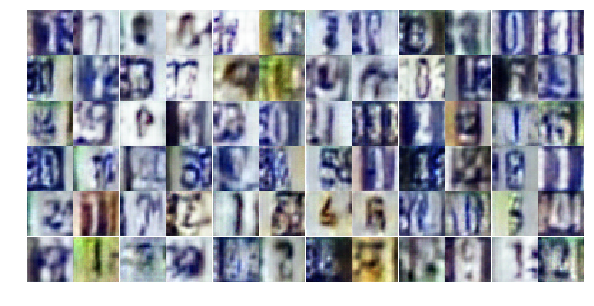

Epoch 6/25... Discriminator Loss: 1.7976... Generator Loss: 0.2735
Epoch 6/25... Discriminator Loss: 0.8998... Generator Loss: 0.8086
Epoch 6/25... Discriminator Loss: 0.6327... Generator Loss: 1.2314
Epoch 6/25... Discriminator Loss: 0.3573... Generator Loss: 1.7719
Epoch 6/25... Discriminator Loss: 0.7852... Generator Loss: 1.0217
Epoch 6/25... Discriminator Loss: 0.5995... Generator Loss: 2.0035
Epoch 6/25... Discriminator Loss: 0.7013... Generator Loss: 1.2344
Epoch 6/25... Discriminator Loss: 0.9508... Generator Loss: 0.6577
Epoch 6/25... Discriminator Loss: 0.7023... Generator Loss: 2.2419
Epoch 6/25... Discriminator Loss: 0.5878... Generator Loss: 1.6696


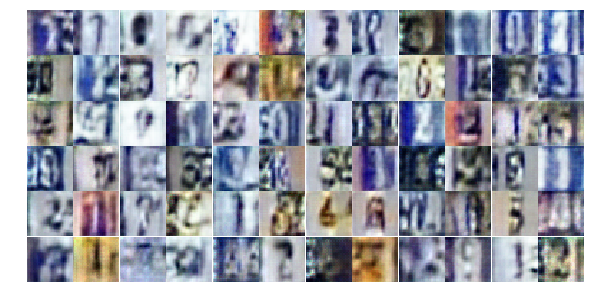

Epoch 6/25... Discriminator Loss: 1.4838... Generator Loss: 0.3763
Epoch 6/25... Discriminator Loss: 0.5695... Generator Loss: 1.6215
Epoch 6/25... Discriminator Loss: 0.6567... Generator Loss: 1.0372
Epoch 6/25... Discriminator Loss: 0.4958... Generator Loss: 1.8443
Epoch 6/25... Discriminator Loss: 0.6191... Generator Loss: 2.1575
Epoch 6/25... Discriminator Loss: 1.6570... Generator Loss: 0.3192
Epoch 6/25... Discriminator Loss: 0.7156... Generator Loss: 0.9547
Epoch 6/25... Discriminator Loss: 0.2708... Generator Loss: 1.9777
Epoch 6/25... Discriminator Loss: 0.5438... Generator Loss: 1.3092
Epoch 6/25... Discriminator Loss: 0.3932... Generator Loss: 1.8007


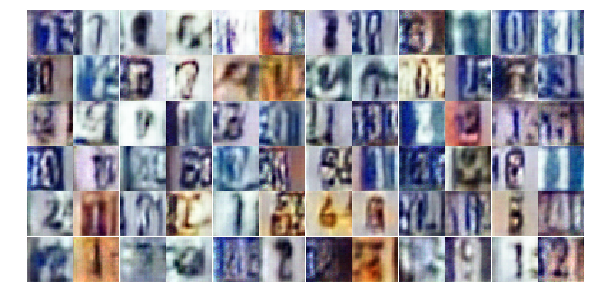

Epoch 6/25... Discriminator Loss: 0.9689... Generator Loss: 0.6840
Epoch 6/25... Discriminator Loss: 0.6726... Generator Loss: 1.2005
Epoch 6/25... Discriminator Loss: 1.5716... Generator Loss: 0.3478
Epoch 6/25... Discriminator Loss: 0.6701... Generator Loss: 1.0004
Epoch 6/25... Discriminator Loss: 0.8866... Generator Loss: 0.7619
Epoch 6/25... Discriminator Loss: 0.4346... Generator Loss: 1.6512
Epoch 6/25... Discriminator Loss: 0.4090... Generator Loss: 1.8321
Epoch 6/25... Discriminator Loss: 0.3411... Generator Loss: 1.9227
Epoch 6/25... Discriminator Loss: 0.5466... Generator Loss: 1.5806
Epoch 6/25... Discriminator Loss: 0.2946... Generator Loss: 2.1192


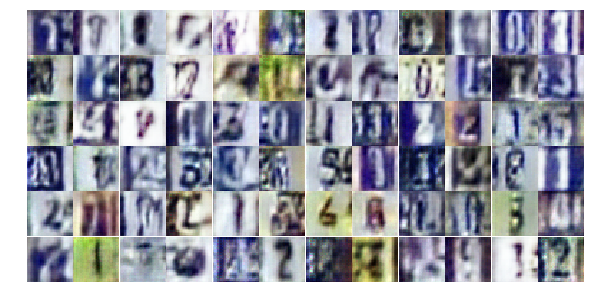

Epoch 6/25... Discriminator Loss: 0.6481... Generator Loss: 1.1726
Epoch 6/25... Discriminator Loss: 1.8611... Generator Loss: 0.2649
Epoch 6/25... Discriminator Loss: 0.8447... Generator Loss: 0.8363
Epoch 6/25... Discriminator Loss: 0.8376... Generator Loss: 0.9111
Epoch 6/25... Discriminator Loss: 0.6861... Generator Loss: 1.2976
Epoch 6/25... Discriminator Loss: 0.6348... Generator Loss: 1.3624
Epoch 6/25... Discriminator Loss: 0.5630... Generator Loss: 1.5465
Epoch 6/25... Discriminator Loss: 1.1851... Generator Loss: 0.4769
Epoch 6/25... Discriminator Loss: 0.5803... Generator Loss: 1.1941
Epoch 6/25... Discriminator Loss: 1.4954... Generator Loss: 0.3850


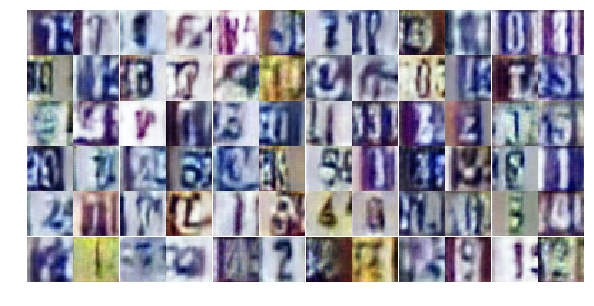

Epoch 6/25... Discriminator Loss: 0.5385... Generator Loss: 1.7478
Epoch 6/25... Discriminator Loss: 1.0330... Generator Loss: 0.5754
Epoch 6/25... Discriminator Loss: 0.6506... Generator Loss: 1.0780
Epoch 7/25... Discriminator Loss: 0.7303... Generator Loss: 1.0305
Epoch 7/25... Discriminator Loss: 0.4749... Generator Loss: 1.3574
Epoch 7/25... Discriminator Loss: 0.5009... Generator Loss: 2.5004
Epoch 7/25... Discriminator Loss: 0.7223... Generator Loss: 0.9841
Epoch 7/25... Discriminator Loss: 0.5431... Generator Loss: 1.4593
Epoch 7/25... Discriminator Loss: 0.6620... Generator Loss: 2.7295
Epoch 7/25... Discriminator Loss: 1.0581... Generator Loss: 0.7721


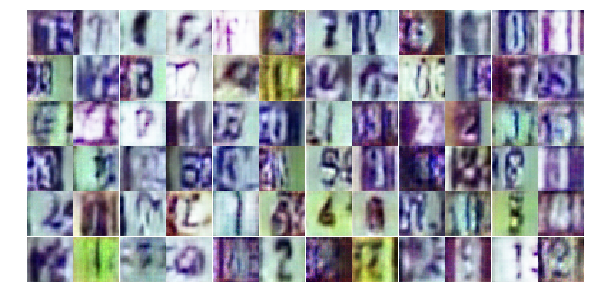

Epoch 7/25... Discriminator Loss: 0.5440... Generator Loss: 1.5064
Epoch 7/25... Discriminator Loss: 0.9421... Generator Loss: 2.1887
Epoch 7/25... Discriminator Loss: 1.0414... Generator Loss: 0.6547
Epoch 7/25... Discriminator Loss: 0.6842... Generator Loss: 1.3060
Epoch 7/25... Discriminator Loss: 0.5279... Generator Loss: 1.5622
Epoch 7/25... Discriminator Loss: 0.7576... Generator Loss: 0.8448
Epoch 7/25... Discriminator Loss: 0.9132... Generator Loss: 1.9022
Epoch 7/25... Discriminator Loss: 1.0463... Generator Loss: 2.6294
Epoch 7/25... Discriminator Loss: 0.6389... Generator Loss: 1.2451
Epoch 7/25... Discriminator Loss: 0.7940... Generator Loss: 0.8914


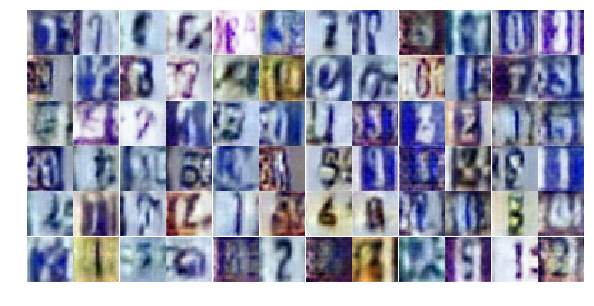

Epoch 7/25... Discriminator Loss: 1.0777... Generator Loss: 0.5979
Epoch 7/25... Discriminator Loss: 0.5225... Generator Loss: 1.4099
Epoch 7/25... Discriminator Loss: 0.6789... Generator Loss: 1.0366
Epoch 7/25... Discriminator Loss: 0.6370... Generator Loss: 1.3837
Epoch 7/25... Discriminator Loss: 0.6050... Generator Loss: 1.1901
Epoch 7/25... Discriminator Loss: 0.5015... Generator Loss: 1.3169
Epoch 7/25... Discriminator Loss: 0.4328... Generator Loss: 1.5319
Epoch 7/25... Discriminator Loss: 1.1281... Generator Loss: 0.5548
Epoch 7/25... Discriminator Loss: 0.2995... Generator Loss: 2.0068
Epoch 7/25... Discriminator Loss: 0.6028... Generator Loss: 2.7110


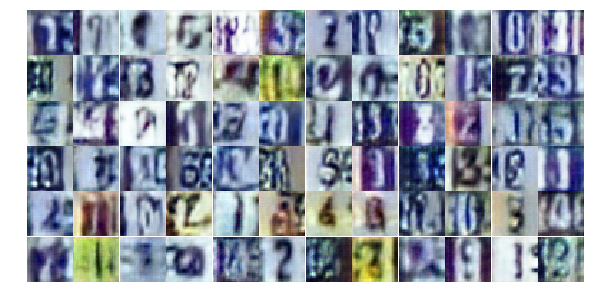

Epoch 7/25... Discriminator Loss: 0.7812... Generator Loss: 0.8714
Epoch 7/25... Discriminator Loss: 0.7880... Generator Loss: 1.0943
Epoch 7/25... Discriminator Loss: 0.5526... Generator Loss: 1.1936
Epoch 7/25... Discriminator Loss: 0.5511... Generator Loss: 1.4419
Epoch 7/25... Discriminator Loss: 0.9574... Generator Loss: 0.6569
Epoch 7/25... Discriminator Loss: 0.9673... Generator Loss: 0.6532
Epoch 7/25... Discriminator Loss: 0.4502... Generator Loss: 1.4981
Epoch 7/25... Discriminator Loss: 0.5847... Generator Loss: 1.2038
Epoch 7/25... Discriminator Loss: 0.6370... Generator Loss: 1.1460
Epoch 7/25... Discriminator Loss: 0.4735... Generator Loss: 2.2576


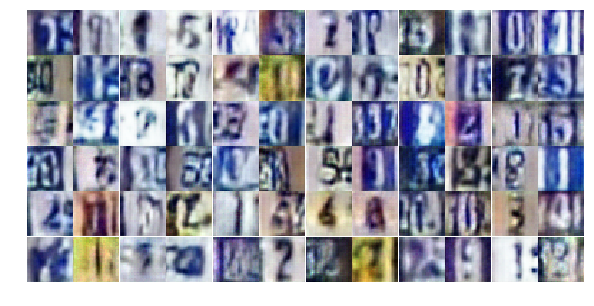

Epoch 7/25... Discriminator Loss: 1.3008... Generator Loss: 2.2495
Epoch 7/25... Discriminator Loss: 0.6251... Generator Loss: 1.6717
Epoch 7/25... Discriminator Loss: 0.4568... Generator Loss: 1.8402
Epoch 7/25... Discriminator Loss: 0.5791... Generator Loss: 1.3278
Epoch 7/25... Discriminator Loss: 0.9551... Generator Loss: 0.7010
Epoch 7/25... Discriminator Loss: 0.3006... Generator Loss: 2.0066
Epoch 7/25... Discriminator Loss: 0.3597... Generator Loss: 1.8034
Epoch 7/25... Discriminator Loss: 1.4360... Generator Loss: 2.7737
Epoch 7/25... Discriminator Loss: 0.5313... Generator Loss: 3.9385
Epoch 7/25... Discriminator Loss: 0.7625... Generator Loss: 1.0543


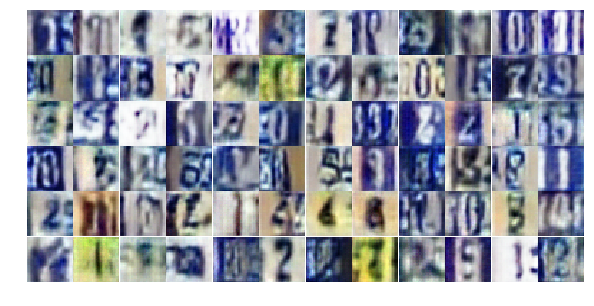

Epoch 7/25... Discriminator Loss: 0.4677... Generator Loss: 2.2341
Epoch 7/25... Discriminator Loss: 0.4577... Generator Loss: 1.4162
Epoch 7/25... Discriminator Loss: 0.8914... Generator Loss: 0.7987
Epoch 7/25... Discriminator Loss: 0.4804... Generator Loss: 1.8418
Epoch 7/25... Discriminator Loss: 0.7920... Generator Loss: 0.8291
Epoch 7/25... Discriminator Loss: 0.9279... Generator Loss: 0.7126
Epoch 7/25... Discriminator Loss: 1.1909... Generator Loss: 0.4834
Epoch 7/25... Discriminator Loss: 0.8818... Generator Loss: 0.8096
Epoch 7/25... Discriminator Loss: 1.2256... Generator Loss: 2.6781
Epoch 7/25... Discriminator Loss: 0.5351... Generator Loss: 1.3258


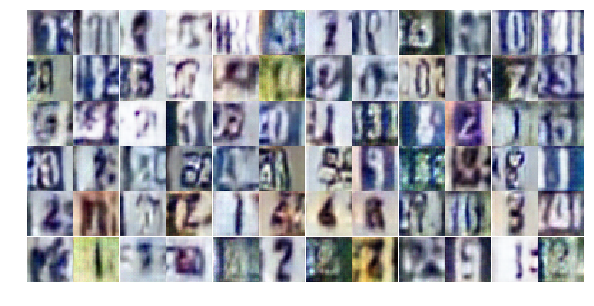

Epoch 7/25... Discriminator Loss: 0.5737... Generator Loss: 1.9234
Epoch 8/25... Discriminator Loss: 0.8226... Generator Loss: 0.8405
Epoch 8/25... Discriminator Loss: 0.5404... Generator Loss: 1.3398
Epoch 8/25... Discriminator Loss: 0.6440... Generator Loss: 1.1034
Epoch 8/25... Discriminator Loss: 0.5082... Generator Loss: 1.6475
Epoch 8/25... Discriminator Loss: 1.0247... Generator Loss: 0.5838
Epoch 8/25... Discriminator Loss: 0.8165... Generator Loss: 0.7932
Epoch 8/25... Discriminator Loss: 0.5313... Generator Loss: 1.9581
Epoch 8/25... Discriminator Loss: 0.8509... Generator Loss: 0.7926
Epoch 8/25... Discriminator Loss: 0.5682... Generator Loss: 1.4356


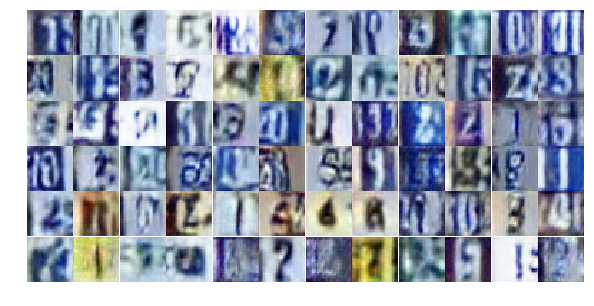

Epoch 8/25... Discriminator Loss: 0.4531... Generator Loss: 1.6250
Epoch 8/25... Discriminator Loss: 0.4734... Generator Loss: 1.8150
Epoch 8/25... Discriminator Loss: 1.0103... Generator Loss: 0.6182
Epoch 8/25... Discriminator Loss: 1.1003... Generator Loss: 3.3433
Epoch 8/25... Discriminator Loss: 1.0885... Generator Loss: 0.6361
Epoch 8/25... Discriminator Loss: 0.5815... Generator Loss: 1.5288
Epoch 8/25... Discriminator Loss: 0.4220... Generator Loss: 2.1378
Epoch 8/25... Discriminator Loss: 0.6991... Generator Loss: 1.0783
Epoch 8/25... Discriminator Loss: 0.7486... Generator Loss: 0.9357
Epoch 8/25... Discriminator Loss: 1.1317... Generator Loss: 0.6379


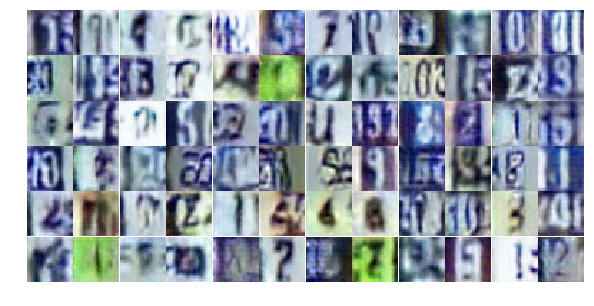

Epoch 8/25... Discriminator Loss: 0.5088... Generator Loss: 1.5230
Epoch 8/25... Discriminator Loss: 0.5108... Generator Loss: 1.2253
Epoch 8/25... Discriminator Loss: 0.6444... Generator Loss: 1.1799
Epoch 8/25... Discriminator Loss: 0.6569... Generator Loss: 1.4254
Epoch 8/25... Discriminator Loss: 0.4078... Generator Loss: 1.8122
Epoch 8/25... Discriminator Loss: 0.6120... Generator Loss: 1.5853
Epoch 8/25... Discriminator Loss: 0.7437... Generator Loss: 1.3137
Epoch 8/25... Discriminator Loss: 0.5576... Generator Loss: 1.1248
Epoch 8/25... Discriminator Loss: 0.6085... Generator Loss: 1.8504
Epoch 8/25... Discriminator Loss: 0.7846... Generator Loss: 0.8227


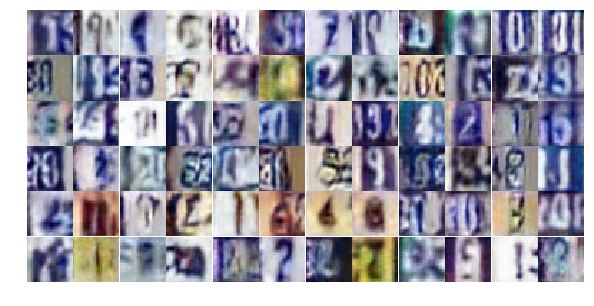

Epoch 8/25... Discriminator Loss: 0.6236... Generator Loss: 1.8974
Epoch 8/25... Discriminator Loss: 0.6877... Generator Loss: 0.9554
Epoch 8/25... Discriminator Loss: 0.6081... Generator Loss: 1.1169
Epoch 8/25... Discriminator Loss: 0.6374... Generator Loss: 1.0474
Epoch 8/25... Discriminator Loss: 0.8830... Generator Loss: 0.6595
Epoch 8/25... Discriminator Loss: 0.3694... Generator Loss: 1.9752
Epoch 8/25... Discriminator Loss: 0.6017... Generator Loss: 1.4343
Epoch 8/25... Discriminator Loss: 1.5482... Generator Loss: 1.8122
Epoch 8/25... Discriminator Loss: 0.7640... Generator Loss: 1.6304
Epoch 8/25... Discriminator Loss: 0.5161... Generator Loss: 1.5042


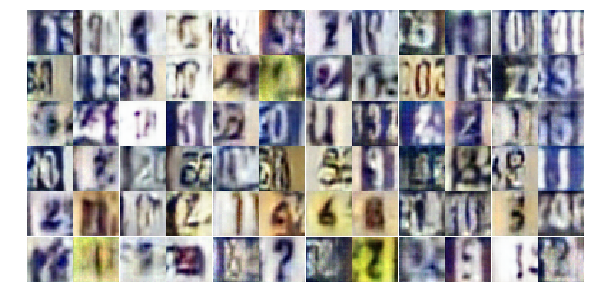

Epoch 8/25... Discriminator Loss: 0.4985... Generator Loss: 1.6573
Epoch 8/25... Discriminator Loss: 1.2323... Generator Loss: 0.5625
Epoch 8/25... Discriminator Loss: 0.6230... Generator Loss: 1.0198
Epoch 8/25... Discriminator Loss: 0.6659... Generator Loss: 1.0286
Epoch 8/25... Discriminator Loss: 0.7821... Generator Loss: 1.9212
Epoch 8/25... Discriminator Loss: 1.0766... Generator Loss: 0.5488
Epoch 8/25... Discriminator Loss: 0.4427... Generator Loss: 1.6902
Epoch 8/25... Discriminator Loss: 0.4037... Generator Loss: 1.9077
Epoch 8/25... Discriminator Loss: 3.9990... Generator Loss: 0.0346
Epoch 8/25... Discriminator Loss: 1.4696... Generator Loss: 0.3736


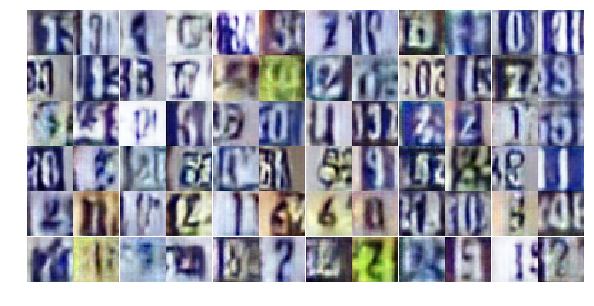

Epoch 8/25... Discriminator Loss: 0.4969... Generator Loss: 1.3704
Epoch 8/25... Discriminator Loss: 0.6692... Generator Loss: 1.1264
Epoch 8/25... Discriminator Loss: 0.6235... Generator Loss: 2.7057
Epoch 8/25... Discriminator Loss: 0.8291... Generator Loss: 0.8145
Epoch 8/25... Discriminator Loss: 0.4632... Generator Loss: 1.6271
Epoch 8/25... Discriminator Loss: 0.8468... Generator Loss: 0.9122
Epoch 8/25... Discriminator Loss: 0.5804... Generator Loss: 1.2557
Epoch 8/25... Discriminator Loss: 0.5514... Generator Loss: 1.6204
Epoch 9/25... Discriminator Loss: 0.7940... Generator Loss: 1.2938
Epoch 9/25... Discriminator Loss: 0.7028... Generator Loss: 0.9048


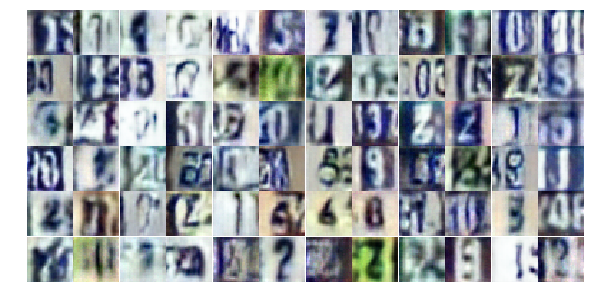

Epoch 9/25... Discriminator Loss: 0.6575... Generator Loss: 1.0257
Epoch 9/25... Discriminator Loss: 0.9117... Generator Loss: 1.0461
Epoch 9/25... Discriminator Loss: 1.5179... Generator Loss: 0.3829
Epoch 9/25... Discriminator Loss: 0.4139... Generator Loss: 1.7947
Epoch 9/25... Discriminator Loss: 0.7850... Generator Loss: 0.9285
Epoch 9/25... Discriminator Loss: 0.6224... Generator Loss: 1.7526
Epoch 9/25... Discriminator Loss: 0.8367... Generator Loss: 0.8486
Epoch 9/25... Discriminator Loss: 0.5507... Generator Loss: 1.3729
Epoch 9/25... Discriminator Loss: 0.7174... Generator Loss: 1.0978
Epoch 9/25... Discriminator Loss: 0.7204... Generator Loss: 0.9722


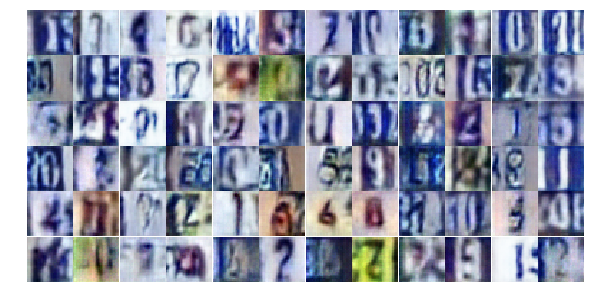

Epoch 9/25... Discriminator Loss: 0.7422... Generator Loss: 0.9121
Epoch 9/25... Discriminator Loss: 0.7840... Generator Loss: 0.9185
Epoch 9/25... Discriminator Loss: 0.6301... Generator Loss: 1.3954
Epoch 9/25... Discriminator Loss: 1.3667... Generator Loss: 0.7720
Epoch 9/25... Discriminator Loss: 0.4486... Generator Loss: 1.7697
Epoch 9/25... Discriminator Loss: 0.9538... Generator Loss: 0.6663
Epoch 9/25... Discriminator Loss: 1.1278... Generator Loss: 0.5555
Epoch 9/25... Discriminator Loss: 0.3804... Generator Loss: 1.7279
Epoch 9/25... Discriminator Loss: 1.1286... Generator Loss: 0.5323
Epoch 9/25... Discriminator Loss: 1.3342... Generator Loss: 0.4149


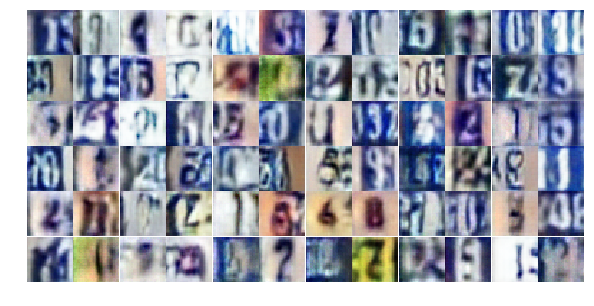

Epoch 9/25... Discriminator Loss: 1.0279... Generator Loss: 0.6959
Epoch 9/25... Discriminator Loss: 0.7681... Generator Loss: 0.8988
Epoch 9/25... Discriminator Loss: 0.5795... Generator Loss: 1.2115
Epoch 9/25... Discriminator Loss: 0.5931... Generator Loss: 1.1401
Epoch 9/25... Discriminator Loss: 0.5538... Generator Loss: 1.2076
Epoch 9/25... Discriminator Loss: 0.5656... Generator Loss: 1.1266
Epoch 9/25... Discriminator Loss: 0.8737... Generator Loss: 0.7275
Epoch 9/25... Discriminator Loss: 0.5810... Generator Loss: 1.1601
Epoch 9/25... Discriminator Loss: 0.4253... Generator Loss: 1.9292
Epoch 9/25... Discriminator Loss: 0.9529... Generator Loss: 0.6933


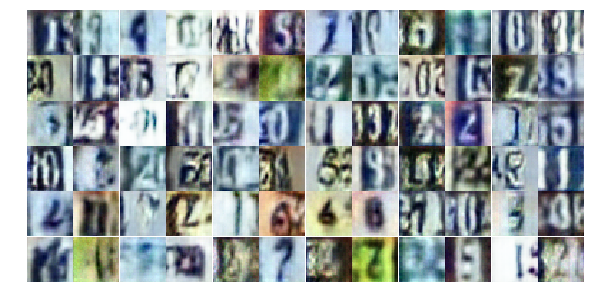

Epoch 9/25... Discriminator Loss: 0.6300... Generator Loss: 1.1107
Epoch 9/25... Discriminator Loss: 0.5738... Generator Loss: 1.1198
Epoch 9/25... Discriminator Loss: 0.7147... Generator Loss: 0.9227
Epoch 9/25... Discriminator Loss: 0.6568... Generator Loss: 1.0901
Epoch 9/25... Discriminator Loss: 0.5360... Generator Loss: 1.5387
Epoch 9/25... Discriminator Loss: 0.8993... Generator Loss: 2.3394
Epoch 9/25... Discriminator Loss: 1.0037... Generator Loss: 2.9225
Epoch 9/25... Discriminator Loss: 0.3931... Generator Loss: 1.7025
Epoch 9/25... Discriminator Loss: 1.0816... Generator Loss: 0.5471
Epoch 9/25... Discriminator Loss: 0.6781... Generator Loss: 1.0574


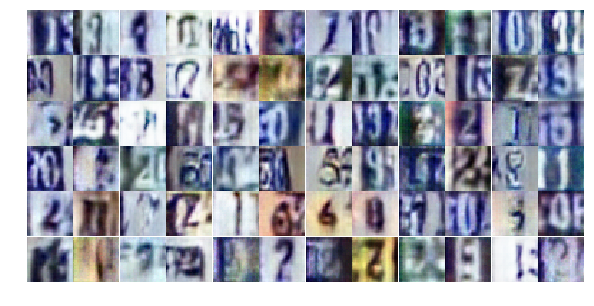

Epoch 9/25... Discriminator Loss: 0.4982... Generator Loss: 1.3361
Epoch 9/25... Discriminator Loss: 0.5467... Generator Loss: 1.2921
Epoch 9/25... Discriminator Loss: 0.6217... Generator Loss: 2.1768
Epoch 9/25... Discriminator Loss: 0.7901... Generator Loss: 0.9188
Epoch 9/25... Discriminator Loss: 0.6587... Generator Loss: 1.0540
Epoch 9/25... Discriminator Loss: 0.8917... Generator Loss: 0.7548
Epoch 9/25... Discriminator Loss: 0.5559... Generator Loss: 1.8339
Epoch 9/25... Discriminator Loss: 0.9515... Generator Loss: 0.6199
Epoch 9/25... Discriminator Loss: 0.6727... Generator Loss: 1.6024
Epoch 9/25... Discriminator Loss: 0.8674... Generator Loss: 2.4902


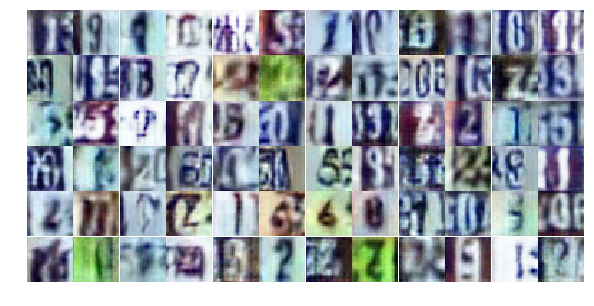

Epoch 9/25... Discriminator Loss: 0.8035... Generator Loss: 1.1352
Epoch 9/25... Discriminator Loss: 2.4350... Generator Loss: 5.0707
Epoch 9/25... Discriminator Loss: 0.6878... Generator Loss: 1.1391
Epoch 9/25... Discriminator Loss: 0.8352... Generator Loss: 0.7523
Epoch 9/25... Discriminator Loss: 0.8679... Generator Loss: 1.0754
Epoch 10/25... Discriminator Loss: 0.8149... Generator Loss: 0.9424
Epoch 10/25... Discriminator Loss: 0.5359... Generator Loss: 1.5444
Epoch 10/25... Discriminator Loss: 0.6259... Generator Loss: 1.0064
Epoch 10/25... Discriminator Loss: 0.7676... Generator Loss: 0.8941
Epoch 10/25... Discriminator Loss: 1.3110... Generator Loss: 0.4105


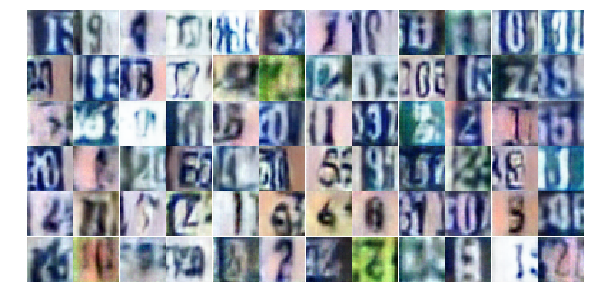

Epoch 10/25... Discriminator Loss: 0.8868... Generator Loss: 0.7403
Epoch 10/25... Discriminator Loss: 0.8672... Generator Loss: 0.8208
Epoch 10/25... Discriminator Loss: 0.6743... Generator Loss: 1.0365
Epoch 10/25... Discriminator Loss: 0.7435... Generator Loss: 1.4462
Epoch 10/25... Discriminator Loss: 0.5853... Generator Loss: 1.3477
Epoch 10/25... Discriminator Loss: 0.6697... Generator Loss: 0.9678
Epoch 10/25... Discriminator Loss: 0.4709... Generator Loss: 1.3166
Epoch 10/25... Discriminator Loss: 0.8242... Generator Loss: 0.7862
Epoch 10/25... Discriminator Loss: 1.4714... Generator Loss: 0.3723
Epoch 10/25... Discriminator Loss: 0.5513... Generator Loss: 1.6375


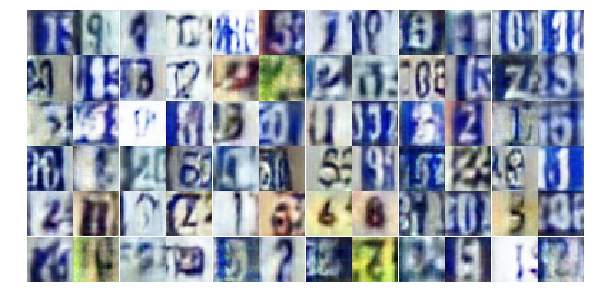

Epoch 10/25... Discriminator Loss: 0.4599... Generator Loss: 1.7046
Epoch 10/25... Discriminator Loss: 0.9504... Generator Loss: 0.7507
Epoch 10/25... Discriminator Loss: 0.6217... Generator Loss: 1.0538
Epoch 10/25... Discriminator Loss: 1.2744... Generator Loss: 0.4651
Epoch 10/25... Discriminator Loss: 0.6586... Generator Loss: 1.3518
Epoch 10/25... Discriminator Loss: 0.6899... Generator Loss: 1.0386
Epoch 10/25... Discriminator Loss: 0.9364... Generator Loss: 0.6983
Epoch 10/25... Discriminator Loss: 0.4804... Generator Loss: 1.4364
Epoch 10/25... Discriminator Loss: 0.5800... Generator Loss: 1.1551
Epoch 10/25... Discriminator Loss: 0.4145... Generator Loss: 2.1536


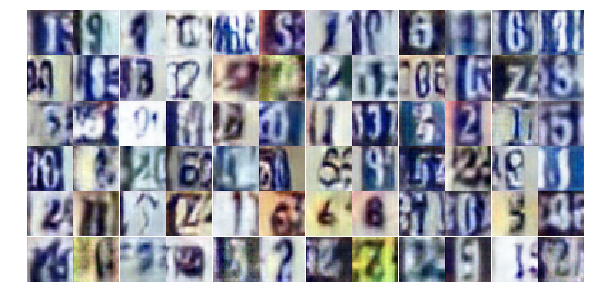

Epoch 10/25... Discriminator Loss: 1.3746... Generator Loss: 0.4181
Epoch 10/25... Discriminator Loss: 0.8464... Generator Loss: 0.8067
Epoch 10/25... Discriminator Loss: 0.5461... Generator Loss: 1.1484
Epoch 10/25... Discriminator Loss: 0.9060... Generator Loss: 2.8340
Epoch 10/25... Discriminator Loss: 1.6000... Generator Loss: 0.2893
Epoch 10/25... Discriminator Loss: 0.5435... Generator Loss: 1.3268
Epoch 10/25... Discriminator Loss: 0.3853... Generator Loss: 1.8476
Epoch 10/25... Discriminator Loss: 0.6407... Generator Loss: 1.7910
Epoch 10/25... Discriminator Loss: 0.7690... Generator Loss: 0.9029
Epoch 10/25... Discriminator Loss: 0.7805... Generator Loss: 1.1155


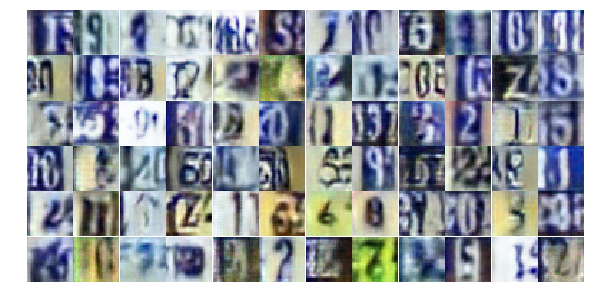

Epoch 10/25... Discriminator Loss: 0.6036... Generator Loss: 1.1889
Epoch 10/25... Discriminator Loss: 0.7563... Generator Loss: 0.9008
Epoch 10/25... Discriminator Loss: 0.4694... Generator Loss: 1.9273
Epoch 10/25... Discriminator Loss: 0.4739... Generator Loss: 1.5595
Epoch 10/25... Discriminator Loss: 0.6207... Generator Loss: 1.2008
Epoch 10/25... Discriminator Loss: 0.6832... Generator Loss: 0.9698
Epoch 10/25... Discriminator Loss: 0.7483... Generator Loss: 1.0610
Epoch 10/25... Discriminator Loss: 0.8566... Generator Loss: 0.7728
Epoch 10/25... Discriminator Loss: 0.7024... Generator Loss: 0.9157
Epoch 10/25... Discriminator Loss: 0.8148... Generator Loss: 1.0349


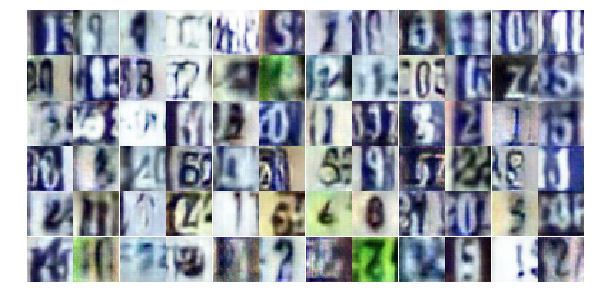

Epoch 10/25... Discriminator Loss: 0.6114... Generator Loss: 1.6033
Epoch 10/25... Discriminator Loss: 0.6032... Generator Loss: 1.4354
Epoch 10/25... Discriminator Loss: 0.7116... Generator Loss: 1.2749
Epoch 10/25... Discriminator Loss: 0.9921... Generator Loss: 0.6449
Epoch 10/25... Discriminator Loss: 0.5999... Generator Loss: 2.0395
Epoch 10/25... Discriminator Loss: 0.6884... Generator Loss: 1.0412
Epoch 10/25... Discriminator Loss: 0.4758... Generator Loss: 1.4809
Epoch 10/25... Discriminator Loss: 0.5068... Generator Loss: 1.7298
Epoch 10/25... Discriminator Loss: 0.7203... Generator Loss: 2.7481
Epoch 10/25... Discriminator Loss: 0.6581... Generator Loss: 1.5254


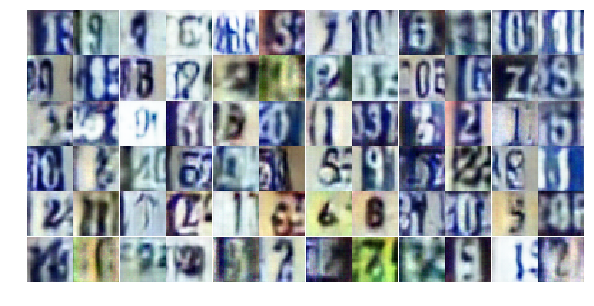

Epoch 10/25... Discriminator Loss: 0.7811... Generator Loss: 2.2528
Epoch 10/25... Discriminator Loss: 0.5827... Generator Loss: 1.1456
Epoch 10/25... Discriminator Loss: 1.0797... Generator Loss: 0.5733
Epoch 11/25... Discriminator Loss: 1.0426... Generator Loss: 0.6160
Epoch 11/25... Discriminator Loss: 0.8864... Generator Loss: 0.7541
Epoch 11/25... Discriminator Loss: 0.9729... Generator Loss: 0.6657
Epoch 11/25... Discriminator Loss: 0.5391... Generator Loss: 1.9465
Epoch 11/25... Discriminator Loss: 0.5947... Generator Loss: 1.7024
Epoch 11/25... Discriminator Loss: 1.8238... Generator Loss: 0.3037
Epoch 11/25... Discriminator Loss: 0.5205... Generator Loss: 1.8417


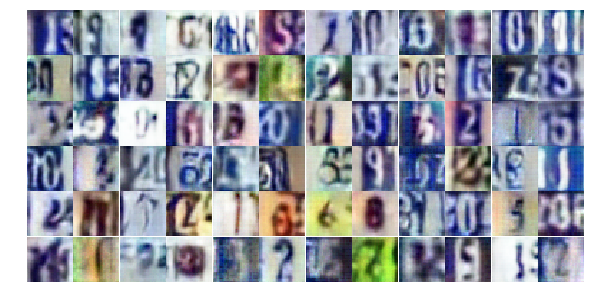

Epoch 11/25... Discriminator Loss: 0.3803... Generator Loss: 1.7064
Epoch 11/25... Discriminator Loss: 0.6966... Generator Loss: 1.0560
Epoch 11/25... Discriminator Loss: 0.5017... Generator Loss: 1.3285
Epoch 11/25... Discriminator Loss: 0.5184... Generator Loss: 1.3871
Epoch 11/25... Discriminator Loss: 0.6226... Generator Loss: 1.9748
Epoch 11/25... Discriminator Loss: 0.3833... Generator Loss: 1.7932
Epoch 11/25... Discriminator Loss: 0.5725... Generator Loss: 2.0744
Epoch 11/25... Discriminator Loss: 1.0718... Generator Loss: 2.8367
Epoch 11/25... Discriminator Loss: 1.1803... Generator Loss: 0.5546
Epoch 11/25... Discriminator Loss: 1.2148... Generator Loss: 0.5165


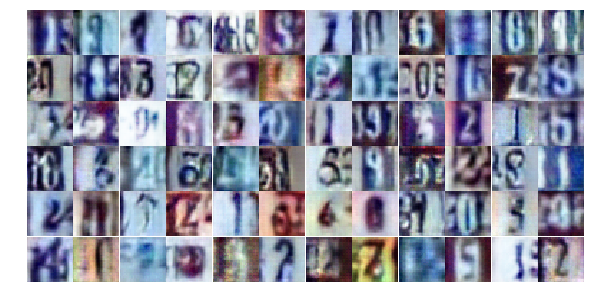

Epoch 11/25... Discriminator Loss: 0.8322... Generator Loss: 0.8603
Epoch 11/25... Discriminator Loss: 0.6735... Generator Loss: 1.3588
Epoch 11/25... Discriminator Loss: 0.8662... Generator Loss: 0.7787
Epoch 11/25... Discriminator Loss: 0.7214... Generator Loss: 0.9621
Epoch 11/25... Discriminator Loss: 0.3841... Generator Loss: 1.9605
Epoch 11/25... Discriminator Loss: 0.3733... Generator Loss: 1.9161
Epoch 11/25... Discriminator Loss: 0.6135... Generator Loss: 1.2126
Epoch 11/25... Discriminator Loss: 1.3074... Generator Loss: 0.4293
Epoch 11/25... Discriminator Loss: 0.4999... Generator Loss: 1.4450
Epoch 11/25... Discriminator Loss: 0.7363... Generator Loss: 0.9142


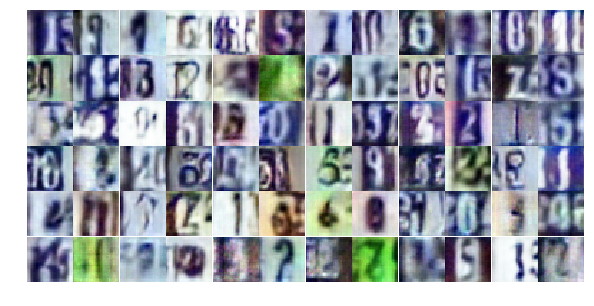

Epoch 11/25... Discriminator Loss: 1.0546... Generator Loss: 0.5379
Epoch 11/25... Discriminator Loss: 0.7249... Generator Loss: 0.9813
Epoch 11/25... Discriminator Loss: 0.8746... Generator Loss: 0.8800
Epoch 11/25... Discriminator Loss: 0.5375... Generator Loss: 1.2362
Epoch 11/25... Discriminator Loss: 0.6630... Generator Loss: 1.0386
Epoch 11/25... Discriminator Loss: 1.0971... Generator Loss: 0.5323
Epoch 11/25... Discriminator Loss: 0.9687... Generator Loss: 0.7336
Epoch 11/25... Discriminator Loss: 0.7784... Generator Loss: 0.9116
Epoch 11/25... Discriminator Loss: 0.4814... Generator Loss: 1.3545
Epoch 11/25... Discriminator Loss: 1.2378... Generator Loss: 0.4672


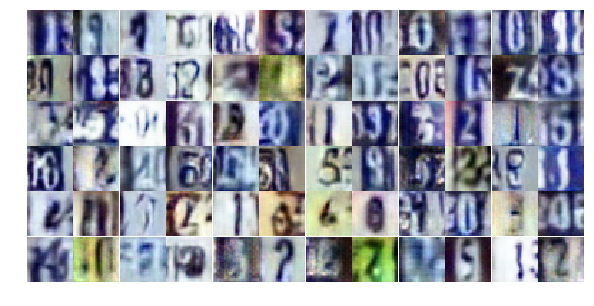

Epoch 11/25... Discriminator Loss: 0.4910... Generator Loss: 1.4583
Epoch 11/25... Discriminator Loss: 0.7370... Generator Loss: 0.8722
Epoch 11/25... Discriminator Loss: 0.7021... Generator Loss: 1.0448
Epoch 11/25... Discriminator Loss: 0.7332... Generator Loss: 1.1710
Epoch 11/25... Discriminator Loss: 1.0835... Generator Loss: 0.5980
Epoch 11/25... Discriminator Loss: 0.7766... Generator Loss: 0.8766
Epoch 11/25... Discriminator Loss: 0.4261... Generator Loss: 1.7775
Epoch 11/25... Discriminator Loss: 0.5780... Generator Loss: 1.3623
Epoch 11/25... Discriminator Loss: 1.2453... Generator Loss: 0.5462
Epoch 11/25... Discriminator Loss: 0.4606... Generator Loss: 1.4660


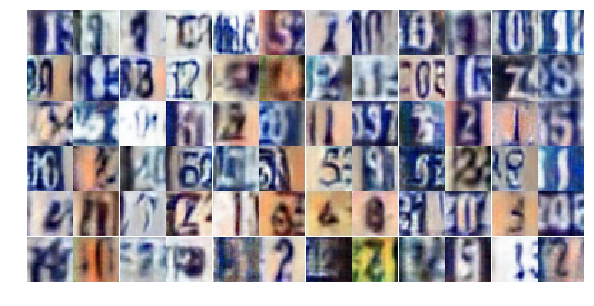

Epoch 11/25... Discriminator Loss: 1.2800... Generator Loss: 0.4996
Epoch 11/25... Discriminator Loss: 0.4275... Generator Loss: 1.8258
Epoch 11/25... Discriminator Loss: 0.6249... Generator Loss: 1.0831
Epoch 11/25... Discriminator Loss: 0.5504... Generator Loss: 1.1773
Epoch 11/25... Discriminator Loss: 1.2291... Generator Loss: 0.5338
Epoch 11/25... Discriminator Loss: 0.6625... Generator Loss: 1.0810
Epoch 11/25... Discriminator Loss: 1.2985... Generator Loss: 0.4326
Epoch 11/25... Discriminator Loss: 0.3638... Generator Loss: 2.1705
Epoch 11/25... Discriminator Loss: 1.1282... Generator Loss: 0.5681
Epoch 11/25... Discriminator Loss: 0.7780... Generator Loss: 0.8873


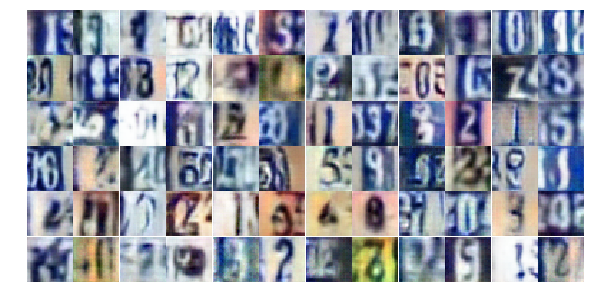

Epoch 12/25... Discriminator Loss: 0.7686... Generator Loss: 0.8939
Epoch 12/25... Discriminator Loss: 1.0042... Generator Loss: 2.7613
Epoch 12/25... Discriminator Loss: 0.7709... Generator Loss: 0.8733
Epoch 12/25... Discriminator Loss: 0.5791... Generator Loss: 1.4100
Epoch 12/25... Discriminator Loss: 0.4564... Generator Loss: 1.3547
Epoch 12/25... Discriminator Loss: 1.3111... Generator Loss: 0.4318
Epoch 12/25... Discriminator Loss: 0.5733... Generator Loss: 2.3689
Epoch 12/25... Discriminator Loss: 0.5836... Generator Loss: 1.5685
Epoch 12/25... Discriminator Loss: 0.6287... Generator Loss: 1.8298
Epoch 12/25... Discriminator Loss: 0.9744... Generator Loss: 0.6831


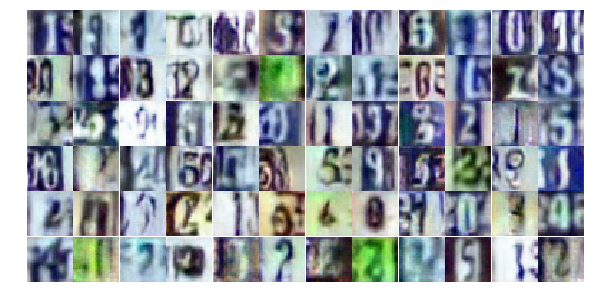

Epoch 12/25... Discriminator Loss: 0.4277... Generator Loss: 1.6205
Epoch 12/25... Discriminator Loss: 0.6690... Generator Loss: 1.0664
Epoch 12/25... Discriminator Loss: 0.5999... Generator Loss: 1.2608
Epoch 12/25... Discriminator Loss: 0.7829... Generator Loss: 0.9941
Epoch 12/25... Discriminator Loss: 0.5380... Generator Loss: 1.4368
Epoch 12/25... Discriminator Loss: 1.1575... Generator Loss: 0.5168
Epoch 12/25... Discriminator Loss: 1.1763... Generator Loss: 0.4789
Epoch 12/25... Discriminator Loss: 0.3935... Generator Loss: 1.8452
Epoch 12/25... Discriminator Loss: 0.3062... Generator Loss: 2.4948
Epoch 12/25... Discriminator Loss: 0.6390... Generator Loss: 1.2456


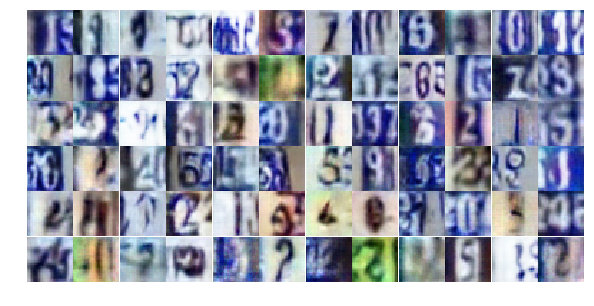

Epoch 12/25... Discriminator Loss: 0.3958... Generator Loss: 2.5217
Epoch 12/25... Discriminator Loss: 0.5097... Generator Loss: 1.5175
Epoch 12/25... Discriminator Loss: 0.6638... Generator Loss: 1.1613
Epoch 12/25... Discriminator Loss: 0.5506... Generator Loss: 2.1853
Epoch 12/25... Discriminator Loss: 0.4145... Generator Loss: 1.6664
Epoch 12/25... Discriminator Loss: 0.4494... Generator Loss: 1.3238
Epoch 12/25... Discriminator Loss: 0.4751... Generator Loss: 1.4294
Epoch 12/25... Discriminator Loss: 0.3387... Generator Loss: 1.8301
Epoch 12/25... Discriminator Loss: 0.5545... Generator Loss: 1.2616
Epoch 12/25... Discriminator Loss: 0.5532... Generator Loss: 1.6429


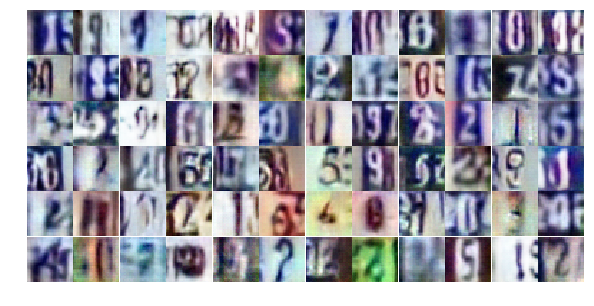

Epoch 12/25... Discriminator Loss: 0.4897... Generator Loss: 1.3917
Epoch 12/25... Discriminator Loss: 0.9852... Generator Loss: 0.6558
Epoch 12/25... Discriminator Loss: 0.7911... Generator Loss: 0.8440
Epoch 12/25... Discriminator Loss: 1.7932... Generator Loss: 0.2462
Epoch 12/25... Discriminator Loss: 0.6715... Generator Loss: 1.1170
Epoch 12/25... Discriminator Loss: 0.6889... Generator Loss: 1.0001
Epoch 12/25... Discriminator Loss: 1.2449... Generator Loss: 0.5495
Epoch 12/25... Discriminator Loss: 0.7335... Generator Loss: 1.0473
Epoch 12/25... Discriminator Loss: 0.4848... Generator Loss: 1.4591
Epoch 12/25... Discriminator Loss: 0.3124... Generator Loss: 1.8726


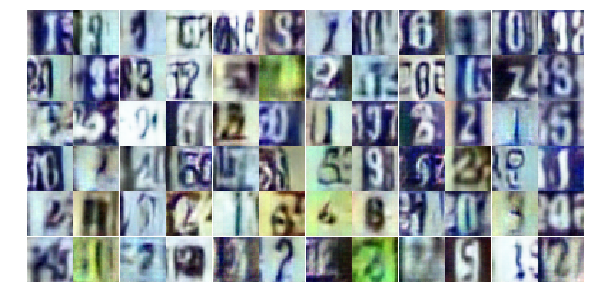

Epoch 12/25... Discriminator Loss: 0.7053... Generator Loss: 1.0271
Epoch 12/25... Discriminator Loss: 0.4920... Generator Loss: 1.3166
Epoch 12/25... Discriminator Loss: 0.5200... Generator Loss: 1.1840
Epoch 12/25... Discriminator Loss: 0.5892... Generator Loss: 1.2604
Epoch 12/25... Discriminator Loss: 1.4168... Generator Loss: 0.4814
Epoch 12/25... Discriminator Loss: 0.8769... Generator Loss: 0.7936
Epoch 12/25... Discriminator Loss: 0.6702... Generator Loss: 1.0519
Epoch 12/25... Discriminator Loss: 0.7109... Generator Loss: 0.9894
Epoch 12/25... Discriminator Loss: 0.4798... Generator Loss: 1.4776
Epoch 12/25... Discriminator Loss: 0.6648... Generator Loss: 0.9918


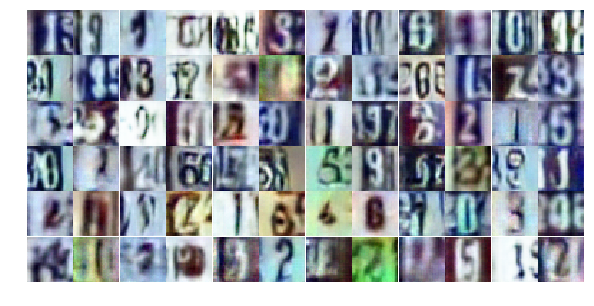

Epoch 12/25... Discriminator Loss: 0.7372... Generator Loss: 1.1509
Epoch 12/25... Discriminator Loss: 1.3704... Generator Loss: 0.3747
Epoch 12/25... Discriminator Loss: 0.5878... Generator Loss: 2.5119
Epoch 12/25... Discriminator Loss: 1.2021... Generator Loss: 0.5216
Epoch 12/25... Discriminator Loss: 0.6749... Generator Loss: 0.9645
Epoch 12/25... Discriminator Loss: 0.6093... Generator Loss: 1.9899
Epoch 12/25... Discriminator Loss: 0.8924... Generator Loss: 0.8580
Epoch 13/25... Discriminator Loss: 0.5609... Generator Loss: 1.1036
Epoch 13/25... Discriminator Loss: 0.3552... Generator Loss: 1.7309
Epoch 13/25... Discriminator Loss: 0.7525... Generator Loss: 0.9288


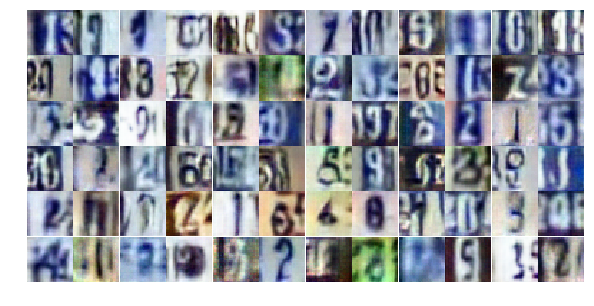

Epoch 13/25... Discriminator Loss: 0.4823... Generator Loss: 1.3108
Epoch 13/25... Discriminator Loss: 1.0509... Generator Loss: 3.3866
Epoch 13/25... Discriminator Loss: 0.7418... Generator Loss: 1.5180
Epoch 13/25... Discriminator Loss: 0.8710... Generator Loss: 1.0093
Epoch 13/25... Discriminator Loss: 0.5829... Generator Loss: 1.1395
Epoch 13/25... Discriminator Loss: 0.5047... Generator Loss: 1.3622
Epoch 13/25... Discriminator Loss: 0.3265... Generator Loss: 2.0804
Epoch 13/25... Discriminator Loss: 0.7575... Generator Loss: 0.8748
Epoch 13/25... Discriminator Loss: 0.6339... Generator Loss: 1.0083
Epoch 13/25... Discriminator Loss: 0.4012... Generator Loss: 1.7115


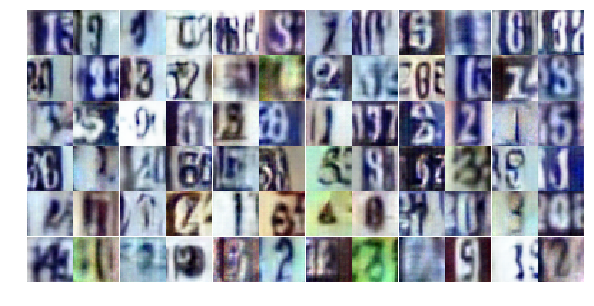

Epoch 13/25... Discriminator Loss: 1.6591... Generator Loss: 4.5498
Epoch 13/25... Discriminator Loss: 0.6224... Generator Loss: 2.4832
Epoch 13/25... Discriminator Loss: 0.7807... Generator Loss: 1.6426
Epoch 13/25... Discriminator Loss: 0.6518... Generator Loss: 1.2206
Epoch 13/25... Discriminator Loss: 0.5543... Generator Loss: 1.2192
Epoch 13/25... Discriminator Loss: 0.9963... Generator Loss: 0.6143
Epoch 13/25... Discriminator Loss: 0.6510... Generator Loss: 1.2129
Epoch 13/25... Discriminator Loss: 1.0217... Generator Loss: 0.6372
Epoch 13/25... Discriminator Loss: 0.7999... Generator Loss: 0.8174
Epoch 13/25... Discriminator Loss: 0.9961... Generator Loss: 0.6344


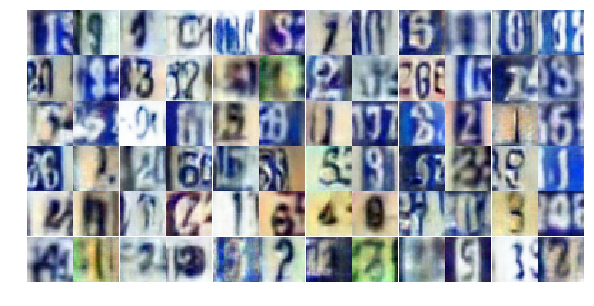

Epoch 13/25... Discriminator Loss: 0.7881... Generator Loss: 0.9063
Epoch 13/25... Discriminator Loss: 0.5082... Generator Loss: 1.4913
Epoch 13/25... Discriminator Loss: 0.6704... Generator Loss: 1.7555
Epoch 13/25... Discriminator Loss: 0.5637... Generator Loss: 1.1912
Epoch 13/25... Discriminator Loss: 0.8804... Generator Loss: 0.7825
Epoch 13/25... Discriminator Loss: 0.6390... Generator Loss: 1.1768
Epoch 13/25... Discriminator Loss: 0.5173... Generator Loss: 1.6226
Epoch 13/25... Discriminator Loss: 0.5221... Generator Loss: 1.3269
Epoch 13/25... Discriminator Loss: 0.5972... Generator Loss: 1.1276
Epoch 13/25... Discriminator Loss: 0.4371... Generator Loss: 1.5386


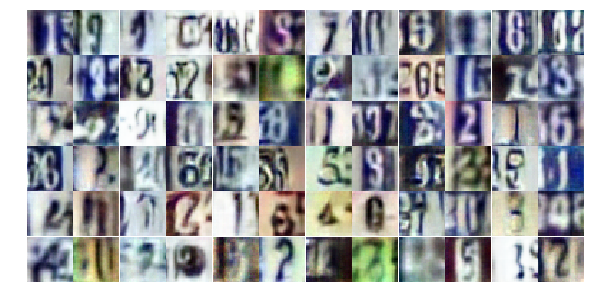

Epoch 13/25... Discriminator Loss: 1.0143... Generator Loss: 0.5872
Epoch 13/25... Discriminator Loss: 0.8626... Generator Loss: 0.7915
Epoch 13/25... Discriminator Loss: 1.0430... Generator Loss: 0.6172
Epoch 13/25... Discriminator Loss: 1.0855... Generator Loss: 0.6459
Epoch 13/25... Discriminator Loss: 0.6485... Generator Loss: 1.0671
Epoch 13/25... Discriminator Loss: 0.5712... Generator Loss: 1.4182
Epoch 13/25... Discriminator Loss: 0.4132... Generator Loss: 2.0668
Epoch 13/25... Discriminator Loss: 1.3883... Generator Loss: 0.4444
Epoch 13/25... Discriminator Loss: 0.6047... Generator Loss: 1.1141
Epoch 13/25... Discriminator Loss: 0.6922... Generator Loss: 0.9913


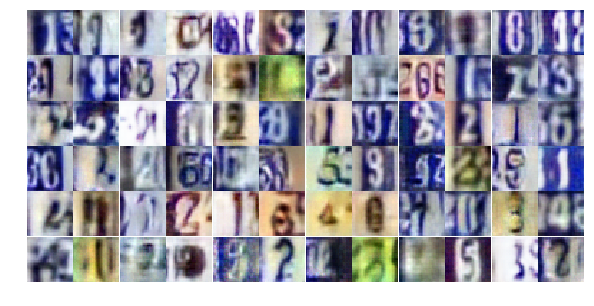

Epoch 13/25... Discriminator Loss: 0.6411... Generator Loss: 1.1417
Epoch 13/25... Discriminator Loss: 0.9410... Generator Loss: 0.7195
Epoch 13/25... Discriminator Loss: 0.8030... Generator Loss: 0.8269
Epoch 13/25... Discriminator Loss: 0.5204... Generator Loss: 1.3633
Epoch 13/25... Discriminator Loss: 0.8954... Generator Loss: 0.7785
Epoch 13/25... Discriminator Loss: 0.5142... Generator Loss: 1.5069
Epoch 13/25... Discriminator Loss: 0.6793... Generator Loss: 1.0826
Epoch 13/25... Discriminator Loss: 0.7879... Generator Loss: 0.9080
Epoch 13/25... Discriminator Loss: 0.8305... Generator Loss: 0.8058
Epoch 13/25... Discriminator Loss: 0.6946... Generator Loss: 0.9299


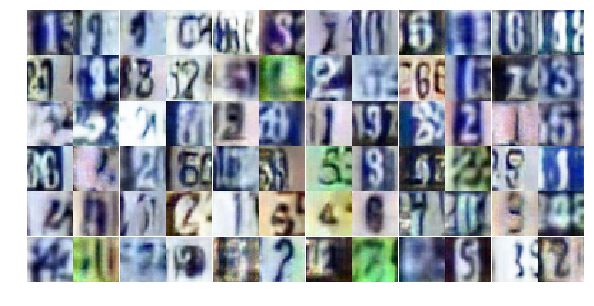

Epoch 13/25... Discriminator Loss: 0.3208... Generator Loss: 2.5344
Epoch 13/25... Discriminator Loss: 1.1339... Generator Loss: 0.5798
Epoch 13/25... Discriminator Loss: 0.8134... Generator Loss: 0.8852
Epoch 13/25... Discriminator Loss: 1.1977... Generator Loss: 0.6548
Epoch 14/25... Discriminator Loss: 0.8101... Generator Loss: 0.7883
Epoch 14/25... Discriminator Loss: 0.7637... Generator Loss: 0.8876
Epoch 14/25... Discriminator Loss: 0.7109... Generator Loss: 1.1730
Epoch 14/25... Discriminator Loss: 0.5384... Generator Loss: 1.7822
Epoch 14/25... Discriminator Loss: 0.5124... Generator Loss: 1.5131
Epoch 14/25... Discriminator Loss: 0.8259... Generator Loss: 0.8111


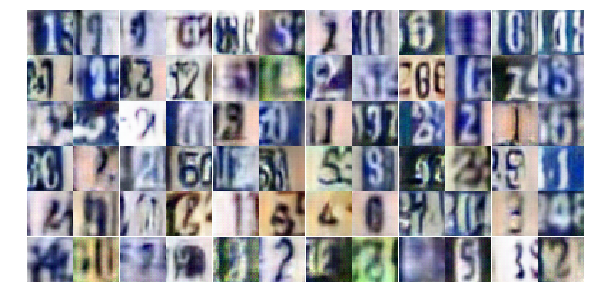

Epoch 14/25... Discriminator Loss: 0.6935... Generator Loss: 1.8517
Epoch 14/25... Discriminator Loss: 0.5381... Generator Loss: 1.1283
Epoch 14/25... Discriminator Loss: 0.7069... Generator Loss: 0.9647
Epoch 14/25... Discriminator Loss: 0.7155... Generator Loss: 0.9740
Epoch 14/25... Discriminator Loss: 0.8073... Generator Loss: 0.8010
Epoch 14/25... Discriminator Loss: 0.2939... Generator Loss: 1.8015
Epoch 14/25... Discriminator Loss: 0.3293... Generator Loss: 2.3925
Epoch 14/25... Discriminator Loss: 1.4308... Generator Loss: 0.4402
Epoch 14/25... Discriminator Loss: 0.8908... Generator Loss: 0.7345
Epoch 14/25... Discriminator Loss: 1.5909... Generator Loss: 0.3232


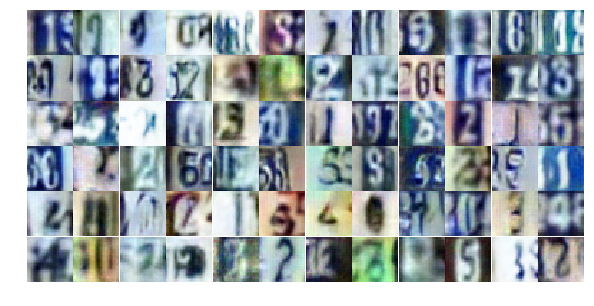

Epoch 14/25... Discriminator Loss: 0.6436... Generator Loss: 1.1249
Epoch 14/25... Discriminator Loss: 0.6216... Generator Loss: 2.1751
Epoch 14/25... Discriminator Loss: 0.8930... Generator Loss: 0.8751
Epoch 14/25... Discriminator Loss: 0.4806... Generator Loss: 1.3893
Epoch 14/25... Discriminator Loss: 0.9290... Generator Loss: 0.7642
Epoch 14/25... Discriminator Loss: 0.6858... Generator Loss: 1.6858
Epoch 14/25... Discriminator Loss: 1.3616... Generator Loss: 0.4550
Epoch 14/25... Discriminator Loss: 1.4901... Generator Loss: 0.4031
Epoch 14/25... Discriminator Loss: 0.6162... Generator Loss: 1.1772
Epoch 14/25... Discriminator Loss: 0.5215... Generator Loss: 1.3465


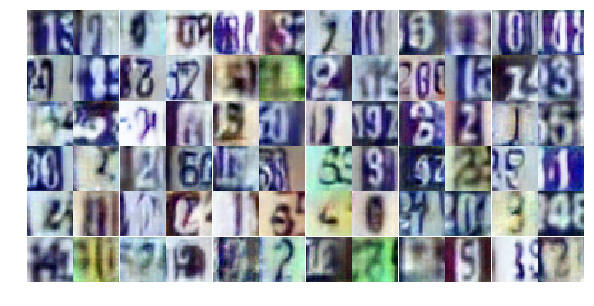

Epoch 14/25... Discriminator Loss: 1.1349... Generator Loss: 0.6115
Epoch 14/25... Discriminator Loss: 0.6250... Generator Loss: 1.2456
Epoch 14/25... Discriminator Loss: 0.7481... Generator Loss: 0.9486
Epoch 14/25... Discriminator Loss: 0.4933... Generator Loss: 1.2496
Epoch 14/25... Discriminator Loss: 0.7298... Generator Loss: 0.9182
Epoch 14/25... Discriminator Loss: 0.6558... Generator Loss: 1.1338
Epoch 14/25... Discriminator Loss: 0.7210... Generator Loss: 0.9418
Epoch 14/25... Discriminator Loss: 0.3922... Generator Loss: 1.9632
Epoch 14/25... Discriminator Loss: 0.4610... Generator Loss: 1.6424
Epoch 14/25... Discriminator Loss: 0.7345... Generator Loss: 1.8185


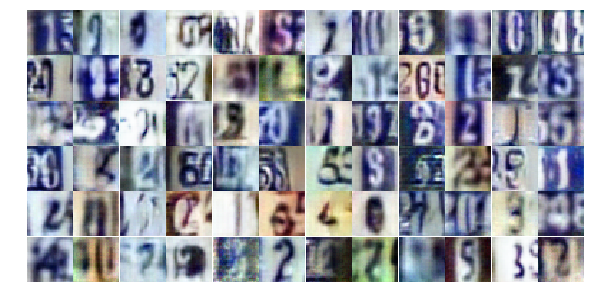

Epoch 14/25... Discriminator Loss: 1.0907... Generator Loss: 0.5784
Epoch 14/25... Discriminator Loss: 1.2536... Generator Loss: 0.5162
Epoch 14/25... Discriminator Loss: 1.0252... Generator Loss: 0.6177
Epoch 14/25... Discriminator Loss: 0.7653... Generator Loss: 0.9193
Epoch 14/25... Discriminator Loss: 0.7463... Generator Loss: 1.0282
Epoch 14/25... Discriminator Loss: 0.8166... Generator Loss: 0.8720
Epoch 14/25... Discriminator Loss: 0.5787... Generator Loss: 1.3118
Epoch 14/25... Discriminator Loss: 0.4124... Generator Loss: 1.5993
Epoch 14/25... Discriminator Loss: 1.5545... Generator Loss: 0.3419
Epoch 14/25... Discriminator Loss: 1.3111... Generator Loss: 0.5195


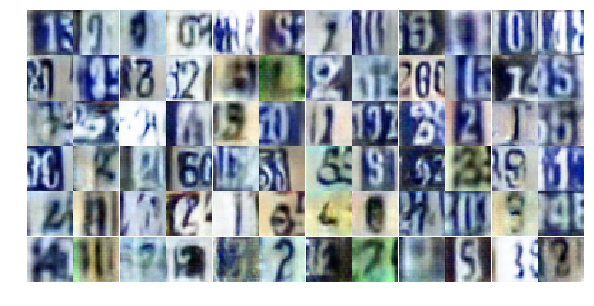

Epoch 14/25... Discriminator Loss: 0.9039... Generator Loss: 0.8465
Epoch 14/25... Discriminator Loss: 1.2771... Generator Loss: 0.4905
Epoch 14/25... Discriminator Loss: 0.5208... Generator Loss: 1.3642
Epoch 14/25... Discriminator Loss: 0.6493... Generator Loss: 1.1967
Epoch 14/25... Discriminator Loss: 0.5116... Generator Loss: 1.3151
Epoch 14/25... Discriminator Loss: 0.7561... Generator Loss: 0.8830
Epoch 14/25... Discriminator Loss: 0.7649... Generator Loss: 0.9850
Epoch 14/25... Discriminator Loss: 0.8309... Generator Loss: 0.9271
Epoch 14/25... Discriminator Loss: 0.9275... Generator Loss: 1.2549
Epoch 14/25... Discriminator Loss: 0.9945... Generator Loss: 0.6403


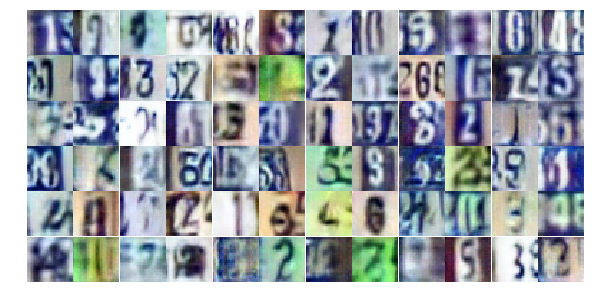

Epoch 14/25... Discriminator Loss: 0.7369... Generator Loss: 0.9881
Epoch 14/25... Discriminator Loss: 0.9135... Generator Loss: 0.9431
Epoch 15/25... Discriminator Loss: 0.5424... Generator Loss: 1.5144
Epoch 15/25... Discriminator Loss: 0.4809... Generator Loss: 1.6558
Epoch 15/25... Discriminator Loss: 0.5678... Generator Loss: 1.2252
Epoch 15/25... Discriminator Loss: 0.7175... Generator Loss: 0.9923
Epoch 15/25... Discriminator Loss: 0.7694... Generator Loss: 0.8363
Epoch 15/25... Discriminator Loss: 1.1130... Generator Loss: 0.5415
Epoch 15/25... Discriminator Loss: 1.5969... Generator Loss: 0.3267
Epoch 15/25... Discriminator Loss: 0.6025... Generator Loss: 1.0999


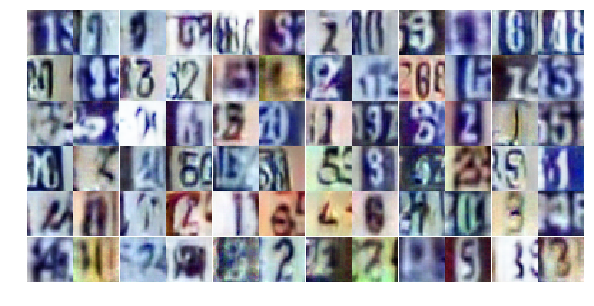

Epoch 15/25... Discriminator Loss: 0.6836... Generator Loss: 1.0451
Epoch 15/25... Discriminator Loss: 0.7197... Generator Loss: 1.2788
Epoch 15/25... Discriminator Loss: 1.0383... Generator Loss: 0.6398
Epoch 15/25... Discriminator Loss: 0.6967... Generator Loss: 0.9093
Epoch 15/25... Discriminator Loss: 1.0164... Generator Loss: 0.7204
Epoch 15/25... Discriminator Loss: 0.4475... Generator Loss: 1.5854
Epoch 15/25... Discriminator Loss: 1.2352... Generator Loss: 0.5304
Epoch 15/25... Discriminator Loss: 1.6479... Generator Loss: 2.9956
Epoch 15/25... Discriminator Loss: 0.8350... Generator Loss: 3.2916
Epoch 15/25... Discriminator Loss: 0.9795... Generator Loss: 0.7149


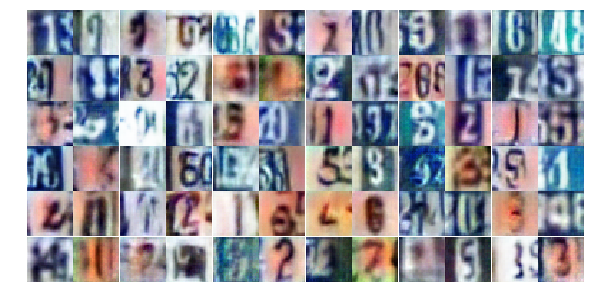

Epoch 15/25... Discriminator Loss: 0.9028... Generator Loss: 0.7430
Epoch 15/25... Discriminator Loss: 0.6040... Generator Loss: 1.1789
Epoch 15/25... Discriminator Loss: 0.4867... Generator Loss: 1.6195
Epoch 15/25... Discriminator Loss: 1.3536... Generator Loss: 0.4090
Epoch 15/25... Discriminator Loss: 0.9673... Generator Loss: 0.7504
Epoch 15/25... Discriminator Loss: 0.5380... Generator Loss: 1.3764
Epoch 15/25... Discriminator Loss: 0.9076... Generator Loss: 0.8496
Epoch 15/25... Discriminator Loss: 0.5007... Generator Loss: 1.5426
Epoch 15/25... Discriminator Loss: 0.5910... Generator Loss: 1.1249
Epoch 15/25... Discriminator Loss: 1.0313... Generator Loss: 0.6472


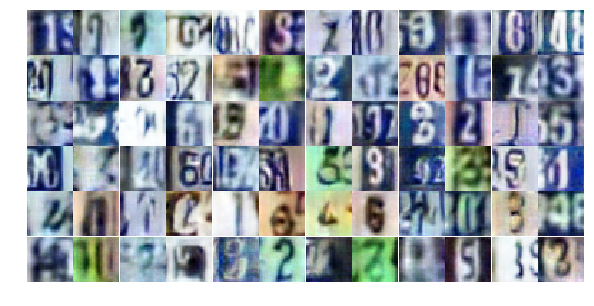

Epoch 15/25... Discriminator Loss: 0.6638... Generator Loss: 1.0266
Epoch 15/25... Discriminator Loss: 0.5599... Generator Loss: 1.3217
Epoch 15/25... Discriminator Loss: 0.4758... Generator Loss: 1.2799
Epoch 15/25... Discriminator Loss: 0.5885... Generator Loss: 1.2842
Epoch 15/25... Discriminator Loss: 0.7357... Generator Loss: 0.9102
Epoch 15/25... Discriminator Loss: 0.8955... Generator Loss: 2.5142
Epoch 15/25... Discriminator Loss: 0.4980... Generator Loss: 1.4563
Epoch 15/25... Discriminator Loss: 0.7361... Generator Loss: 0.9195
Epoch 15/25... Discriminator Loss: 0.4959... Generator Loss: 1.2446
Epoch 15/25... Discriminator Loss: 0.6539... Generator Loss: 1.2290


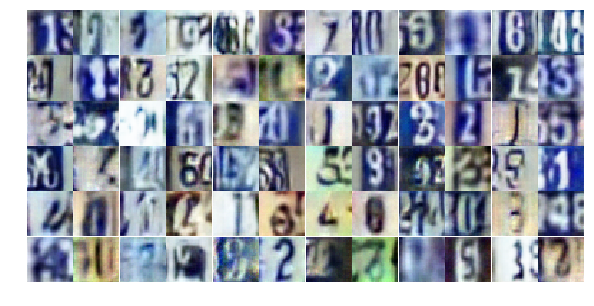

Epoch 15/25... Discriminator Loss: 0.6086... Generator Loss: 1.1137
Epoch 15/25... Discriminator Loss: 1.0281... Generator Loss: 0.6178
Epoch 15/25... Discriminator Loss: 0.7163... Generator Loss: 1.0142
Epoch 15/25... Discriminator Loss: 0.5040... Generator Loss: 1.3498
Epoch 15/25... Discriminator Loss: 0.5047... Generator Loss: 1.2370
Epoch 15/25... Discriminator Loss: 1.1526... Generator Loss: 2.2215
Epoch 15/25... Discriminator Loss: 0.6340... Generator Loss: 1.0438
Epoch 15/25... Discriminator Loss: 0.8573... Generator Loss: 1.1692
Epoch 15/25... Discriminator Loss: 0.5312... Generator Loss: 1.4618
Epoch 15/25... Discriminator Loss: 1.2527... Generator Loss: 0.5129


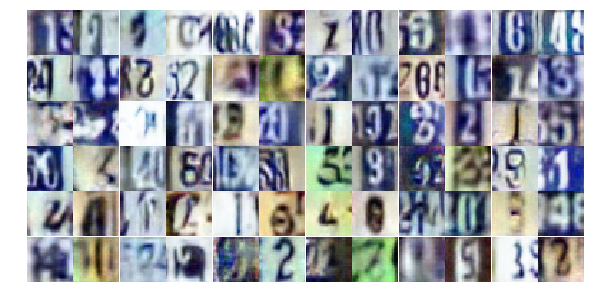

Epoch 15/25... Discriminator Loss: 0.8976... Generator Loss: 0.7573
Epoch 15/25... Discriminator Loss: 1.3689... Generator Loss: 0.4866
Epoch 15/25... Discriminator Loss: 0.6295... Generator Loss: 2.6573
Epoch 15/25... Discriminator Loss: 1.1423... Generator Loss: 0.5399
Epoch 15/25... Discriminator Loss: 2.2950... Generator Loss: 0.1684
Epoch 15/25... Discriminator Loss: 0.8945... Generator Loss: 0.9596
Epoch 15/25... Discriminator Loss: 0.8517... Generator Loss: 0.7869
Epoch 15/25... Discriminator Loss: 0.4504... Generator Loss: 1.7297
Epoch 15/25... Discriminator Loss: 1.0424... Generator Loss: 0.9779
Epoch 16/25... Discriminator Loss: 1.1375... Generator Loss: 0.5711


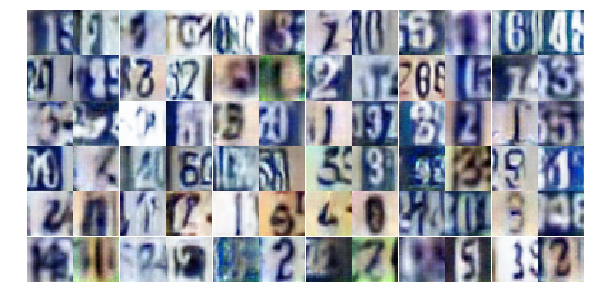

Epoch 16/25... Discriminator Loss: 0.5675... Generator Loss: 1.2023
Epoch 16/25... Discriminator Loss: 0.7816... Generator Loss: 1.2004
Epoch 16/25... Discriminator Loss: 1.3906... Generator Loss: 0.4280
Epoch 16/25... Discriminator Loss: 1.1115... Generator Loss: 0.6658
Epoch 16/25... Discriminator Loss: 0.4492... Generator Loss: 2.0139
Epoch 16/25... Discriminator Loss: 0.5304... Generator Loss: 1.4927
Epoch 16/25... Discriminator Loss: 1.5178... Generator Loss: 0.3907
Epoch 16/25... Discriminator Loss: 0.8147... Generator Loss: 0.8661
Epoch 16/25... Discriminator Loss: 0.5609... Generator Loss: 1.2021
Epoch 16/25... Discriminator Loss: 0.9241... Generator Loss: 0.6913


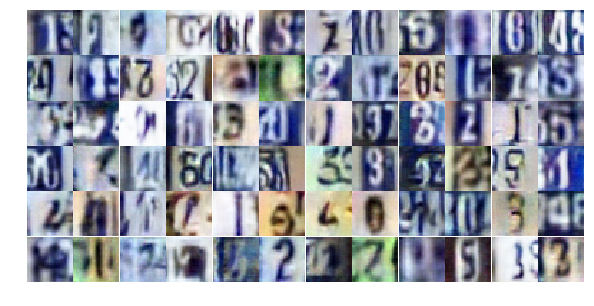

Epoch 16/25... Discriminator Loss: 0.9691... Generator Loss: 0.7201
Epoch 16/25... Discriminator Loss: 0.6531... Generator Loss: 1.6671
Epoch 16/25... Discriminator Loss: 0.5599... Generator Loss: 1.3932
Epoch 16/25... Discriminator Loss: 1.3764... Generator Loss: 0.3814
Epoch 16/25... Discriminator Loss: 0.4312... Generator Loss: 1.4976
Epoch 16/25... Discriminator Loss: 0.7248... Generator Loss: 1.0639
Epoch 16/25... Discriminator Loss: 2.2455... Generator Loss: 0.1999
Epoch 16/25... Discriminator Loss: 0.4063... Generator Loss: 1.7209
Epoch 16/25... Discriminator Loss: 0.5907... Generator Loss: 1.1997
Epoch 16/25... Discriminator Loss: 0.6839... Generator Loss: 1.1836


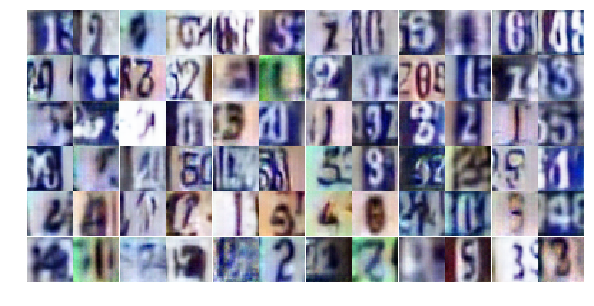

Epoch 16/25... Discriminator Loss: 0.6494... Generator Loss: 1.2469
Epoch 16/25... Discriminator Loss: 0.6932... Generator Loss: 1.0679
Epoch 16/25... Discriminator Loss: 0.6863... Generator Loss: 1.0702
Epoch 16/25... Discriminator Loss: 1.0517... Generator Loss: 0.5768
Epoch 16/25... Discriminator Loss: 0.9360... Generator Loss: 0.7401
Epoch 16/25... Discriminator Loss: 1.0661... Generator Loss: 0.5904
Epoch 16/25... Discriminator Loss: 0.7615... Generator Loss: 0.8429
Epoch 16/25... Discriminator Loss: 0.4893... Generator Loss: 1.5786
Epoch 16/25... Discriminator Loss: 0.7135... Generator Loss: 1.1117
Epoch 16/25... Discriminator Loss: 0.4923... Generator Loss: 1.3225


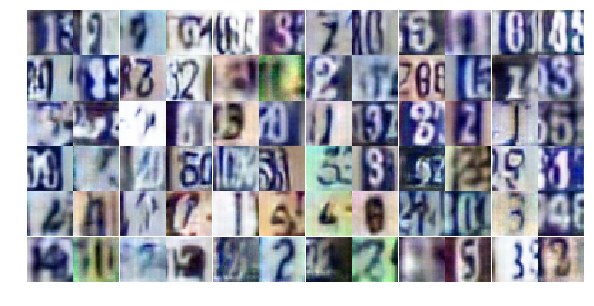

Epoch 16/25... Discriminator Loss: 0.6570... Generator Loss: 1.0243
Epoch 16/25... Discriminator Loss: 0.6706... Generator Loss: 1.0014
Epoch 16/25... Discriminator Loss: 0.5765... Generator Loss: 1.2941
Epoch 16/25... Discriminator Loss: 0.5073... Generator Loss: 1.4504
Epoch 16/25... Discriminator Loss: 2.0305... Generator Loss: 3.9403
Epoch 16/25... Discriminator Loss: 0.7011... Generator Loss: 1.0696
Epoch 16/25... Discriminator Loss: 0.7258... Generator Loss: 1.0902
Epoch 16/25... Discriminator Loss: 0.7975... Generator Loss: 0.8330
Epoch 16/25... Discriminator Loss: 1.1770... Generator Loss: 0.5137
Epoch 16/25... Discriminator Loss: 0.4593... Generator Loss: 1.6750


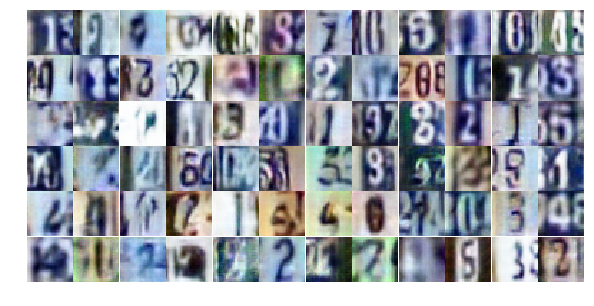

Epoch 16/25... Discriminator Loss: 0.6850... Generator Loss: 1.0162
Epoch 16/25... Discriminator Loss: 0.6121... Generator Loss: 1.9862
Epoch 16/25... Discriminator Loss: 1.0793... Generator Loss: 0.5970
Epoch 16/25... Discriminator Loss: 1.4161... Generator Loss: 0.3740
Epoch 16/25... Discriminator Loss: 0.8508... Generator Loss: 0.7873
Epoch 16/25... Discriminator Loss: 0.9899... Generator Loss: 0.6745
Epoch 16/25... Discriminator Loss: 0.5472... Generator Loss: 1.6600
Epoch 16/25... Discriminator Loss: 0.8762... Generator Loss: 0.7339
Epoch 16/25... Discriminator Loss: 0.5675... Generator Loss: 1.1781
Epoch 16/25... Discriminator Loss: 0.7549... Generator Loss: 0.9067


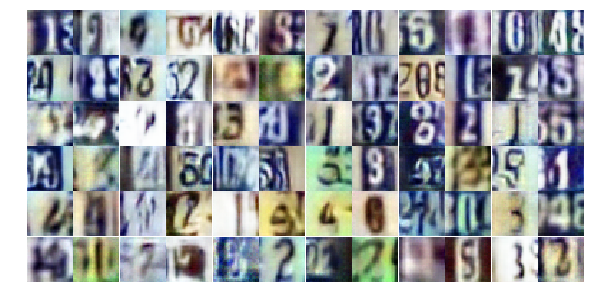

Epoch 16/25... Discriminator Loss: 1.2939... Generator Loss: 0.4498
Epoch 16/25... Discriminator Loss: 0.8437... Generator Loss: 0.8021
Epoch 16/25... Discriminator Loss: 1.8444... Generator Loss: 0.2489
Epoch 16/25... Discriminator Loss: 0.7830... Generator Loss: 2.6133
Epoch 16/25... Discriminator Loss: 0.6554... Generator Loss: 1.0404
Epoch 16/25... Discriminator Loss: 0.7066... Generator Loss: 0.9726
Epoch 17/25... Discriminator Loss: 0.6372... Generator Loss: 1.0645
Epoch 17/25... Discriminator Loss: 0.8500... Generator Loss: 0.7824
Epoch 17/25... Discriminator Loss: 0.6712... Generator Loss: 1.1014
Epoch 17/25... Discriminator Loss: 0.5281... Generator Loss: 1.4511


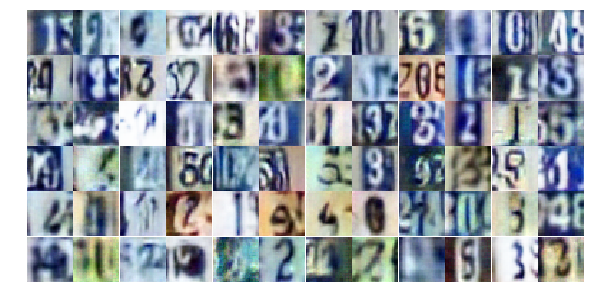

Epoch 17/25... Discriminator Loss: 0.4265... Generator Loss: 1.6717
Epoch 17/25... Discriminator Loss: 0.5677... Generator Loss: 1.1917
Epoch 17/25... Discriminator Loss: 0.7188... Generator Loss: 1.1130
Epoch 17/25... Discriminator Loss: 0.8448... Generator Loss: 0.7969
Epoch 17/25... Discriminator Loss: 1.4090... Generator Loss: 0.3836
Epoch 17/25... Discriminator Loss: 1.1290... Generator Loss: 0.6041
Epoch 17/25... Discriminator Loss: 0.6692... Generator Loss: 1.5780
Epoch 17/25... Discriminator Loss: 0.6548... Generator Loss: 1.0238
Epoch 17/25... Discriminator Loss: 0.3220... Generator Loss: 2.0041
Epoch 17/25... Discriminator Loss: 0.6149... Generator Loss: 1.4656


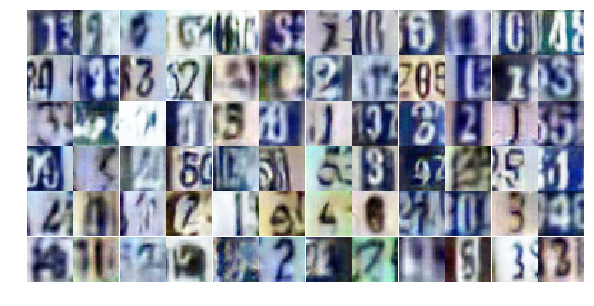

Epoch 17/25... Discriminator Loss: 0.8994... Generator Loss: 1.6621
Epoch 17/25... Discriminator Loss: 1.1241... Generator Loss: 4.2073
Epoch 17/25... Discriminator Loss: 1.0060... Generator Loss: 0.7871
Epoch 17/25... Discriminator Loss: 0.6482... Generator Loss: 1.3856
Epoch 17/25... Discriminator Loss: 0.4847... Generator Loss: 1.4428
Epoch 17/25... Discriminator Loss: 1.1758... Generator Loss: 0.5479
Epoch 17/25... Discriminator Loss: 0.6177... Generator Loss: 1.2233
Epoch 17/25... Discriminator Loss: 0.6204... Generator Loss: 1.1046
Epoch 17/25... Discriminator Loss: 0.5815... Generator Loss: 1.2541
Epoch 17/25... Discriminator Loss: 0.4836... Generator Loss: 1.4012


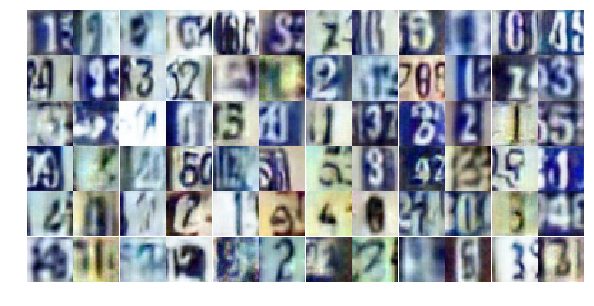

Epoch 17/25... Discriminator Loss: 1.3353... Generator Loss: 0.4210
Epoch 17/25... Discriminator Loss: 0.3642... Generator Loss: 1.9884
Epoch 17/25... Discriminator Loss: 0.7962... Generator Loss: 0.7640
Epoch 17/25... Discriminator Loss: 0.8946... Generator Loss: 0.7318
Epoch 17/25... Discriminator Loss: 1.5891... Generator Loss: 0.3274
Epoch 17/25... Discriminator Loss: 0.7329... Generator Loss: 1.0654
Epoch 17/25... Discriminator Loss: 0.6750... Generator Loss: 1.1851
Epoch 17/25... Discriminator Loss: 0.6614... Generator Loss: 1.0131
Epoch 17/25... Discriminator Loss: 0.8805... Generator Loss: 0.8881
Epoch 17/25... Discriminator Loss: 0.3406... Generator Loss: 1.7864


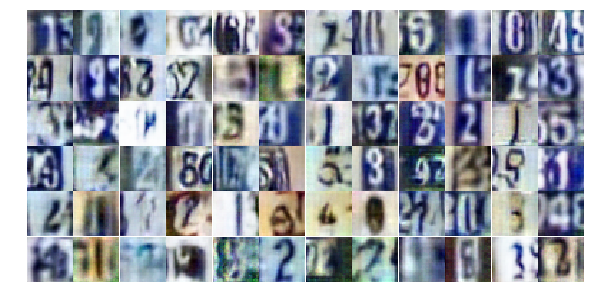

Epoch 17/25... Discriminator Loss: 0.5479... Generator Loss: 1.4812
Epoch 17/25... Discriminator Loss: 1.5840... Generator Loss: 0.3527
Epoch 17/25... Discriminator Loss: 0.7000... Generator Loss: 1.2567
Epoch 17/25... Discriminator Loss: 0.7315... Generator Loss: 1.2653
Epoch 17/25... Discriminator Loss: 0.7448... Generator Loss: 0.9235
Epoch 17/25... Discriminator Loss: 0.5269... Generator Loss: 1.2425
Epoch 17/25... Discriminator Loss: 0.7876... Generator Loss: 0.9917
Epoch 17/25... Discriminator Loss: 0.3804... Generator Loss: 1.6459
Epoch 17/25... Discriminator Loss: 0.3899... Generator Loss: 2.1657
Epoch 17/25... Discriminator Loss: 0.6996... Generator Loss: 0.9656


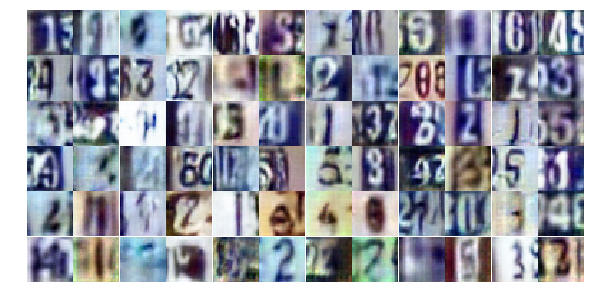

Epoch 17/25... Discriminator Loss: 1.1496... Generator Loss: 0.6533
Epoch 17/25... Discriminator Loss: 0.3307... Generator Loss: 1.6638
Epoch 17/25... Discriminator Loss: 0.5703... Generator Loss: 1.5441
Epoch 17/25... Discriminator Loss: 0.4822... Generator Loss: 1.4735
Epoch 17/25... Discriminator Loss: 0.9851... Generator Loss: 0.7193
Epoch 17/25... Discriminator Loss: 0.7444... Generator Loss: 1.1786
Epoch 17/25... Discriminator Loss: 1.3935... Generator Loss: 0.3778
Epoch 17/25... Discriminator Loss: 0.5658... Generator Loss: 1.2690
Epoch 17/25... Discriminator Loss: 1.2554... Generator Loss: 0.6636
Epoch 17/25... Discriminator Loss: 1.6652... Generator Loss: 0.3273


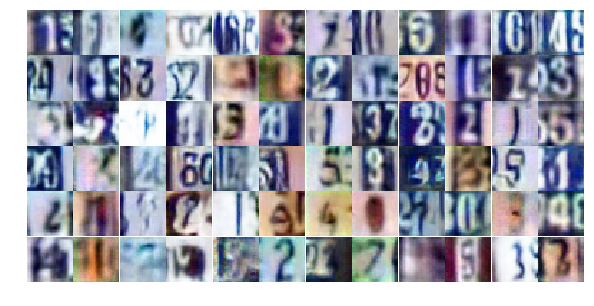

Epoch 17/25... Discriminator Loss: 0.7366... Generator Loss: 0.9545
Epoch 17/25... Discriminator Loss: 0.7136... Generator Loss: 1.2992
Epoch 17/25... Discriminator Loss: 0.5475... Generator Loss: 2.9137
Epoch 17/25... Discriminator Loss: 0.5103... Generator Loss: 1.8462
Epoch 18/25... Discriminator Loss: 1.0776... Generator Loss: 0.6692
Epoch 18/25... Discriminator Loss: 1.3158... Generator Loss: 0.4494
Epoch 18/25... Discriminator Loss: 0.9029... Generator Loss: 0.8182
Epoch 18/25... Discriminator Loss: 0.5436... Generator Loss: 1.4118
Epoch 18/25... Discriminator Loss: 1.1362... Generator Loss: 0.5395
Epoch 18/25... Discriminator Loss: 0.5884... Generator Loss: 1.4080


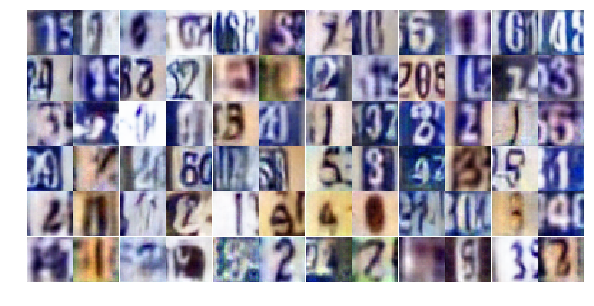

Epoch 18/25... Discriminator Loss: 0.5890... Generator Loss: 1.1941
Epoch 18/25... Discriminator Loss: 1.0486... Generator Loss: 0.5972
Epoch 18/25... Discriminator Loss: 1.1809... Generator Loss: 0.5210
Epoch 18/25... Discriminator Loss: 0.3936... Generator Loss: 1.6900
Epoch 18/25... Discriminator Loss: 0.7996... Generator Loss: 0.8355
Epoch 18/25... Discriminator Loss: 0.8508... Generator Loss: 0.8140
Epoch 18/25... Discriminator Loss: 0.5461... Generator Loss: 1.2857
Epoch 18/25... Discriminator Loss: 0.7701... Generator Loss: 0.8733
Epoch 18/25... Discriminator Loss: 0.5668... Generator Loss: 1.2946
Epoch 18/25... Discriminator Loss: 0.5577... Generator Loss: 1.1191


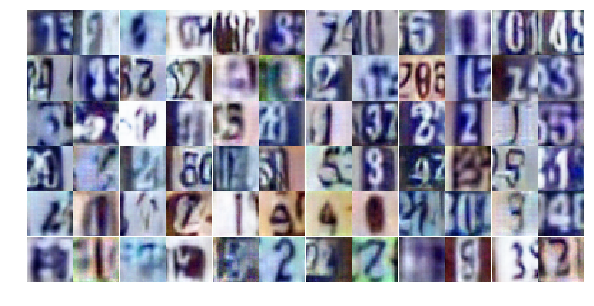

Epoch 18/25... Discriminator Loss: 0.6919... Generator Loss: 1.1671
Epoch 18/25... Discriminator Loss: 0.7509... Generator Loss: 1.0169
Epoch 18/25... Discriminator Loss: 1.1030... Generator Loss: 0.6753
Epoch 18/25... Discriminator Loss: 0.6846... Generator Loss: 1.0063
Epoch 18/25... Discriminator Loss: 0.6236... Generator Loss: 1.1797
Epoch 18/25... Discriminator Loss: 0.7764... Generator Loss: 0.8853
Epoch 18/25... Discriminator Loss: 0.6446... Generator Loss: 1.1853
Epoch 18/25... Discriminator Loss: 0.8992... Generator Loss: 0.7883
Epoch 18/25... Discriminator Loss: 0.7301... Generator Loss: 0.8817
Epoch 18/25... Discriminator Loss: 0.6983... Generator Loss: 0.9352


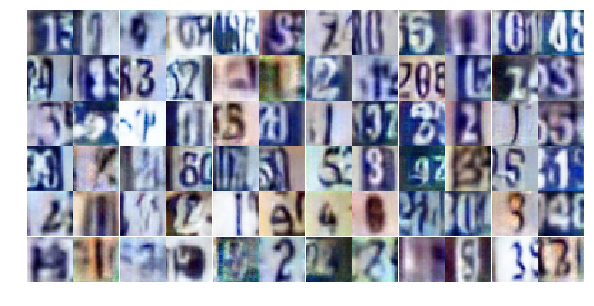

Epoch 18/25... Discriminator Loss: 0.4541... Generator Loss: 1.4653
Epoch 18/25... Discriminator Loss: 0.8694... Generator Loss: 0.8161
Epoch 18/25... Discriminator Loss: 0.4850... Generator Loss: 1.4663
Epoch 18/25... Discriminator Loss: 1.0282... Generator Loss: 0.7831
Epoch 18/25... Discriminator Loss: 1.3229... Generator Loss: 0.4805
Epoch 18/25... Discriminator Loss: 0.5837... Generator Loss: 1.2767
Epoch 18/25... Discriminator Loss: 0.5679... Generator Loss: 1.2741
Epoch 18/25... Discriminator Loss: 0.6203... Generator Loss: 1.2851
Epoch 18/25... Discriminator Loss: 0.5852... Generator Loss: 1.1204
Epoch 18/25... Discriminator Loss: 0.8085... Generator Loss: 0.8401


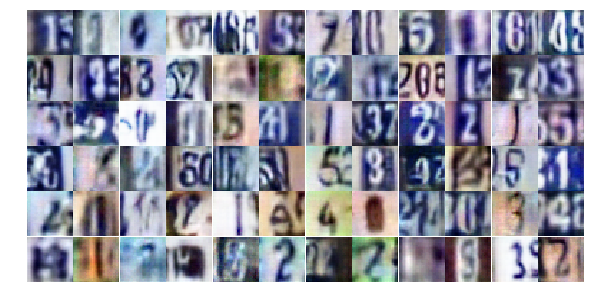

Epoch 18/25... Discriminator Loss: 0.5626... Generator Loss: 1.2670
Epoch 18/25... Discriminator Loss: 0.8067... Generator Loss: 0.8395
Epoch 18/25... Discriminator Loss: 0.5935... Generator Loss: 1.1506
Epoch 18/25... Discriminator Loss: 0.5137... Generator Loss: 1.8609
Epoch 18/25... Discriminator Loss: 0.9113... Generator Loss: 0.7878
Epoch 18/25... Discriminator Loss: 0.5048... Generator Loss: 1.2516
Epoch 18/25... Discriminator Loss: 1.3122... Generator Loss: 0.4208
Epoch 18/25... Discriminator Loss: 3.5466... Generator Loss: 5.1340
Epoch 18/25... Discriminator Loss: 1.9911... Generator Loss: 0.3161
Epoch 18/25... Discriminator Loss: 0.3143... Generator Loss: 1.9293


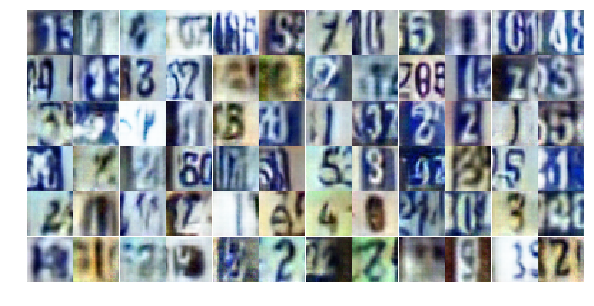

Epoch 18/25... Discriminator Loss: 0.5579... Generator Loss: 1.1865
Epoch 18/25... Discriminator Loss: 0.5888... Generator Loss: 1.2543
Epoch 18/25... Discriminator Loss: 0.8523... Generator Loss: 0.8068
Epoch 18/25... Discriminator Loss: 0.8487... Generator Loss: 0.8325
Epoch 18/25... Discriminator Loss: 0.6152... Generator Loss: 1.2354
Epoch 18/25... Discriminator Loss: 0.6641... Generator Loss: 1.1490
Epoch 18/25... Discriminator Loss: 0.7026... Generator Loss: 1.1979
Epoch 18/25... Discriminator Loss: 1.0267... Generator Loss: 0.6819
Epoch 18/25... Discriminator Loss: 0.9092... Generator Loss: 0.9422
Epoch 18/25... Discriminator Loss: 0.8563... Generator Loss: 0.8814


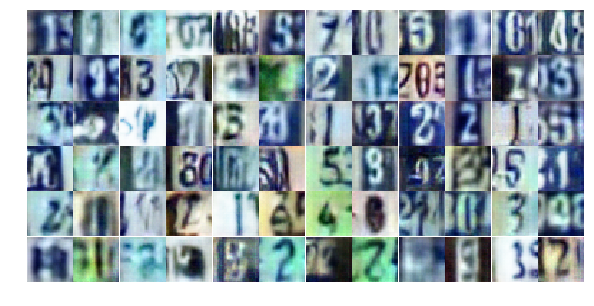

Epoch 18/25... Discriminator Loss: 0.6977... Generator Loss: 1.1953
Epoch 19/25... Discriminator Loss: 0.9080... Generator Loss: 0.7650
Epoch 19/25... Discriminator Loss: 0.9702... Generator Loss: 0.7206
Epoch 19/25... Discriminator Loss: 0.9051... Generator Loss: 1.0521
Epoch 19/25... Discriminator Loss: 0.6502... Generator Loss: 1.1519
Epoch 19/25... Discriminator Loss: 0.9831... Generator Loss: 0.7229
Epoch 19/25... Discriminator Loss: 0.5497... Generator Loss: 1.3963
Epoch 19/25... Discriminator Loss: 0.6532... Generator Loss: 1.1359
Epoch 19/25... Discriminator Loss: 0.5027... Generator Loss: 1.7798
Epoch 19/25... Discriminator Loss: 1.0267... Generator Loss: 0.6295


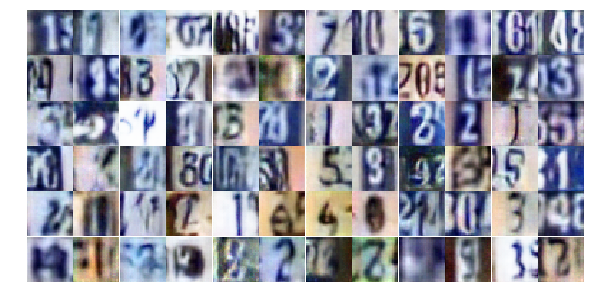

Epoch 19/25... Discriminator Loss: 0.7009... Generator Loss: 0.9849
Epoch 19/25... Discriminator Loss: 0.8468... Generator Loss: 0.8172
Epoch 19/25... Discriminator Loss: 0.9296... Generator Loss: 0.7517
Epoch 19/25... Discriminator Loss: 0.9054... Generator Loss: 0.6895
Epoch 19/25... Discriminator Loss: 0.9054... Generator Loss: 0.7332
Epoch 19/25... Discriminator Loss: 0.7770... Generator Loss: 0.8241
Epoch 19/25... Discriminator Loss: 1.2694... Generator Loss: 0.4442
Epoch 19/25... Discriminator Loss: 0.5635... Generator Loss: 1.2817
Epoch 19/25... Discriminator Loss: 0.6405... Generator Loss: 1.1530
Epoch 19/25... Discriminator Loss: 1.3137... Generator Loss: 0.4375


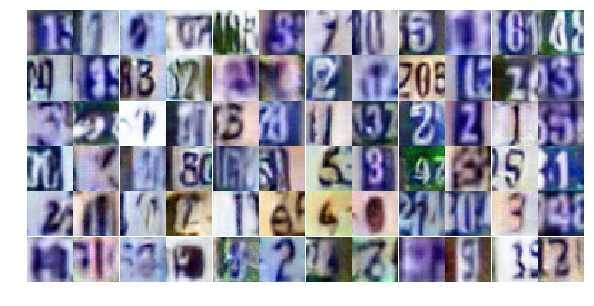

Epoch 19/25... Discriminator Loss: 0.9035... Generator Loss: 0.7604
Epoch 19/25... Discriminator Loss: 1.0485... Generator Loss: 0.6744
Epoch 19/25... Discriminator Loss: 1.5255... Generator Loss: 0.4146
Epoch 19/25... Discriminator Loss: 0.8720... Generator Loss: 0.9490
Epoch 19/25... Discriminator Loss: 0.9251... Generator Loss: 0.7259
Epoch 19/25... Discriminator Loss: 0.7973... Generator Loss: 0.8510
Epoch 19/25... Discriminator Loss: 1.0719... Generator Loss: 0.6193
Epoch 19/25... Discriminator Loss: 0.6631... Generator Loss: 1.0627
Epoch 19/25... Discriminator Loss: 0.8301... Generator Loss: 0.8115
Epoch 19/25... Discriminator Loss: 0.9289... Generator Loss: 0.7710


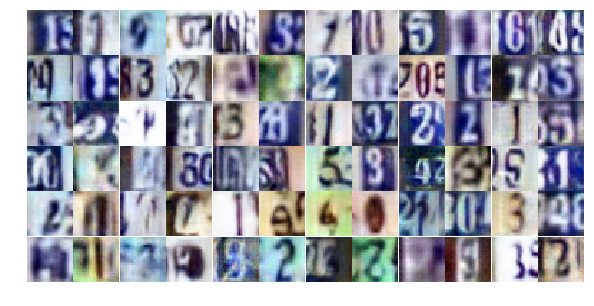

Epoch 19/25... Discriminator Loss: 0.7839... Generator Loss: 1.0343
Epoch 19/25... Discriminator Loss: 0.6401... Generator Loss: 0.9930
Epoch 19/25... Discriminator Loss: 0.8829... Generator Loss: 0.7391
Epoch 19/25... Discriminator Loss: 0.7172... Generator Loss: 0.9087
Epoch 19/25... Discriminator Loss: 0.6975... Generator Loss: 1.0061
Epoch 19/25... Discriminator Loss: 1.5428... Generator Loss: 0.3497
Epoch 19/25... Discriminator Loss: 0.8583... Generator Loss: 2.0318
Epoch 19/25... Discriminator Loss: 0.5427... Generator Loss: 1.3277
Epoch 19/25... Discriminator Loss: 0.8995... Generator Loss: 0.8082
Epoch 19/25... Discriminator Loss: 0.6689... Generator Loss: 0.9344


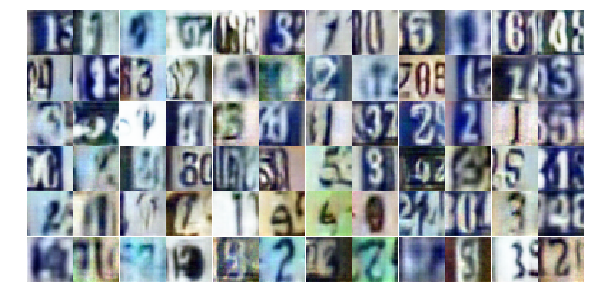

Epoch 19/25... Discriminator Loss: 0.6094... Generator Loss: 1.1145
Epoch 19/25... Discriminator Loss: 0.8035... Generator Loss: 1.0204
Epoch 19/25... Discriminator Loss: 1.2676... Generator Loss: 0.4720
Epoch 19/25... Discriminator Loss: 0.9611... Generator Loss: 0.6784
Epoch 19/25... Discriminator Loss: 0.8948... Generator Loss: 1.0908
Epoch 19/25... Discriminator Loss: 1.4358... Generator Loss: 0.4040
Epoch 19/25... Discriminator Loss: 0.5179... Generator Loss: 1.4526
Epoch 19/25... Discriminator Loss: 0.4566... Generator Loss: 1.5625
Epoch 19/25... Discriminator Loss: 0.5894... Generator Loss: 1.3345
Epoch 19/25... Discriminator Loss: 1.1700... Generator Loss: 0.5155


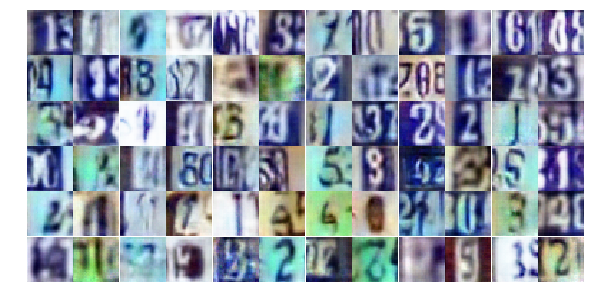

Epoch 19/25... Discriminator Loss: 1.4793... Generator Loss: 0.3908
Epoch 19/25... Discriminator Loss: 0.6201... Generator Loss: 1.1230
Epoch 19/25... Discriminator Loss: 0.5360... Generator Loss: 1.7980
Epoch 19/25... Discriminator Loss: 1.8120... Generator Loss: 0.2649
Epoch 19/25... Discriminator Loss: 1.9723... Generator Loss: 4.3129
Epoch 19/25... Discriminator Loss: 0.6390... Generator Loss: 1.2240
Epoch 19/25... Discriminator Loss: 1.7310... Generator Loss: 0.2742
Epoch 19/25... Discriminator Loss: 0.6636... Generator Loss: 1.2519
Epoch 20/25... Discriminator Loss: 0.7256... Generator Loss: 1.1081
Epoch 20/25... Discriminator Loss: 0.7209... Generator Loss: 1.0956


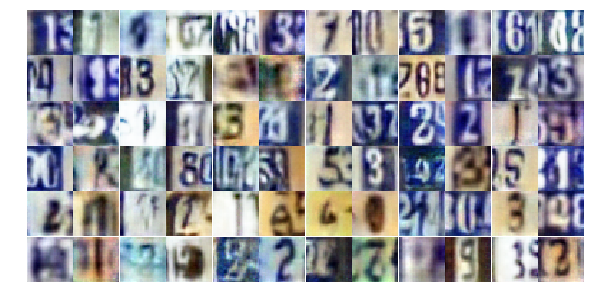

Epoch 20/25... Discriminator Loss: 0.7571... Generator Loss: 0.8375
Epoch 20/25... Discriminator Loss: 1.0272... Generator Loss: 0.6797
Epoch 20/25... Discriminator Loss: 0.8204... Generator Loss: 0.7850
Epoch 20/25... Discriminator Loss: 0.7749... Generator Loss: 0.8458
Epoch 20/25... Discriminator Loss: 0.6615... Generator Loss: 1.0310
Epoch 20/25... Discriminator Loss: 0.7330... Generator Loss: 0.9783
Epoch 20/25... Discriminator Loss: 0.8097... Generator Loss: 0.8929
Epoch 20/25... Discriminator Loss: 0.5264... Generator Loss: 2.0559
Epoch 20/25... Discriminator Loss: 1.2119... Generator Loss: 0.5217
Epoch 20/25... Discriminator Loss: 0.6846... Generator Loss: 0.9738


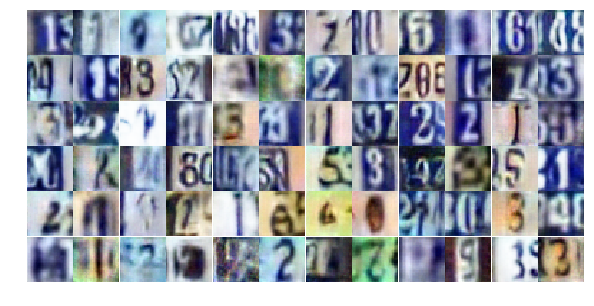

Epoch 20/25... Discriminator Loss: 1.2776... Generator Loss: 0.5259
Epoch 20/25... Discriminator Loss: 0.8007... Generator Loss: 0.9261
Epoch 20/25... Discriminator Loss: 0.8733... Generator Loss: 0.9040
Epoch 20/25... Discriminator Loss: 0.5612... Generator Loss: 1.2736
Epoch 20/25... Discriminator Loss: 0.9179... Generator Loss: 0.7309
Epoch 20/25... Discriminator Loss: 0.7830... Generator Loss: 0.9306
Epoch 20/25... Discriminator Loss: 1.3630... Generator Loss: 0.4065
Epoch 20/25... Discriminator Loss: 0.6918... Generator Loss: 1.0115
Epoch 20/25... Discriminator Loss: 0.7815... Generator Loss: 0.8706
Epoch 20/25... Discriminator Loss: 1.3213... Generator Loss: 0.4666


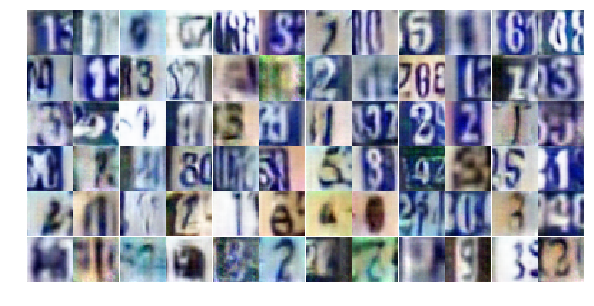

Epoch 20/25... Discriminator Loss: 0.7750... Generator Loss: 0.8088
Epoch 20/25... Discriminator Loss: 0.4915... Generator Loss: 1.5300
Epoch 20/25... Discriminator Loss: 0.4188... Generator Loss: 1.4918
Epoch 20/25... Discriminator Loss: 1.3206... Generator Loss: 0.4492
Epoch 20/25... Discriminator Loss: 1.7717... Generator Loss: 0.3256
Epoch 20/25... Discriminator Loss: 0.5796... Generator Loss: 1.1949
Epoch 20/25... Discriminator Loss: 0.6195... Generator Loss: 1.8977
Epoch 20/25... Discriminator Loss: 1.4974... Generator Loss: 0.3409
Epoch 20/25... Discriminator Loss: 1.1361... Generator Loss: 0.6246
Epoch 20/25... Discriminator Loss: 0.5704... Generator Loss: 1.0804


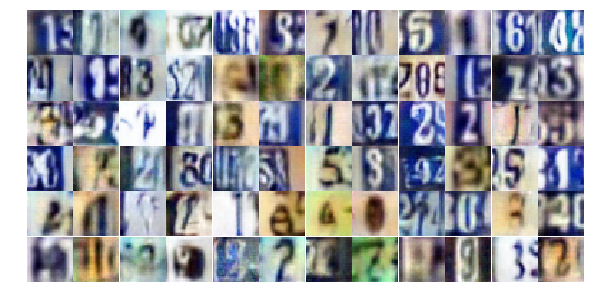

Epoch 20/25... Discriminator Loss: 0.6089... Generator Loss: 1.5504
Epoch 20/25... Discriminator Loss: 0.6376... Generator Loss: 1.0290
Epoch 20/25... Discriminator Loss: 0.9742... Generator Loss: 0.7251
Epoch 20/25... Discriminator Loss: 0.7051... Generator Loss: 1.0599
Epoch 20/25... Discriminator Loss: 0.5992... Generator Loss: 1.2448
Epoch 20/25... Discriminator Loss: 0.6347... Generator Loss: 1.0638
Epoch 20/25... Discriminator Loss: 0.7556... Generator Loss: 1.1654
Epoch 20/25... Discriminator Loss: 0.8702... Generator Loss: 0.7699
Epoch 20/25... Discriminator Loss: 0.6678... Generator Loss: 1.9408
Epoch 20/25... Discriminator Loss: 1.3704... Generator Loss: 0.4203


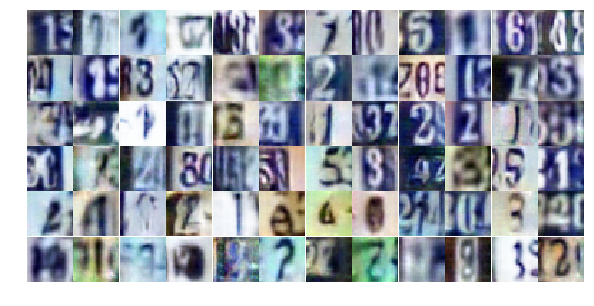

Epoch 20/25... Discriminator Loss: 1.4229... Generator Loss: 0.4051
Epoch 20/25... Discriminator Loss: 1.3075... Generator Loss: 0.4754
Epoch 20/25... Discriminator Loss: 1.8087... Generator Loss: 0.3018
Epoch 20/25... Discriminator Loss: 0.9516... Generator Loss: 0.8083
Epoch 20/25... Discriminator Loss: 0.8035... Generator Loss: 0.9109
Epoch 20/25... Discriminator Loss: 1.0430... Generator Loss: 0.6560
Epoch 20/25... Discriminator Loss: 1.1104... Generator Loss: 0.5568
Epoch 20/25... Discriminator Loss: 0.5361... Generator Loss: 1.3653
Epoch 20/25... Discriminator Loss: 0.6069... Generator Loss: 1.6175
Epoch 20/25... Discriminator Loss: 0.9441... Generator Loss: 0.7262


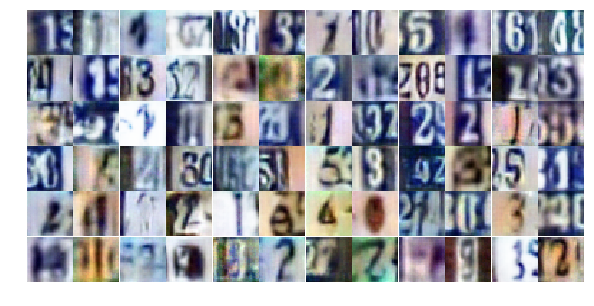

Epoch 20/25... Discriminator Loss: 0.5187... Generator Loss: 1.6508
Epoch 20/25... Discriminator Loss: 0.5868... Generator Loss: 1.4639
Epoch 20/25... Discriminator Loss: 0.5168... Generator Loss: 1.6117
Epoch 20/25... Discriminator Loss: 1.1410... Generator Loss: 0.5642
Epoch 20/25... Discriminator Loss: 0.6511... Generator Loss: 1.0260
Epoch 20/25... Discriminator Loss: 0.7314... Generator Loss: 1.0123
Epoch 21/25... Discriminator Loss: 0.7871... Generator Loss: 0.9376
Epoch 21/25... Discriminator Loss: 0.8584... Generator Loss: 0.7664
Epoch 21/25... Discriminator Loss: 1.8706... Generator Loss: 0.2596
Epoch 21/25... Discriminator Loss: 1.5713... Generator Loss: 0.4718


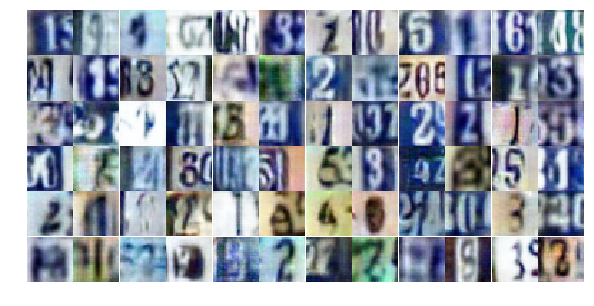

Epoch 21/25... Discriminator Loss: 0.8016... Generator Loss: 1.1240
Epoch 21/25... Discriminator Loss: 1.6817... Generator Loss: 0.3522
Epoch 21/25... Discriminator Loss: 0.4577... Generator Loss: 1.4902
Epoch 21/25... Discriminator Loss: 0.5034... Generator Loss: 1.4144
Epoch 21/25... Discriminator Loss: 1.0879... Generator Loss: 0.5794
Epoch 21/25... Discriminator Loss: 0.7794... Generator Loss: 0.8856
Epoch 21/25... Discriminator Loss: 0.8492... Generator Loss: 0.7803
Epoch 21/25... Discriminator Loss: 1.1531... Generator Loss: 0.6105
Epoch 21/25... Discriminator Loss: 0.7816... Generator Loss: 0.9011
Epoch 21/25... Discriminator Loss: 1.0260... Generator Loss: 0.6211


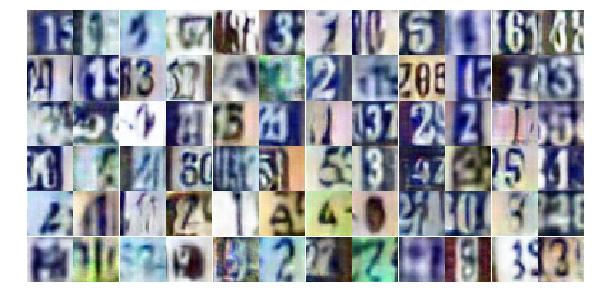

Epoch 21/25... Discriminator Loss: 0.2948... Generator Loss: 2.1681
Epoch 21/25... Discriminator Loss: 0.8444... Generator Loss: 0.8693
Epoch 21/25... Discriminator Loss: 1.3216... Generator Loss: 0.6596
Epoch 21/25... Discriminator Loss: 2.2384... Generator Loss: 0.2521
Epoch 21/25... Discriminator Loss: 1.6825... Generator Loss: 0.3982
Epoch 21/25... Discriminator Loss: 1.9290... Generator Loss: 0.2646
Epoch 21/25... Discriminator Loss: 1.0684... Generator Loss: 0.6885
Epoch 21/25... Discriminator Loss: 0.4551... Generator Loss: 1.5544
Epoch 21/25... Discriminator Loss: 0.5906... Generator Loss: 1.2197
Epoch 21/25... Discriminator Loss: 0.8234... Generator Loss: 0.8801


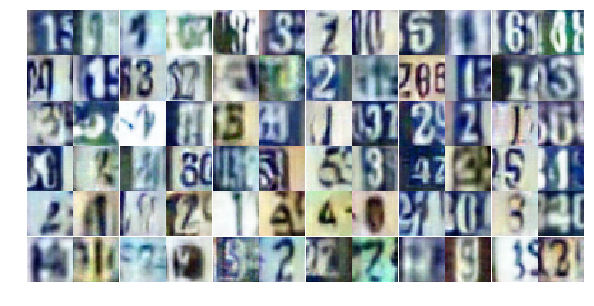

Epoch 21/25... Discriminator Loss: 1.3373... Generator Loss: 0.4162
Epoch 21/25... Discriminator Loss: 0.4603... Generator Loss: 1.4619
Epoch 21/25... Discriminator Loss: 0.7798... Generator Loss: 0.9543
Epoch 21/25... Discriminator Loss: 0.8210... Generator Loss: 0.8130
Epoch 21/25... Discriminator Loss: 0.9545... Generator Loss: 0.7241
Epoch 21/25... Discriminator Loss: 0.8967... Generator Loss: 0.7787
Epoch 21/25... Discriminator Loss: 0.7356... Generator Loss: 0.9448
Epoch 21/25... Discriminator Loss: 0.8815... Generator Loss: 0.8092
Epoch 21/25... Discriminator Loss: 0.6881... Generator Loss: 1.0508
Epoch 21/25... Discriminator Loss: 1.6126... Generator Loss: 0.3605


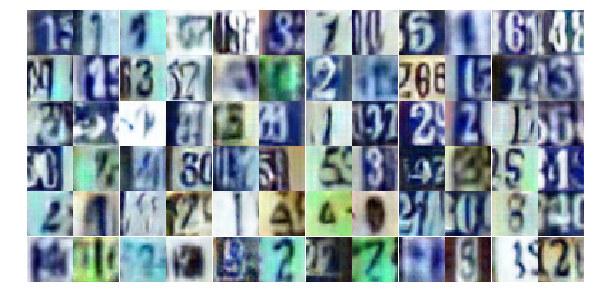

Epoch 21/25... Discriminator Loss: 1.2589... Generator Loss: 0.4967
Epoch 21/25... Discriminator Loss: 0.7309... Generator Loss: 0.9163
Epoch 21/25... Discriminator Loss: 1.3548... Generator Loss: 0.4081
Epoch 21/25... Discriminator Loss: 0.7069... Generator Loss: 0.9505
Epoch 21/25... Discriminator Loss: 0.6046... Generator Loss: 1.0565
Epoch 21/25... Discriminator Loss: 0.9384... Generator Loss: 0.6585
Epoch 21/25... Discriminator Loss: 1.0956... Generator Loss: 0.6121
Epoch 21/25... Discriminator Loss: 1.2195... Generator Loss: 0.5162
Epoch 21/25... Discriminator Loss: 0.9195... Generator Loss: 0.7703
Epoch 21/25... Discriminator Loss: 0.2399... Generator Loss: 3.1584


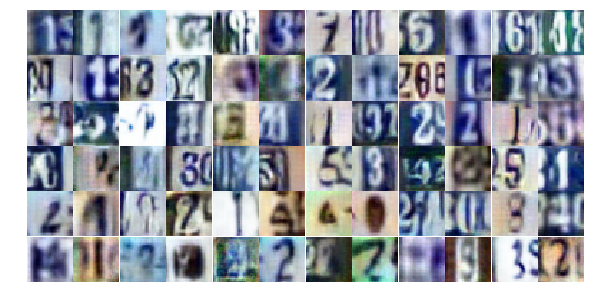

Epoch 21/25... Discriminator Loss: 0.5998... Generator Loss: 1.1077
Epoch 21/25... Discriminator Loss: 0.7101... Generator Loss: 1.0856
Epoch 21/25... Discriminator Loss: 0.4768... Generator Loss: 1.6292
Epoch 21/25... Discriminator Loss: 0.9410... Generator Loss: 0.7646
Epoch 21/25... Discriminator Loss: 0.3860... Generator Loss: 1.8250
Epoch 21/25... Discriminator Loss: 1.0561... Generator Loss: 0.6648
Epoch 21/25... Discriminator Loss: 1.3695... Generator Loss: 0.4626
Epoch 21/25... Discriminator Loss: 1.0975... Generator Loss: 0.5326
Epoch 21/25... Discriminator Loss: 0.8884... Generator Loss: 0.7569
Epoch 21/25... Discriminator Loss: 0.4963... Generator Loss: 1.4200


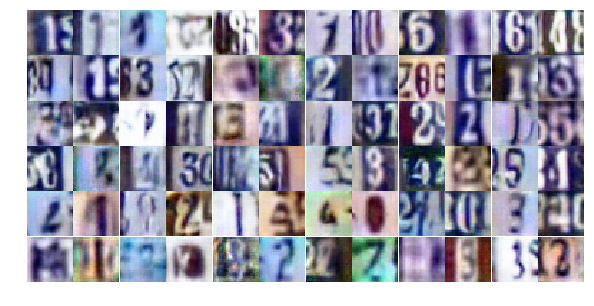

Epoch 21/25... Discriminator Loss: 0.4778... Generator Loss: 1.5385
Epoch 21/25... Discriminator Loss: 1.5357... Generator Loss: 0.3483
Epoch 21/25... Discriminator Loss: 1.3621... Generator Loss: 0.5040
Epoch 22/25... Discriminator Loss: 0.9066... Generator Loss: 0.7558
Epoch 22/25... Discriminator Loss: 0.7577... Generator Loss: 1.0605
Epoch 22/25... Discriminator Loss: 0.9713... Generator Loss: 0.7226
Epoch 22/25... Discriminator Loss: 0.5605... Generator Loss: 1.2649
Epoch 22/25... Discriminator Loss: 0.3962... Generator Loss: 1.9274
Epoch 22/25... Discriminator Loss: 1.0839... Generator Loss: 0.6247
Epoch 22/25... Discriminator Loss: 0.6450... Generator Loss: 1.2576


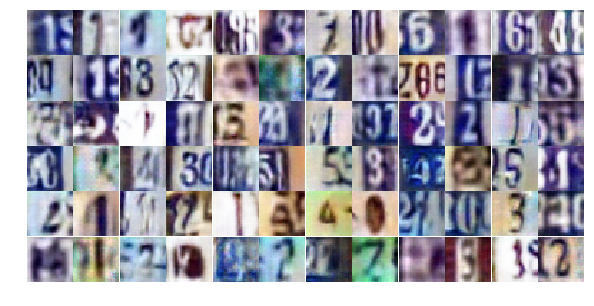

Epoch 22/25... Discriminator Loss: 0.6883... Generator Loss: 1.1235
Epoch 22/25... Discriminator Loss: 0.6497... Generator Loss: 1.3660
Epoch 22/25... Discriminator Loss: 1.4840... Generator Loss: 0.4377
Epoch 22/25... Discriminator Loss: 0.7895... Generator Loss: 0.8484
Epoch 22/25... Discriminator Loss: 1.1499... Generator Loss: 0.6356
Epoch 22/25... Discriminator Loss: 0.7892... Generator Loss: 0.8834
Epoch 22/25... Discriminator Loss: 0.7693... Generator Loss: 1.1033
Epoch 22/25... Discriminator Loss: 0.6088... Generator Loss: 1.0905
Epoch 22/25... Discriminator Loss: 0.8894... Generator Loss: 0.7548
Epoch 22/25... Discriminator Loss: 1.5630... Generator Loss: 0.3680


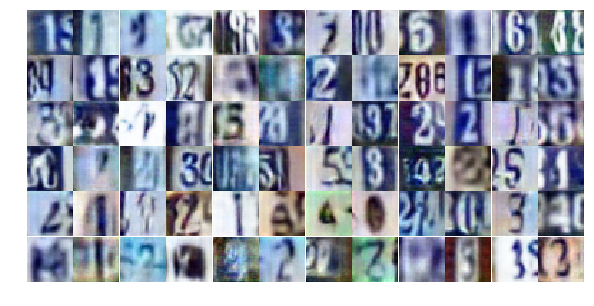

Epoch 22/25... Discriminator Loss: 0.5074... Generator Loss: 1.6916
Epoch 22/25... Discriminator Loss: 0.6952... Generator Loss: 1.0831
Epoch 22/25... Discriminator Loss: 0.9470... Generator Loss: 0.6885
Epoch 22/25... Discriminator Loss: 0.4181... Generator Loss: 1.6415
Epoch 22/25... Discriminator Loss: 0.3748... Generator Loss: 2.1662
Epoch 22/25... Discriminator Loss: 1.5797... Generator Loss: 3.6579
Epoch 22/25... Discriminator Loss: 1.0380... Generator Loss: 2.9871
Epoch 22/25... Discriminator Loss: 0.4551... Generator Loss: 1.5153
Epoch 22/25... Discriminator Loss: 0.5719... Generator Loss: 1.2768
Epoch 22/25... Discriminator Loss: 1.1507... Generator Loss: 0.5742


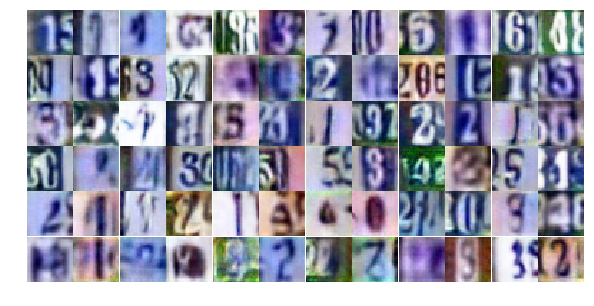

Epoch 22/25... Discriminator Loss: 0.4152... Generator Loss: 2.1489
Epoch 22/25... Discriminator Loss: 0.4902... Generator Loss: 1.4901
Epoch 22/25... Discriminator Loss: 1.1570... Generator Loss: 0.5371
Epoch 22/25... Discriminator Loss: 0.8187... Generator Loss: 0.8039
Epoch 22/25... Discriminator Loss: 0.7229... Generator Loss: 1.4336
Epoch 22/25... Discriminator Loss: 0.6946... Generator Loss: 1.2100
Epoch 22/25... Discriminator Loss: 1.5289... Generator Loss: 0.3649
Epoch 22/25... Discriminator Loss: 0.6239... Generator Loss: 1.4427
Epoch 22/25... Discriminator Loss: 0.7768... Generator Loss: 0.9875
Epoch 22/25... Discriminator Loss: 0.7162... Generator Loss: 1.0487


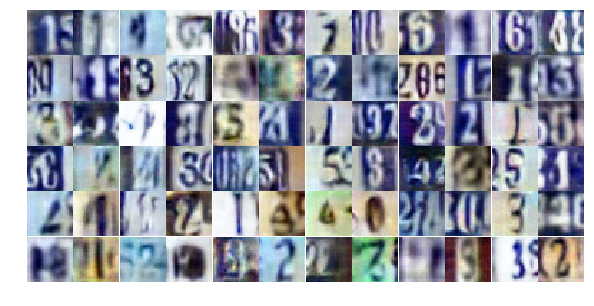

Epoch 22/25... Discriminator Loss: 0.7632... Generator Loss: 0.9882
Epoch 22/25... Discriminator Loss: 0.5075... Generator Loss: 1.3317
Epoch 22/25... Discriminator Loss: 0.4725... Generator Loss: 1.3233
Epoch 22/25... Discriminator Loss: 0.8817... Generator Loss: 0.7569
Epoch 22/25... Discriminator Loss: 0.4457... Generator Loss: 1.6157
Epoch 22/25... Discriminator Loss: 0.4736... Generator Loss: 1.2758
Epoch 22/25... Discriminator Loss: 0.6097... Generator Loss: 1.6307
Epoch 22/25... Discriminator Loss: 1.3276... Generator Loss: 0.4650
Epoch 22/25... Discriminator Loss: 1.2172... Generator Loss: 0.5983
Epoch 22/25... Discriminator Loss: 0.7569... Generator Loss: 1.0329


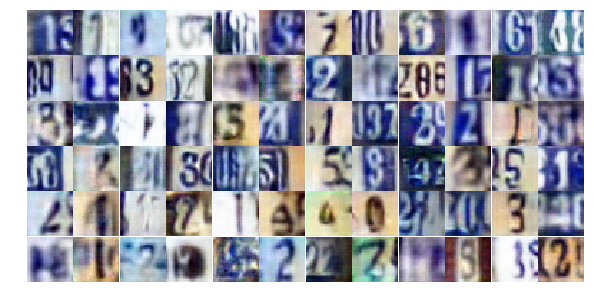

Epoch 22/25... Discriminator Loss: 0.8121... Generator Loss: 0.9767
Epoch 22/25... Discriminator Loss: 0.5471... Generator Loss: 1.2519
Epoch 22/25... Discriminator Loss: 1.2339... Generator Loss: 0.5099
Epoch 22/25... Discriminator Loss: 0.7658... Generator Loss: 1.1701
Epoch 22/25... Discriminator Loss: 0.8436... Generator Loss: 0.7781
Epoch 22/25... Discriminator Loss: 1.8566... Generator Loss: 0.2392
Epoch 22/25... Discriminator Loss: 0.8710... Generator Loss: 0.8664
Epoch 22/25... Discriminator Loss: 0.5631... Generator Loss: 1.3954
Epoch 22/25... Discriminator Loss: 1.3432... Generator Loss: 2.5329
Epoch 22/25... Discriminator Loss: 0.9266... Generator Loss: 0.8281


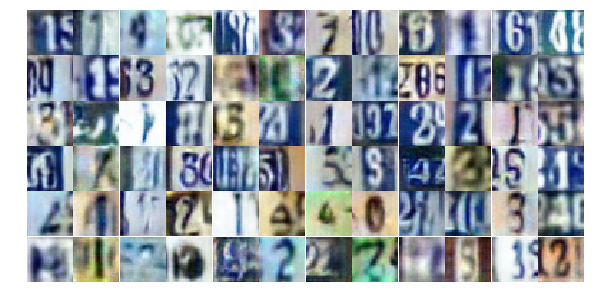

Epoch 23/25... Discriminator Loss: 0.6089... Generator Loss: 1.2667
Epoch 23/25... Discriminator Loss: 0.4723... Generator Loss: 1.3577
Epoch 23/25... Discriminator Loss: 1.0306... Generator Loss: 0.6068
Epoch 23/25... Discriminator Loss: 0.6755... Generator Loss: 1.0409
Epoch 23/25... Discriminator Loss: 0.5449... Generator Loss: 1.9576
Epoch 23/25... Discriminator Loss: 2.0568... Generator Loss: 0.2080
Epoch 23/25... Discriminator Loss: 1.0149... Generator Loss: 0.6579
Epoch 23/25... Discriminator Loss: 0.5790... Generator Loss: 1.3196
Epoch 23/25... Discriminator Loss: 0.6268... Generator Loss: 1.2106
Epoch 23/25... Discriminator Loss: 0.3103... Generator Loss: 2.1877


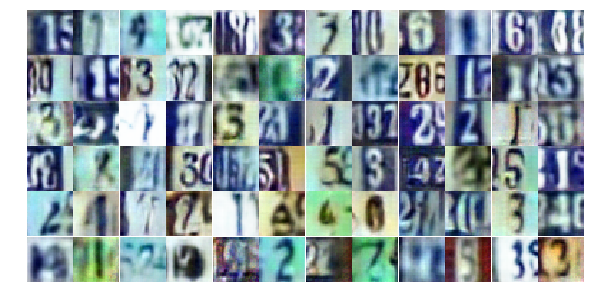

Epoch 23/25... Discriminator Loss: 0.4432... Generator Loss: 1.4931
Epoch 23/25... Discriminator Loss: 0.7872... Generator Loss: 0.7854
Epoch 23/25... Discriminator Loss: 0.5385... Generator Loss: 1.5203
Epoch 23/25... Discriminator Loss: 0.7528... Generator Loss: 1.0666
Epoch 23/25... Discriminator Loss: 0.2999... Generator Loss: 2.1926
Epoch 23/25... Discriminator Loss: 1.0286... Generator Loss: 0.6830
Epoch 23/25... Discriminator Loss: 0.9508... Generator Loss: 0.7081
Epoch 23/25... Discriminator Loss: 0.5871... Generator Loss: 1.4656
Epoch 23/25... Discriminator Loss: 0.6554... Generator Loss: 1.5183
Epoch 23/25... Discriminator Loss: 0.8975... Generator Loss: 0.7585


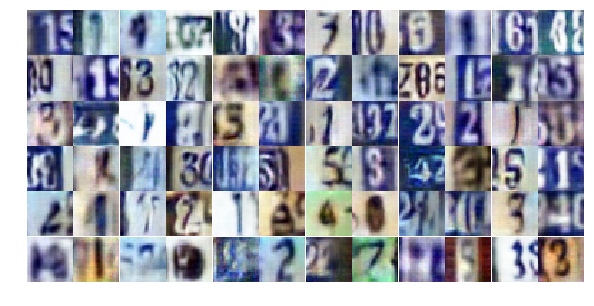

Epoch 23/25... Discriminator Loss: 1.9438... Generator Loss: 0.2651
Epoch 23/25... Discriminator Loss: 0.6749... Generator Loss: 2.9581
Epoch 23/25... Discriminator Loss: 1.2598... Generator Loss: 0.6760
Epoch 23/25... Discriminator Loss: 0.9240... Generator Loss: 0.7028
Epoch 23/25... Discriminator Loss: 0.7621... Generator Loss: 0.9325
Epoch 23/25... Discriminator Loss: 0.7078... Generator Loss: 1.0439
Epoch 23/25... Discriminator Loss: 0.6773... Generator Loss: 1.2439
Epoch 23/25... Discriminator Loss: 0.8423... Generator Loss: 0.8454
Epoch 23/25... Discriminator Loss: 0.6540... Generator Loss: 1.0690
Epoch 23/25... Discriminator Loss: 0.7117... Generator Loss: 1.4770


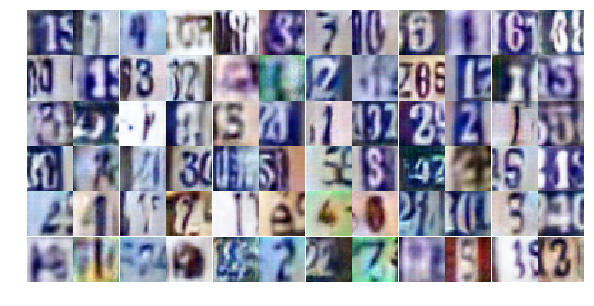

Epoch 23/25... Discriminator Loss: 0.5938... Generator Loss: 1.0923
Epoch 23/25... Discriminator Loss: 0.6735... Generator Loss: 1.1754
Epoch 23/25... Discriminator Loss: 0.6644... Generator Loss: 1.6497
Epoch 23/25... Discriminator Loss: 1.0051... Generator Loss: 0.6473
Epoch 23/25... Discriminator Loss: 1.0041... Generator Loss: 0.6922
Epoch 23/25... Discriminator Loss: 1.0808... Generator Loss: 0.6260
Epoch 23/25... Discriminator Loss: 0.9544... Generator Loss: 0.7813
Epoch 23/25... Discriminator Loss: 1.0561... Generator Loss: 0.5851
Epoch 23/25... Discriminator Loss: 0.6039... Generator Loss: 1.5610
Epoch 23/25... Discriminator Loss: 0.7100... Generator Loss: 0.9769


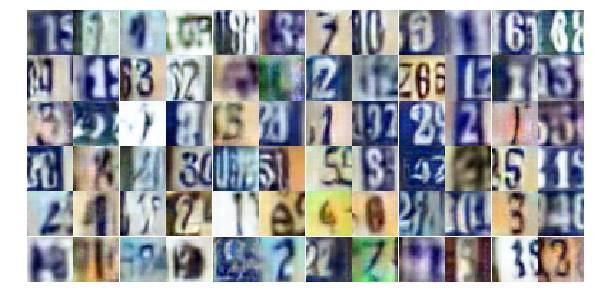

Epoch 23/25... Discriminator Loss: 1.9517... Generator Loss: 0.2882
Epoch 23/25... Discriminator Loss: 0.6953... Generator Loss: 1.0420
Epoch 23/25... Discriminator Loss: 0.8038... Generator Loss: 0.8873
Epoch 23/25... Discriminator Loss: 0.6733... Generator Loss: 1.0725
Epoch 23/25... Discriminator Loss: 1.1580... Generator Loss: 0.5799
Epoch 23/25... Discriminator Loss: 0.8089... Generator Loss: 0.8527
Epoch 23/25... Discriminator Loss: 0.8558... Generator Loss: 0.8016
Epoch 23/25... Discriminator Loss: 0.9955... Generator Loss: 0.7598
Epoch 23/25... Discriminator Loss: 0.7439... Generator Loss: 1.0304
Epoch 23/25... Discriminator Loss: 0.5063... Generator Loss: 1.5689


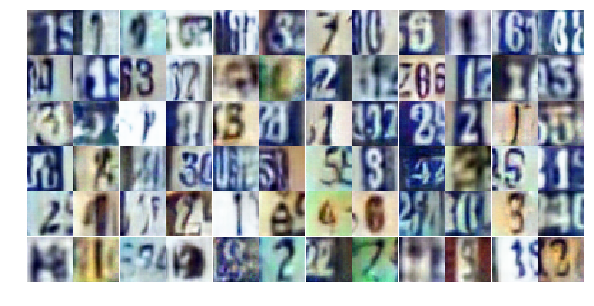

Epoch 23/25... Discriminator Loss: 0.7886... Generator Loss: 0.9723
Epoch 23/25... Discriminator Loss: 1.3991... Generator Loss: 0.4838
Epoch 23/25... Discriminator Loss: 1.0559... Generator Loss: 0.6521
Epoch 23/25... Discriminator Loss: 0.3143... Generator Loss: 2.1895
Epoch 23/25... Discriminator Loss: 1.1429... Generator Loss: 0.6267
Epoch 23/25... Discriminator Loss: 0.5994... Generator Loss: 1.4643
Epoch 23/25... Discriminator Loss: 2.0124... Generator Loss: 0.3055
Epoch 24/25... Discriminator Loss: 0.5342... Generator Loss: 1.3895
Epoch 24/25... Discriminator Loss: 0.6617... Generator Loss: 1.1983
Epoch 24/25... Discriminator Loss: 1.0270... Generator Loss: 0.6615


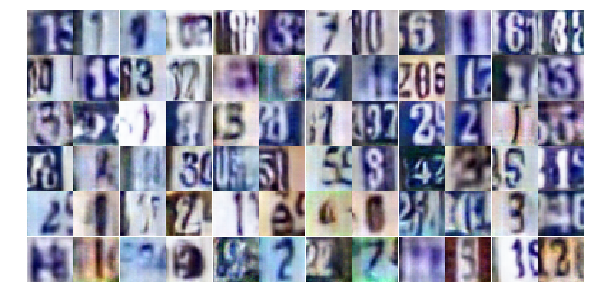

Epoch 24/25... Discriminator Loss: 0.6791... Generator Loss: 1.3716
Epoch 24/25... Discriminator Loss: 0.6522... Generator Loss: 1.1134
Epoch 24/25... Discriminator Loss: 0.7510... Generator Loss: 0.9002
Epoch 24/25... Discriminator Loss: 1.2310... Generator Loss: 2.9744
Epoch 24/25... Discriminator Loss: 0.9600... Generator Loss: 0.6813
Epoch 24/25... Discriminator Loss: 0.4906... Generator Loss: 1.5514
Epoch 24/25... Discriminator Loss: 0.8746... Generator Loss: 0.9009
Epoch 24/25... Discriminator Loss: 1.1406... Generator Loss: 0.5316
Epoch 24/25... Discriminator Loss: 0.4059... Generator Loss: 1.4086
Epoch 24/25... Discriminator Loss: 0.3866... Generator Loss: 1.6758


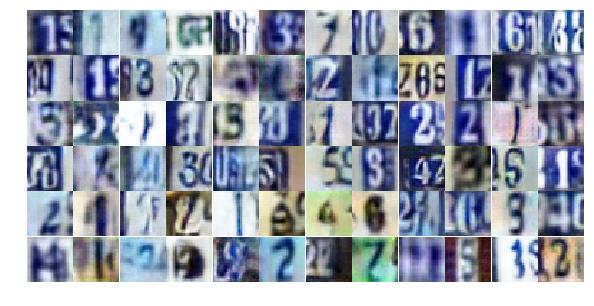

Epoch 24/25... Discriminator Loss: 1.1074... Generator Loss: 0.6489
Epoch 24/25... Discriminator Loss: 1.3145... Generator Loss: 0.4586
Epoch 24/25... Discriminator Loss: 1.0200... Generator Loss: 0.6444
Epoch 24/25... Discriminator Loss: 0.6955... Generator Loss: 1.0163
Epoch 24/25... Discriminator Loss: 0.7496... Generator Loss: 1.8711
Epoch 24/25... Discriminator Loss: 1.0210... Generator Loss: 0.7569
Epoch 24/25... Discriminator Loss: 0.5637... Generator Loss: 1.2453
Epoch 24/25... Discriminator Loss: 1.2547... Generator Loss: 0.5073
Epoch 24/25... Discriminator Loss: 0.5684... Generator Loss: 1.4798
Epoch 24/25... Discriminator Loss: 1.0652... Generator Loss: 0.7349


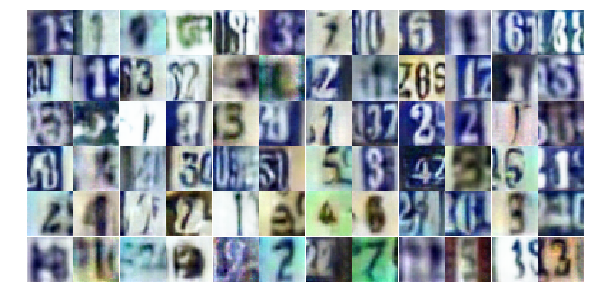

Epoch 24/25... Discriminator Loss: 1.5476... Generator Loss: 0.5273
Epoch 24/25... Discriminator Loss: 0.7508... Generator Loss: 1.0118
Epoch 24/25... Discriminator Loss: 0.5682... Generator Loss: 1.3088
Epoch 24/25... Discriminator Loss: 1.3116... Generator Loss: 0.4826
Epoch 24/25... Discriminator Loss: 0.6194... Generator Loss: 1.1377
Epoch 24/25... Discriminator Loss: 0.6515... Generator Loss: 1.2234
Epoch 24/25... Discriminator Loss: 0.5418... Generator Loss: 1.3312
Epoch 24/25... Discriminator Loss: 0.7533... Generator Loss: 0.9480
Epoch 24/25... Discriminator Loss: 0.5825... Generator Loss: 1.2088
Epoch 24/25... Discriminator Loss: 0.7164... Generator Loss: 1.0034


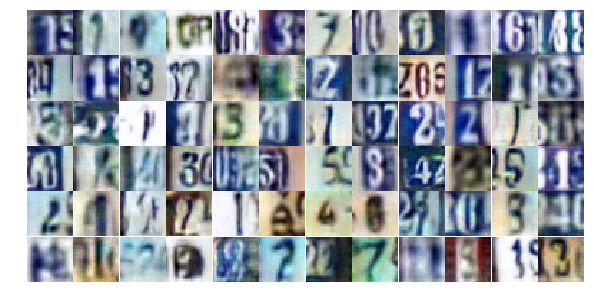

Epoch 24/25... Discriminator Loss: 0.6578... Generator Loss: 1.0282
Epoch 24/25... Discriminator Loss: 0.6934... Generator Loss: 1.0191
Epoch 24/25... Discriminator Loss: 0.8564... Generator Loss: 1.0449
Epoch 24/25... Discriminator Loss: 1.7141... Generator Loss: 0.3413
Epoch 24/25... Discriminator Loss: 1.1000... Generator Loss: 0.5845
Epoch 24/25... Discriminator Loss: 1.1664... Generator Loss: 0.5413
Epoch 24/25... Discriminator Loss: 1.1291... Generator Loss: 0.5847
Epoch 24/25... Discriminator Loss: 0.9214... Generator Loss: 0.7959
Epoch 24/25... Discriminator Loss: 0.6454... Generator Loss: 1.2647
Epoch 24/25... Discriminator Loss: 1.6046... Generator Loss: 4.4593


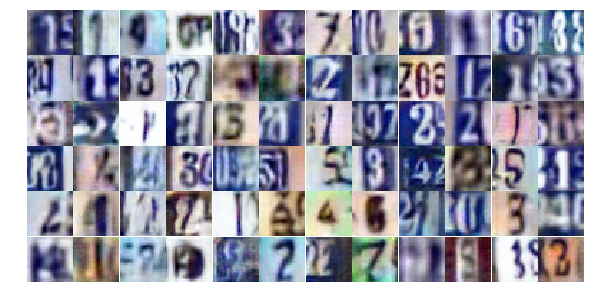

Epoch 24/25... Discriminator Loss: 1.1125... Generator Loss: 0.7015
Epoch 24/25... Discriminator Loss: 1.7097... Generator Loss: 0.4893
Epoch 24/25... Discriminator Loss: 1.2324... Generator Loss: 0.5027
Epoch 24/25... Discriminator Loss: 1.6684... Generator Loss: 0.3269
Epoch 24/25... Discriminator Loss: 1.4649... Generator Loss: 0.4444
Epoch 24/25... Discriminator Loss: 0.7594... Generator Loss: 0.9533
Epoch 24/25... Discriminator Loss: 1.4237... Generator Loss: 0.4411
Epoch 24/25... Discriminator Loss: 0.5820... Generator Loss: 1.0658
Epoch 24/25... Discriminator Loss: 0.7327... Generator Loss: 0.9896
Epoch 24/25... Discriminator Loss: 0.7493... Generator Loss: 0.9267


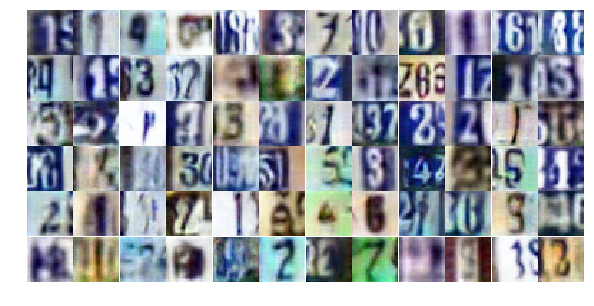

Epoch 24/25... Discriminator Loss: 1.0450... Generator Loss: 0.6163
Epoch 24/25... Discriminator Loss: 1.0339... Generator Loss: 0.6990
Epoch 24/25... Discriminator Loss: 0.9148... Generator Loss: 0.8075
Epoch 24/25... Discriminator Loss: 0.8850... Generator Loss: 0.8432
Epoch 24/25... Discriminator Loss: 1.1593... Generator Loss: 0.5509
Epoch 25/25... Discriminator Loss: 1.0662... Generator Loss: 0.6876
Epoch 25/25... Discriminator Loss: 0.7173... Generator Loss: 1.0393
Epoch 25/25... Discriminator Loss: 0.8238... Generator Loss: 0.8634
Epoch 25/25... Discriminator Loss: 1.0675... Generator Loss: 0.6232
Epoch 25/25... Discriminator Loss: 0.7907... Generator Loss: 0.8339


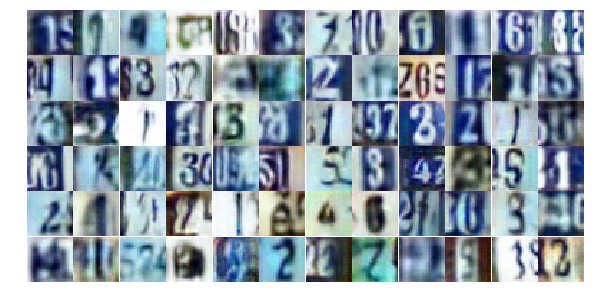

Epoch 25/25... Discriminator Loss: 1.1758... Generator Loss: 0.5315
Epoch 25/25... Discriminator Loss: 0.8380... Generator Loss: 1.4120
Epoch 25/25... Discriminator Loss: 0.9648... Generator Loss: 0.6489
Epoch 25/25... Discriminator Loss: 1.0582... Generator Loss: 2.4994
Epoch 25/25... Discriminator Loss: 1.2422... Generator Loss: 3.6019
Epoch 25/25... Discriminator Loss: 0.8331... Generator Loss: 0.9810
Epoch 25/25... Discriminator Loss: 0.9977... Generator Loss: 0.6749
Epoch 25/25... Discriminator Loss: 1.1829... Generator Loss: 0.6173
Epoch 25/25... Discriminator Loss: 0.4049... Generator Loss: 1.7345
Epoch 25/25... Discriminator Loss: 0.8007... Generator Loss: 0.9036


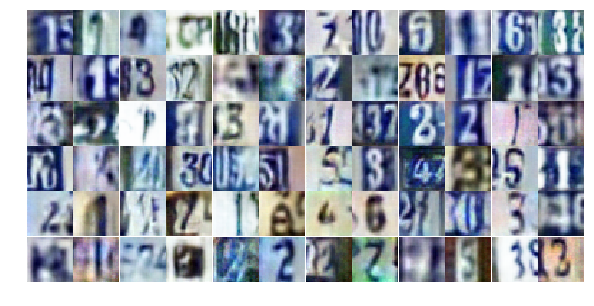

Epoch 25/25... Discriminator Loss: 0.8606... Generator Loss: 0.7896
Epoch 25/25... Discriminator Loss: 0.3393... Generator Loss: 2.6897
Epoch 25/25... Discriminator Loss: 1.1238... Generator Loss: 0.5584
Epoch 25/25... Discriminator Loss: 1.3161... Generator Loss: 0.5857
Epoch 25/25... Discriminator Loss: 0.6542... Generator Loss: 1.0823
Epoch 25/25... Discriminator Loss: 0.7631... Generator Loss: 0.9341
Epoch 25/25... Discriminator Loss: 0.8051... Generator Loss: 0.8894
Epoch 25/25... Discriminator Loss: 0.6767... Generator Loss: 1.3495
Epoch 25/25... Discriminator Loss: 0.5345... Generator Loss: 1.6170
Epoch 25/25... Discriminator Loss: 1.5674... Generator Loss: 0.3937


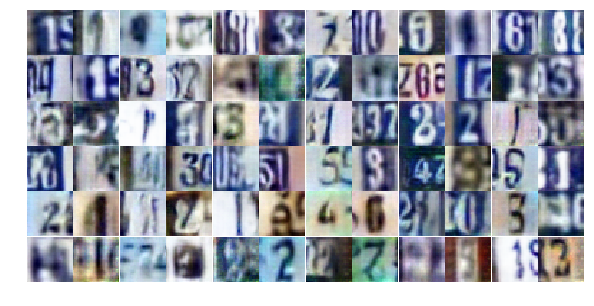

Epoch 25/25... Discriminator Loss: 0.7469... Generator Loss: 1.1977
Epoch 25/25... Discriminator Loss: 0.7753... Generator Loss: 0.9445
Epoch 25/25... Discriminator Loss: 0.9884... Generator Loss: 0.8637
Epoch 25/25... Discriminator Loss: 1.0465... Generator Loss: 0.7555
Epoch 25/25... Discriminator Loss: 0.6557... Generator Loss: 1.3264
Epoch 25/25... Discriminator Loss: 0.4424... Generator Loss: 1.8728
Epoch 25/25... Discriminator Loss: 0.6528... Generator Loss: 1.8126
Epoch 25/25... Discriminator Loss: 0.6717... Generator Loss: 1.1333
Epoch 25/25... Discriminator Loss: 0.7587... Generator Loss: 1.2167
Epoch 25/25... Discriminator Loss: 0.4671... Generator Loss: 1.5160


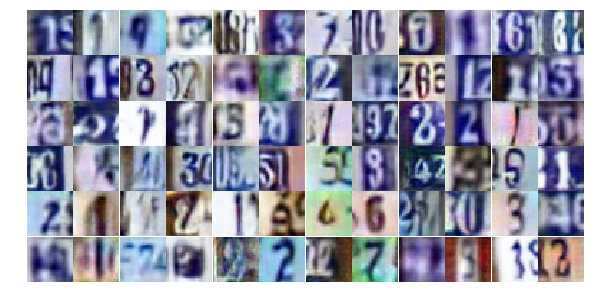

Epoch 25/25... Discriminator Loss: 0.7116... Generator Loss: 0.9735
Epoch 25/25... Discriminator Loss: 0.6249... Generator Loss: 1.1433
Epoch 25/25... Discriminator Loss: 0.8642... Generator Loss: 0.8783
Epoch 25/25... Discriminator Loss: 0.5278... Generator Loss: 1.3208
Epoch 25/25... Discriminator Loss: 0.7639... Generator Loss: 0.9057
Epoch 25/25... Discriminator Loss: 0.9202... Generator Loss: 0.8041
Epoch 25/25... Discriminator Loss: 0.5194... Generator Loss: 1.4793
Epoch 25/25... Discriminator Loss: 0.4420... Generator Loss: 1.6562
Epoch 25/25... Discriminator Loss: 2.5991... Generator Loss: 0.1716
Epoch 25/25... Discriminator Loss: 6.0585... Generator Loss: 0.0196


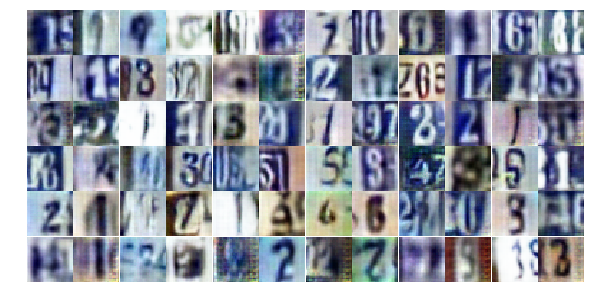

Epoch 25/25... Discriminator Loss: 1.5945... Generator Loss: 0.7217
Epoch 25/25... Discriminator Loss: 0.7644... Generator Loss: 1.8235
Epoch 25/25... Discriminator Loss: 0.9866... Generator Loss: 2.2282
Epoch 25/25... Discriminator Loss: 0.7081... Generator Loss: 1.1260
Epoch 25/25... Discriminator Loss: 0.8485... Generator Loss: 0.8696
Epoch 25/25... Discriminator Loss: 0.5825... Generator Loss: 1.2463
Epoch 25/25... Discriminator Loss: 0.8721... Generator Loss: 1.0081
Epoch 25/25... Discriminator Loss: 0.5678... Generator Loss: 1.4190
Epoch 25/25... Discriminator Loss: 0.8396... Generator Loss: 0.8526
Epoch 25/25... Discriminator Loss: 1.1756... Generator Loss: 0.5766


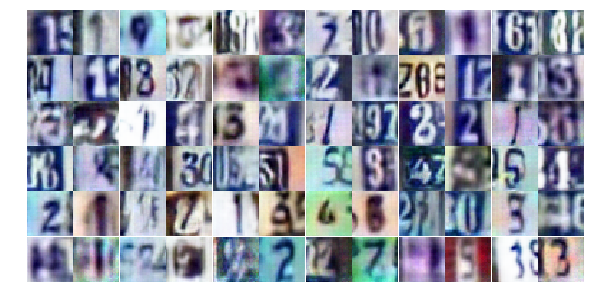

Epoch 25/25... Discriminator Loss: 0.4389... Generator Loss: 2.0670
Epoch 25/25... Discriminator Loss: 1.4101... Generator Loss: 0.3996


In [48]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

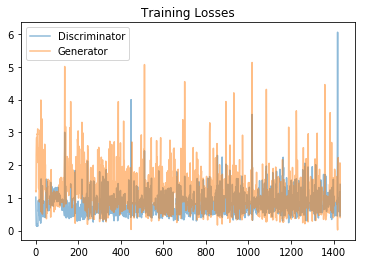

In [49]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

/Users/petinatan/anaconda3/envs/tensorflow/lib/python3.5/site-packages/matplotlib/axes/_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


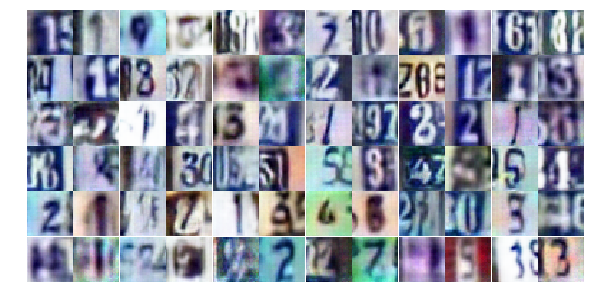

In [50]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))